**Load Data**

In [1]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

# Linha corrigida
df = pd.read_csv('dataset/44.csv', sep=';')
#df = pd.read_csv('/content/drive/MyDrive/Colab Notebooks/44.csv')
#first description of the data
df.head()

,time_stamp,asset_id,id,train_test,status_type_id,sensor_0_avg,sensor_0_max,sensor_0_min,sensor_0_std,sensor_1_avg,...,wind_speed_236_min,wind_speed_236_std,wind_speed_235_avg,wind_speed_235_max,wind_speed_235_min,wind_speed_235_std,wind_speed_237_avg,wind_speed_237_max,wind_speed_237_min,wind_speed_237_std
0,2022-08-02 14:00:00,44,0,train,0,22.026,27.6,15.3,2.381,0.0044,...,3.85,0.7347,6.607,9.9,3.1,0.8705,6.813,10.1,2.7,0.9747
1,2022-08-02 14:10:00,44,1,train,0,21.170,25.7,15.3,1.947,-0.0125,...,3.70,0.7355,6.416,9.3,2.2,0.8920,6.618,9.6,2.8,0.9180
2,2022-08-02 14:20:00,44,2,train,0,18.990,25.3,13.0,2.928,0.0117,...,3.70,0.8943,6.174,10.7,2.4,0.9950,6.600,10.3,2.8,1.0780
3,2022-08-02 14:30:00,44,3,train,0,18.048,24.7,13.0,1.875,-0.0098,...,3.70,0.6885,5.925,8.2,2.4,0.7651,6.227,8.9,2.1,0.9643
4,2022-08-02 14:40:00,44,4,train,0,19.077,25.0,13.6,2.287,0.0056,...,2.80,0.7453,6.443,9.8,2.4,0.8538,6.608,9.6,1.0,0.9440


In [2]:
# Get the column names
column_names = df.columns.tolist()

# Print the column names
#column_names

# Split the Data in Months and Year

In [3]:
# Converter coluna de data para datetime
df['Date'] = pd.to_datetime(df['time_stamp'], format="%Y-%m-%d %H:%M:%S")

# Criar coluna de meses contínuos
start_date = df['Date'].min()
df['Month'] = (df['Date'].dt.year - start_date.year) * 12 + df['Date'].dt.month - start_date.month + 1

# Extrair também o ano, se quiser manter
df['Year'] = df['Date'].dt.year 

# Renomear a coluna de média de potência
df.rename(columns={'power_5_avg': 'LV ActivePower (kW)'}, inplace=True)

# Selecionar apenas colunas relevantes
new_data = df[['Month', 'Year', 'Date', 'LV ActivePower (kW)', 'wind_speed_235_avg']]

# Calcular a capacidade máxima
cap = new_data['LV ActivePower (kW)'].max()

# Visualizar dados
new_data


#cap

,Month,Year,Date,LV ActivePower (kW),wind_speed_235_avg
0,1,2022,2022-08-02 14:00:00,0.25032,6.607
1,1,2022,2022-08-02 14:10:00,0.24058,6.416
2,1,2022,2022-08-02 14:20:00,0.21610,6.174
3,1,2022,2022-08-02 14:30:00,0.20514,5.925
4,1,2022,2022-08-02 14:40:00,0.21706,6.443
...,...,...,...,...,...
62998,15,2023,2023-10-14 01:40:00,0.48766,7.669
62999,15,2023,2023-10-14 01:50:00,0.42062,7.277
63000,15,2023,2023-10-14 02:00:00,0.49204,7.746
63001,15,2023,2023-10-14 02:10:00,0.49202,7.678


# Null Values

In [4]:
new_data.describe()

,Month,Year,Date,LV ActivePower (kW),wind_speed_235_avg
count,63003.000000,63003.000000,63003,63003.000000,63003.000000
mean,7.745869,2022.653921,2023-03-09 08:10:00,0.359844,7.509023
min,1.000000,2022.000000,2022-08-02 14:00:00,-0.015779,0.000000
25%,4.000000,2022.000000,2022-11-19 23:05:00,0.051448,4.808500
50%,8.000000,2023.000000,2023-03-09 08:10:00,0.248880,6.657000
75%,11.000000,2023.000000,2023-06-26 17:15:00,0.634600,9.655500
max,15.000000,2023.000000,2023-10-14 02:20:00,1.029600,28.878000
std,4.166814,0.475722,NaN,0.341922,3.983525


In [5]:
new_data.isnull().sum()

Month                  0
Year                   0
Date                   0
LV ActivePower (kW)    0
wind_speed_235_avg     0
dtype: int64

# Visualization

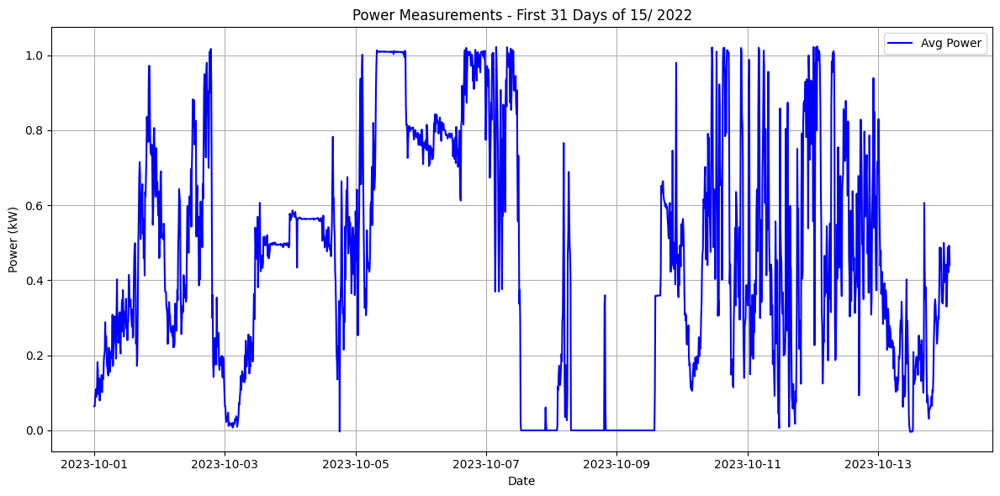

In [6]:
import matplotlib.pyplot as plt

# Parâmetros
month = 15
year = 2022
num_days = 31 # Altere aqui a quantidade de dias desejada

# Filtro base: mês e ano
filtered_data = new_data[(new_data['Month'] == month)]

# Pega os primeiros N dias únicos
first_n_days = filtered_data['Date'].dt.date.unique()[:num_days]

# Filtra apenas os dados desses dias
plot_data = filtered_data[filtered_data['Date'].dt.date.isin(first_n_days)]

# Plotando
plt.figure(figsize=(12, 6))

#plt.plot(plot_data['Date'], plot_data['power_5_min'], label='Min Power', color='red', linestyle='--')
plt.plot(plot_data['Date'], plot_data['LV ActivePower (kW)'], label='Avg Power', color='blue')
#plt.plot(plot_data['Date'], plot_data['power_5_max'], label='Max Power', color='green', linestyle='--')

# Personalização
plt.title(f'Power Measurements - First {num_days} Days of {month}/ {year}')
plt.xlabel('Date')
plt.ylabel('Power (kW)')
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()

**Parameter Settings**

In [7]:
i=[1,2,3,4,5,6] #enter month value, i.e January = 1
look_back=6
data_partition=0.8

In [8]:
'''!pip install EMD-signal
!pip install tensorflow_docs
!pip install ewtpy
!pip install optuna'''

'!pip install EMD-signal\n!pip install tensorflow_docs\n!pip install ewtpy\n!pip install optuna'

In [9]:
from myfunctions import svr_model, svr_model_optuna,ann_model_optuna,ann_quantile_model_with_rri, rf_model,rf_model_optuna,lstm_model,bilstm_model,bilstm_att_model,cnn_bilstm_att_model, emd_lstm,eemd_lstm,ceemdan_lstm,proposed_method,cnn_bilstm_model,cnn_bilstm_model_with_optuna,cnn_bilstm_att_model_with_optuna

2025-10-28 18:19:47.872977: I tensorflow/core/util/port.cc:153] oneDNN custom operations are on. You may see slightly different numerical results due to floating-point round-off errors from different computation orders. To turn them off, set the environment variable `TF_ENABLE_ONEDNN_OPTS=0`.
2025-10-28 18:19:47.889192: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:467] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
E0000 00:00:1761675587.906789  201056 cuda_dnn.cc:8579] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
E0000 00:00:1761675587.912390  201056 cuda_blas.cc:1407] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
W0000 00:00:1761675587.925652  201056 computation_placer.cc:177] computation placer already registered. Please check linkage and avoid linking 

In [10]:
from myfunctions import proposed_method_bilstm,proposed_method_bilstm_att,proposed_method_cnn_bilstm,proposed_method_cnn_bilstm_att, transformer_model,tft_model,lstm_model_with_optuna,bilstm_att_model_with_optuna,bilstm_model_with_optuna 

In [11]:
from myfunctions import proposed_method_bilstm_att_optuna,proposed_method_tft_aggregator_with_optuna,transformer_model_with_optuna,proposed_method_bilstm_optuna,tft_model_with_optuna,proposed_method_tft_aggregator, proposed_method_lstm_optuna,proposed_method_cnn_bilstm_att_optuna

In [12]:
CUDA_VISIBLE_DEVICES=""

--- EXECUTANDO SVR EM MODO DE TREINAMENTO (ANÁLISE DETERMINÍSTICA) ---
Treinando modelo SVR (previsão de ponto)...
Atribuindo previsão de ponto para todos os quantis (0.1, 0.5, 0.9)...
Modelo SVR e scalers salvos com sucesso.

===== Métricas Completas SVR (Previsão de Ponto) =====
Horizonte t+10: MAPE=4.3495%, RMSE=0.0819, MAE=0.0448, R²=0.9337
Horizonte t+20: MAPE=6.0404%, RMSE=0.1122, MAE=0.0622, R²=0.8754
Horizonte t+30: MAPE=7.0063%, RMSE=0.1258, MAE=0.0721, R²=0.8434


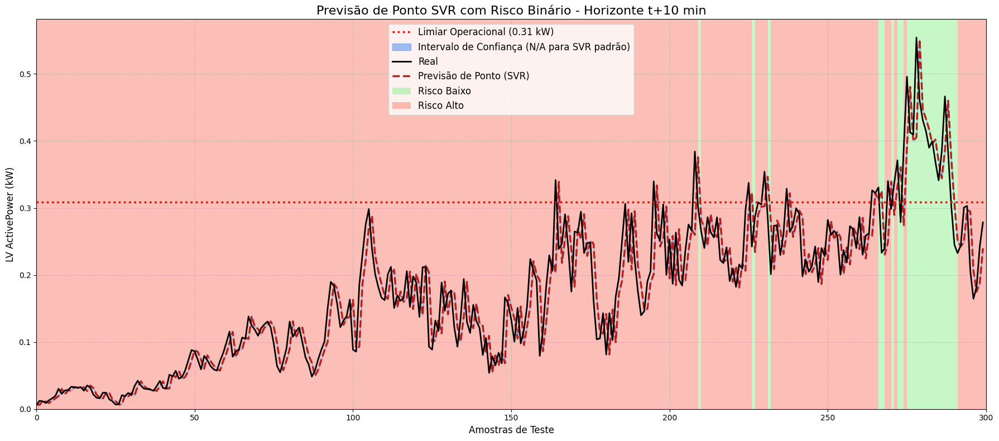

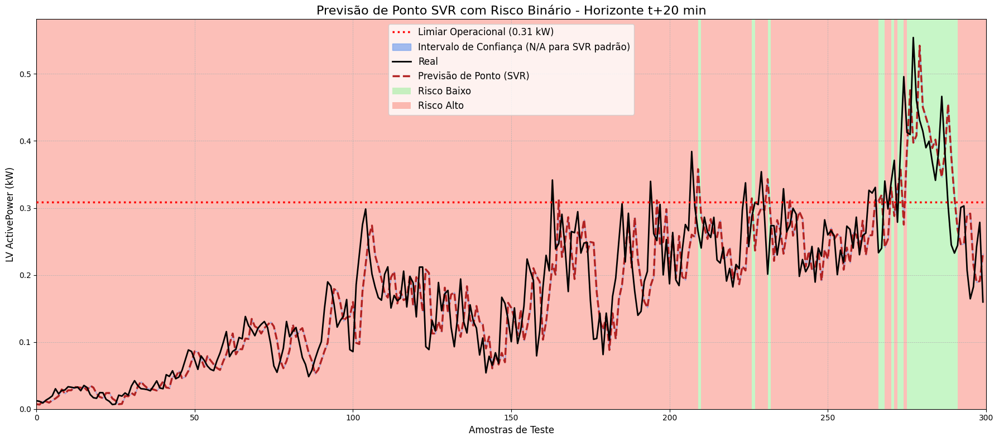

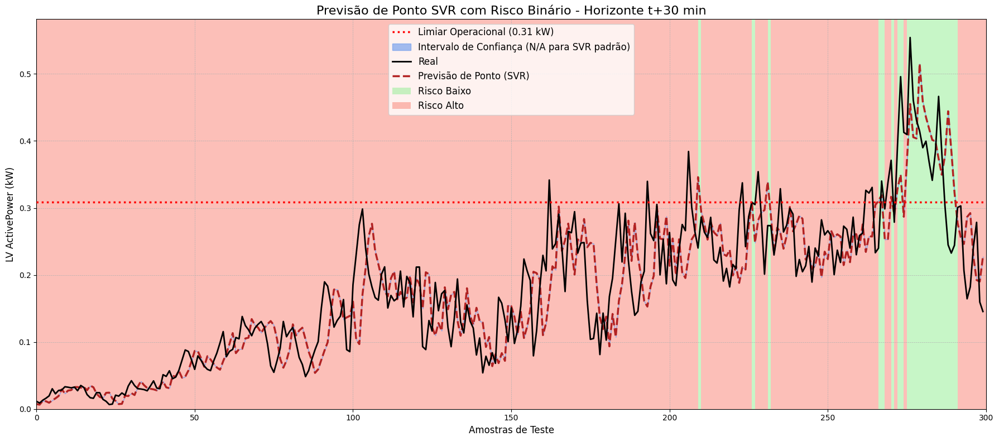

({0.1: array([[0.00680898, 0.00724712, 0.00744249],
         [0.00625497, 0.00660141, 0.00650395],
         [0.01229831, 0.01197281, 0.01211748],
         ...,
         [0.80693742, 0.80662005, 0.80669545],
         [0.80671437, 0.80644784, 0.80652753],
         [0.80640381, 0.80614975, 0.80622612]]),
  0.5: array([[0.00680898, 0.00724712, 0.00744249],
         [0.00625497, 0.00660141, 0.00650395],
         [0.01229831, 0.01197281, 0.01211748],
         ...,
         [0.80693742, 0.80662005, 0.80669545],
         [0.80671437, 0.80644784, 0.80652753],
         [0.80640381, 0.80614975, 0.80622612]]),
  0.9: array([[0.00680898, 0.00724712, 0.00744249],
         [0.00625497, 0.00660141, 0.00650395],
         [0.01229831, 0.01197281, 0.01211748],
         ...,
         [0.80693742, 0.80662005, 0.80669545],
         [0.80671437, 0.80644784, 0.80652753],
         [0.80640381, 0.80614975, 0.80622612]])},
 array([[0.0060356, 0.0123626, 0.0114462],
        [0.0123626, 0.0114462, 0.0089552],
    

In [14]:
svr_model(new_data,i,look_back,data_partition,cap)

[I 2025-09-09 23:36:23,322] A new study created in memory with name: no-name-9cddea96-132d-4b9b-bb94-0db948e0a183


  0%|          | 0/30 [00:00<?, ?it/s]

[I 2025-09-09 23:36:23,602] Trial 3 finished with value: 17.812733771842346 and parameters: {'C': 0.5366888664330852, 'epsilon': 0.40377211961927484, 'gamma': 'auto'}. Best is trial 3 with value: 17.812733771842346.
[I 2025-09-09 23:36:23,712] Trial 5 finished with value: 16.104433765315928 and parameters: {'C': 0.6752228186323326, 'epsilon': 0.2486362305677046, 'gamma': 'auto'}. Best is trial 5 with value: 16.104433765315928.
[I 2025-09-09 23:36:23,731] Trial 0 finished with value: 16.015393598325204 and parameters: {'C': 0.20782574639171666, 'epsilon': 0.2095725389329079, 'gamma': 'auto'}. Best is trial 0 with value: 16.015393598325204.
[I 2025-09-09 23:36:23,878] Trial 4 finished with value: 17.13884175075309 and parameters: {'C': 26.828003120645278, 'epsilon': 0.3597585136629575, 'gamma': 'scale'}. Best is trial 0 with value: 16.015393598325204.
[I 2025-09-09 23:36:24,274] Trial 1 finished with value: 15.06755746324417 and parameters: {'C': 29.750457261826213, 'epsilon': 0.16776576

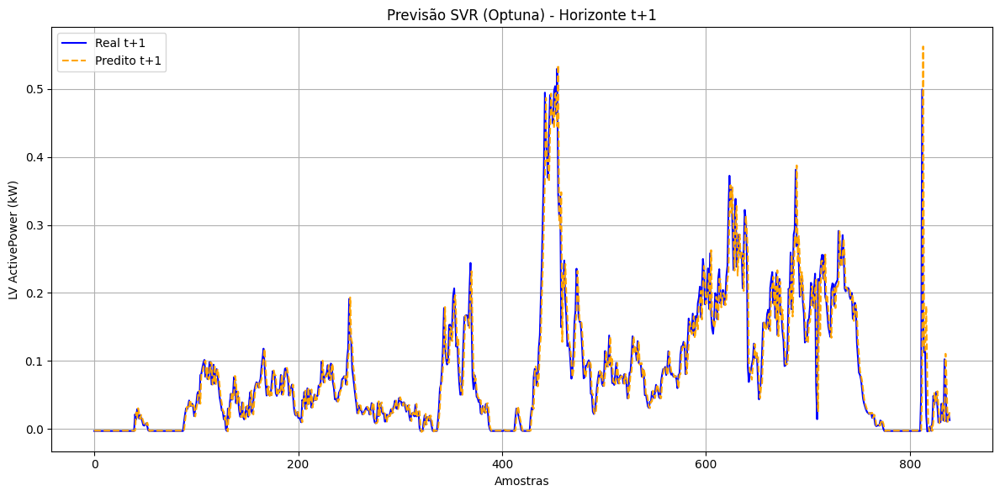

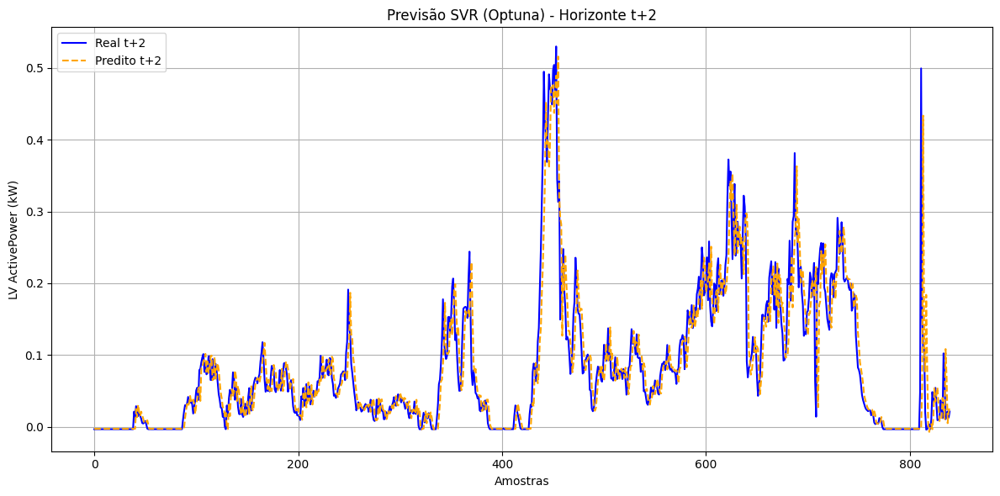

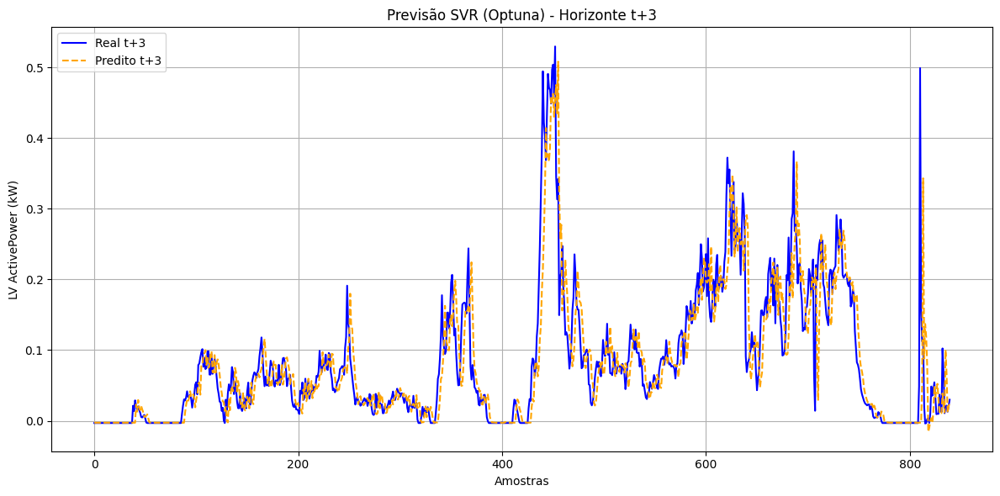

(MultiOutputRegressor(estimator=SVR(C=11.278020813490954,
                                    epsilon=0.0011558586656778785,
                                    gamma='auto')),
 {'C': 11.278020813490954, 'epsilon': 0.0011558586656778785, 'gamma': 'auto'},
 ([1.6565072660094307, 2.29317848980401, 2.6844080350262],
  [0.03525080164147403, 0.042972026590092506, 0.04803832299004387],
  [0.017055398810833098, 0.023610565731022087, 0.027638665128629756],
  2.211364596946547,
  0.04208705040720347,
  0.022768209890161647))

In [13]:
svr_model_optuna(new_data,i,look_back,data_partition,cap)

27/27 [==============================] - 0s 1ms/step

===== Métricas por horizonte =====
t+1 -> MAPE: 2.2984 | RMSE: 0.0414 | MAE: 0.0237
t+2 -> MAPE: 3.9388 | RMSE: 0.0557 | MAE: 0.0406
t+3 -> MAPE: 5.3318 | RMSE: 0.0674 | MAE: 0.0549

===== Médias =====
MAPE médio: 3.8563 | RMSE médio: 0.0548 | MAE médio: 0.0397


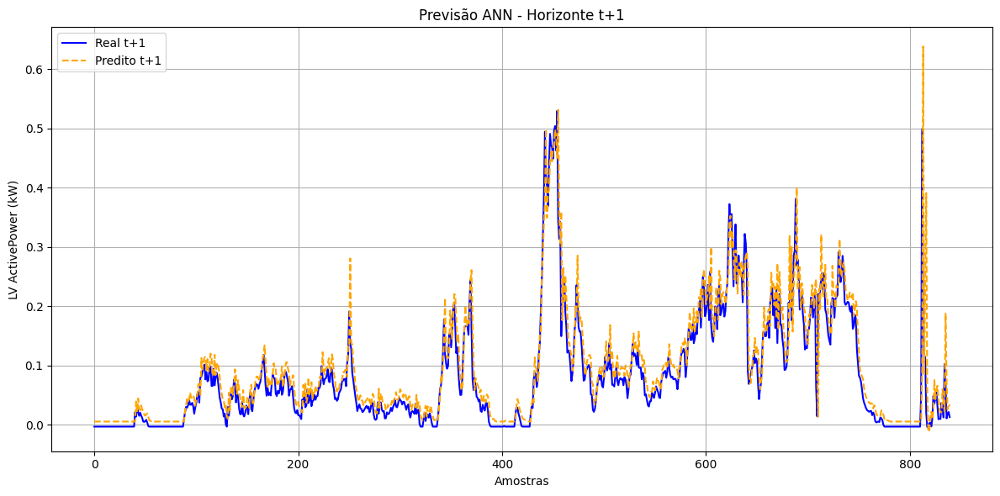

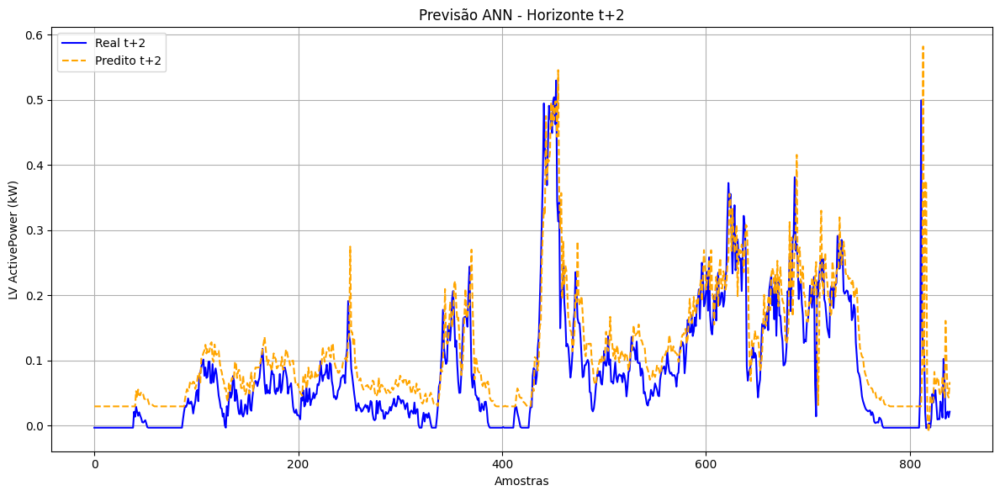

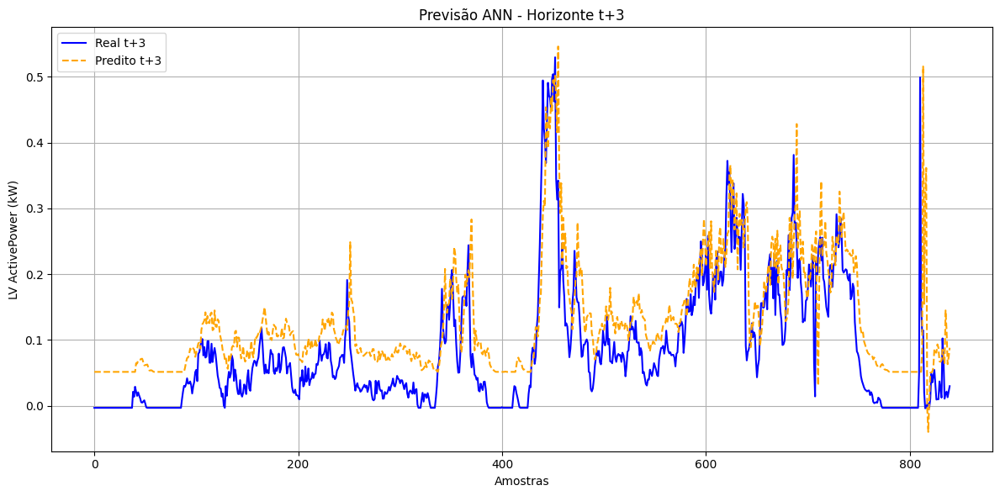

(<keras.src.engine.sequential.Sequential at 0x7ec207c6bf70>,
 ([2.2983652441540117, 3.938808831201235, 5.331843133938517],
  [0.041396734093922145, 0.05574275862242503, 0.0674004396749913],
  [0.023663968553809703, 0.04055397572604792, 0.054896656907030966],
  3.8563390697645885,
  0.054846644130446154,
  0.039704867062296194))

In [14]:
ann_model(new_data,i,look_back,data_partition,cap)

--- EXECUTANDO ANN EM MODO DE TREINAMENTO ---
Treinando modelo para o quantil: 0.1


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/core/dense.py:92: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)
I0000 00:00:1761676064.464325  201056 gpu_device.cc:2019] Created device /job:localhost/replica:0/task:0/device:GPU:0 with 13949 MB memory:  -> device: 0, name: Tesla T4, pci bus id: 0000:00:1e.0, compute capability: 7.5
I0000 00:00:1761676066.658387  228548 service.cc:152] XLA service 0x7f80bc0063b0 initialized for platform CUDA (this does not guarantee that XLA will be used). Devices:
I0000 00:00:1761676066.658415  228548 service.cc:160]   StreamExecutor device (0): Tesla T4, Compute Capability 7.5
2025-10-28 18:27:46.683397: I tensorflow/compiler/mlir/tensorflow/utils/dump_mlir_util.cc:269] disabling MLIR crash reproducer, set env 

164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step
Modelo salvo em: saved_models/ann_quantile/model_q01.keras
Treinando modelo para o quantil: 0.5


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/core/dense.py:92: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
Modelo salvo em: saved_models/ann_quantile/model_q05.keras
Treinando modelo para o quantil: 0.9


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/core/dense.py:92: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
Modelo salvo em: saved_models/ann_quantile/model_q09.keras
Scalers salvos com sucesso.
Aplicando correção de cruzamento de quantis...

===== Métricas Completas (baseadas na previsão da mediana q=0.5) =====
Horizonte t+10: MAPE=4.4157%, RMSE=0.0822, MAE=0.0455, R²=0.9332
Horizonte t+20: MAPE=6.1344%, RMSE=0.1137, MAE=0.0632, R²=0.8721
Horizonte t+30: MAPE=7.0986%, RMSE=0.1276, MAE=0.0731, R²=0.8389


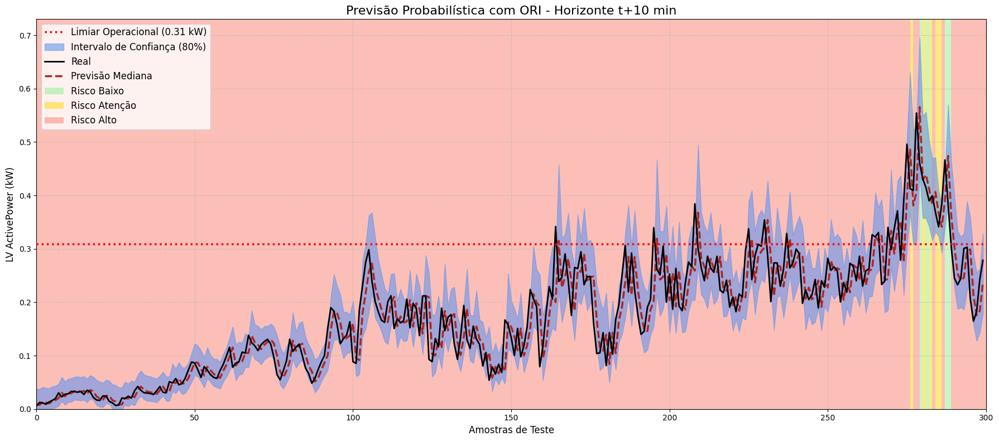

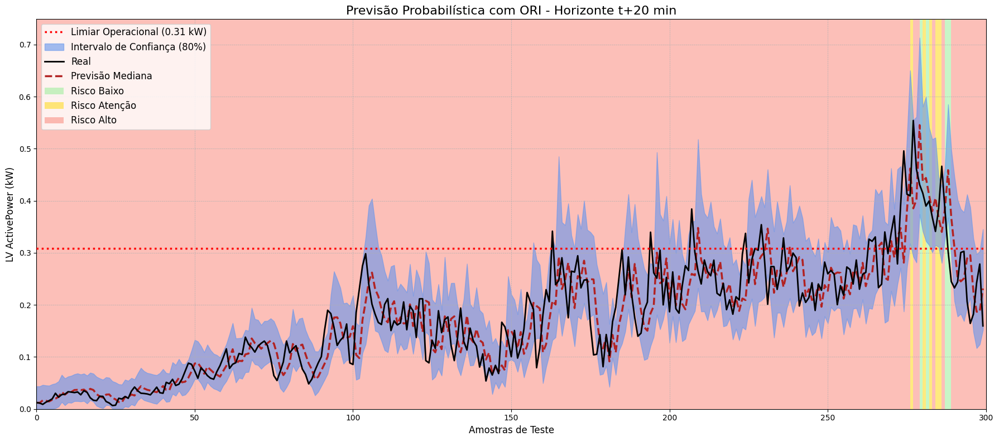

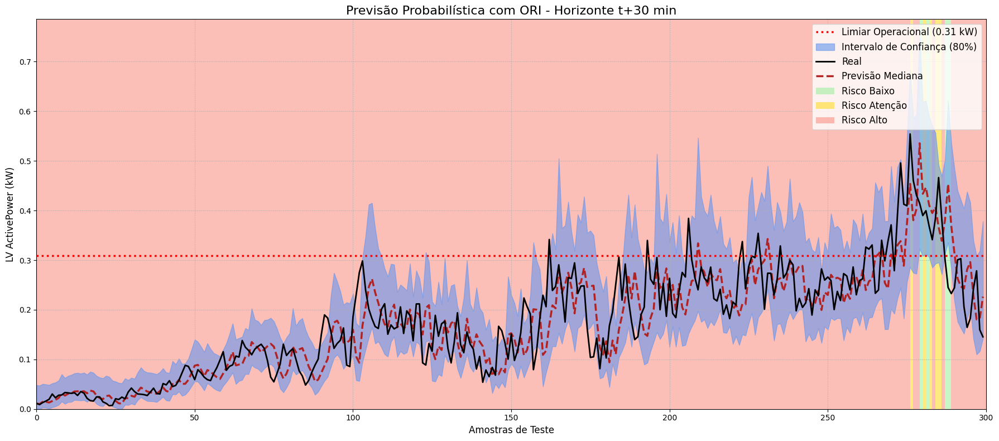

({0.1: array([[0.0000000e+00, 0.0000000e+00, 0.0000000e+00],
         [0.0000000e+00, 0.0000000e+00, 0.0000000e+00],
         [2.3516922e-04, 0.0000000e+00, 2.7915249e-03],
         ...,
         [7.7758551e-01, 7.4300569e-01, 7.2968388e-01],
         [7.7727431e-01, 7.4269700e-01, 7.2948498e-01],
         [7.7693915e-01, 7.4237990e-01, 7.2917891e-01]], dtype=float32),
  0.5: array([[0.00799149, 0.0122145 , 0.01100415],
         [0.00765943, 0.01185815, 0.01010519],
         [0.01325995, 0.01655658, 0.01472464],
         ...,
         [0.8108035 , 0.8104203 , 0.8103276 ],
         [0.8107157 , 0.8103521 , 0.8102704 ],
         [0.8105126 , 0.8101475 , 0.8100623 ]], dtype=float32),
  0.9: array([[0.03745082, 0.04357068, 0.0481174 ],
         [0.03736132, 0.04351978, 0.04732731],
         [0.04125211, 0.04630978, 0.05057585],
         ...,
         [0.861001  , 0.8724204 , 0.88531953],
         [0.8610034 , 0.8724507 , 0.8853498 ],
         [0.86098385, 0.8724481 , 0.8853281 ]], dtype=fl

In [15]:
ann_quantile_model_with_rri(new_data,i,look_back,data_partition,cap)

[I 2025-09-09 23:37:44,251] A new study created in memory with name: no-name-352b5326-f341-4363-8f3b-70f6f82b7fbf


  0%|          | 0/30 [00:00<?, ?it/s]

[I 2025-09-09 23:38:34,991] Trial 2 finished with value: 7.8079885592419265 and parameters: {'neurons': 64, 'dropout_rate': 0.22739485940254323, 'batch_size': 64}. Best is trial 2 with value: 7.8079885592419265.
[I 2025-09-09 23:38:38,478] Trial 6 finished with value: 8.122014399123524 and parameters: {'neurons': 64, 'dropout_rate': 0.41186123093426114, 'batch_size': 32}. Best is trial 2 with value: 7.8079885592419265.
[I 2025-09-09 23:38:41,527] Trial 4 finished with value: 10.629947089045018 and parameters: {'neurons': 32, 'dropout_rate': 0.457819236979137, 'batch_size': 32}. Best is trial 2 with value: 7.8079885592419265.
[I 2025-09-09 23:38:43,992] Trial 3 finished with value: 7.6510661871643135 and parameters: {'neurons': 128, 'dropout_rate': 0.06658322706678715, 'batch_size': 32}. Best is trial 3 with value: 7.6510661871643135.
[I 2025-09-09 23:38:46,784] Trial 5 finished with value: 8.632531013070937 and parameters: {'neurons': 32, 'dropout_rate': 0.16647745499052424, 'batch_siz

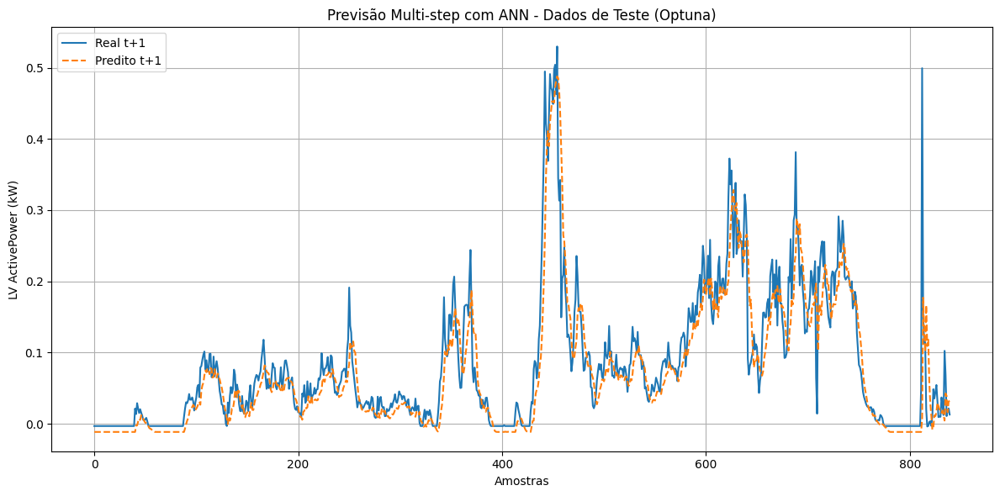

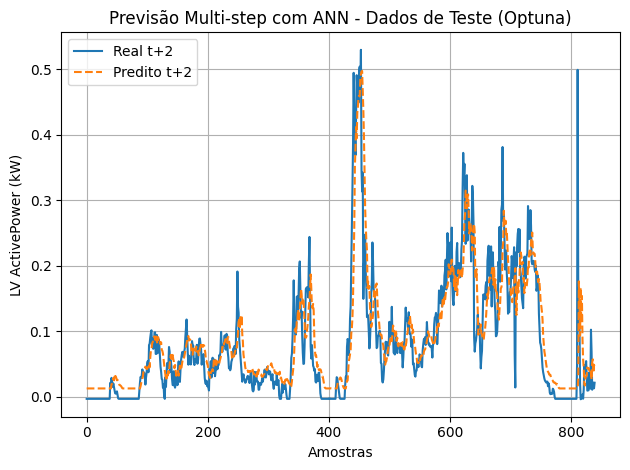

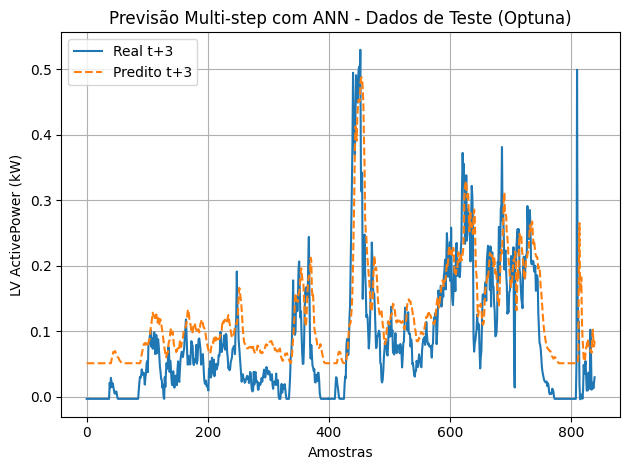

(<keras.src.engine.sequential.Sequential at 0x7ec14f9b2b00>,
 <optuna.study.study.Study at 0x7ec1845e4d60>)

In [15]:
ann_model_optuna(new_data,i,look_back,data_partition,cap)

--- EXECUTANDO RANDOM FOREST EM MODO DE TREINAMENTO ---
Treinando modelo Random Forest...
Modelo Random Forest e scalers salvos com sucesso.
Gerando previsões quantílicas a partir do ensemble Random Forest...
Aplicando correção de cruzamento de quantis...

===== Métricas Completas RF (baseadas na previsão da mediana q=0.5) =====
Horizonte t+10: MAPE=4.6907%, RMSE=0.0820, MAE=0.0483, R²=0.9335
Horizonte t+20: MAPE=6.3677%, RMSE=0.1112, MAE=0.0656, R²=0.8776
Horizonte t+30: MAPE=7.4162%, RMSE=0.1245, MAE=0.0764, R²=0.8466


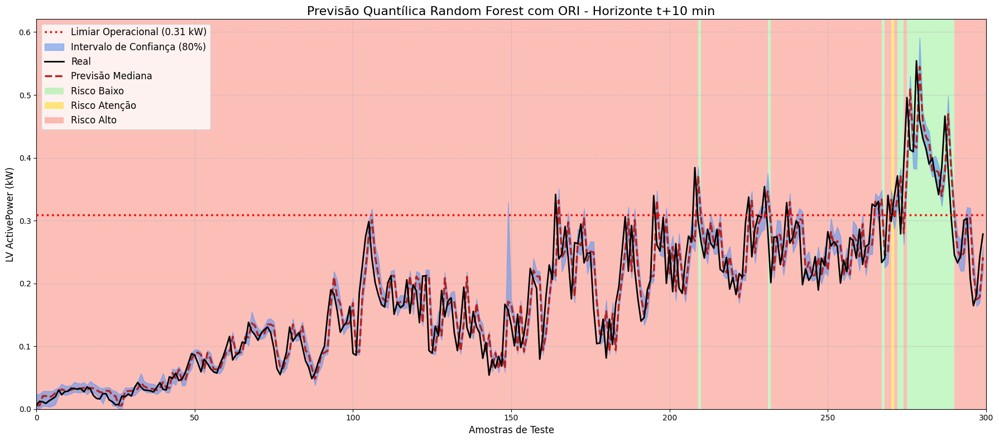

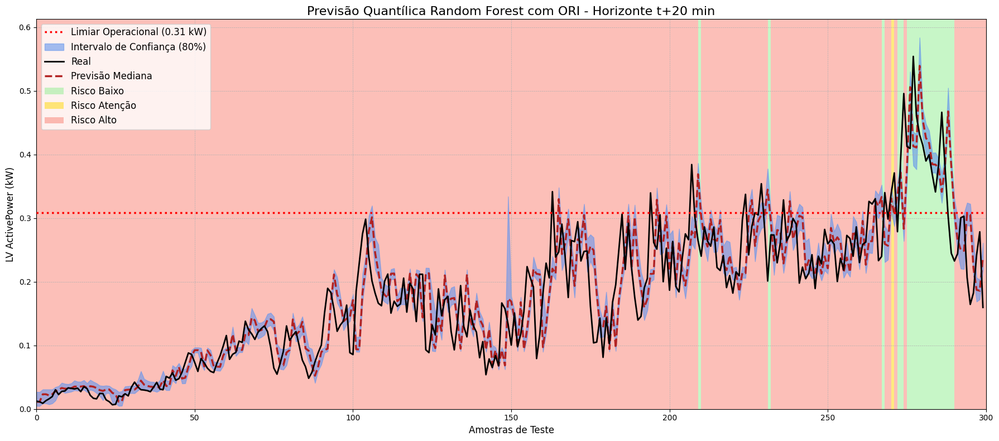

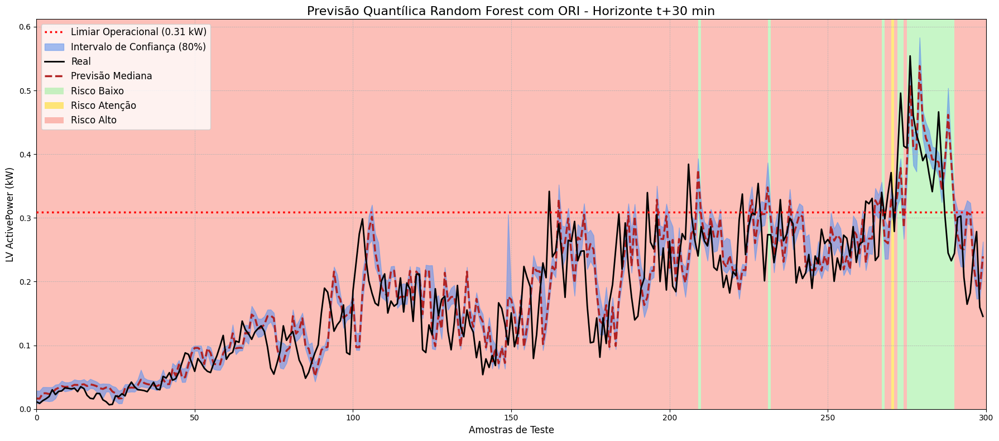

({0.1: array([[0.00105602, 0.00483474, 0.00865768],
         [0.00103037, 0.00478185, 0.00852954],
         [0.00463399, 0.00884762, 0.01283509],
         ...,
         [0.79418095, 0.78812802, 0.77915903],
         [0.79418095, 0.78812802, 0.77915903],
         [0.79418095, 0.78812802, 0.77915903]]),
  0.5: array([[0.0056984 , 0.01144643, 0.01657201],
         [0.00564895, 0.01128752, 0.01628664],
         [0.02076093, 0.02322389, 0.02476125],
         ...,
         [0.81584718, 0.80810636, 0.80897426],
         [0.81584718, 0.80810636, 0.80897426],
         [0.81590066, 0.80810674, 0.80899978]]),
  0.9: array([[0.02388761, 0.02682883, 0.02869003],
         [0.02367336, 0.02670819, 0.02854994],
         [0.02848518, 0.03076834, 0.03433615],
         ...,
         [0.83027702, 0.82442262, 0.82579983],
         [0.83027702, 0.82442262, 0.82579983],
         [0.83033971, 0.82450284, 0.82610394]])},
 array([[0.0060356, 0.0123626, 0.0114462],
        [0.0123626, 0.0114462, 0.0089552],
    

In [17]:
rf_model(new_data,i,look_back,data_partition,cap)

[I 2025-09-09 23:50:11,262] A new study created in memory with name: no-name-26038c31-d525-4c17-b639-c0cdadbe5530


  0%|          | 0/100 [00:00<?, ?it/s]

[I 2025-09-09 23:50:12,692] Trial 0 finished with value: 11.541498067602928 and parameters: {'n_estimators': 179, 'max_depth': 17, 'min_samples_split': 10, 'min_samples_leaf': 2}. Best is trial 0 with value: 11.541498067602928.
[I 2025-09-09 23:50:14,256] Trial 1 finished with value: 11.605399654607615 and parameters: {'n_estimators': 190, 'max_depth': 19, 'min_samples_split': 4, 'min_samples_leaf': 2}. Best is trial 0 with value: 11.541498067602928.
[I 2025-09-09 23:50:15,699] Trial 2 finished with value: 11.513292355665293 and parameters: {'n_estimators': 217, 'max_depth': 5, 'min_samples_split': 9, 'min_samples_leaf': 1}. Best is trial 2 with value: 11.513292355665293.
[I 2025-09-09 23:50:17,646] Trial 3 finished with value: 11.414129738631637 and parameters: {'n_estimators': 208, 'max_depth': 8, 'min_samples_split': 4, 'min_samples_leaf': 1}. Best is trial 3 with value: 11.414129738631637.
[I 2025-09-09 23:50:18,527] Trial 4 finished with value: 11.371485926747253 and parameters: {

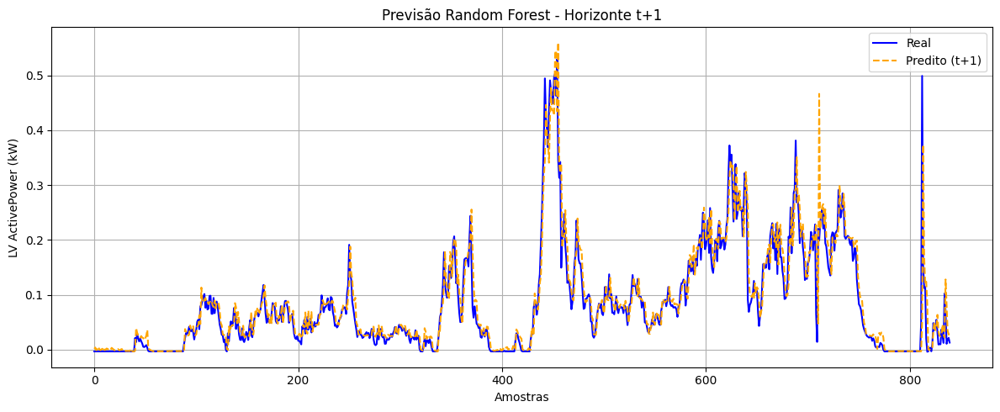


Horizonte t+2:
  MAPE: 2.6450
  RMSE: 0.0452
  MAE: 0.0272


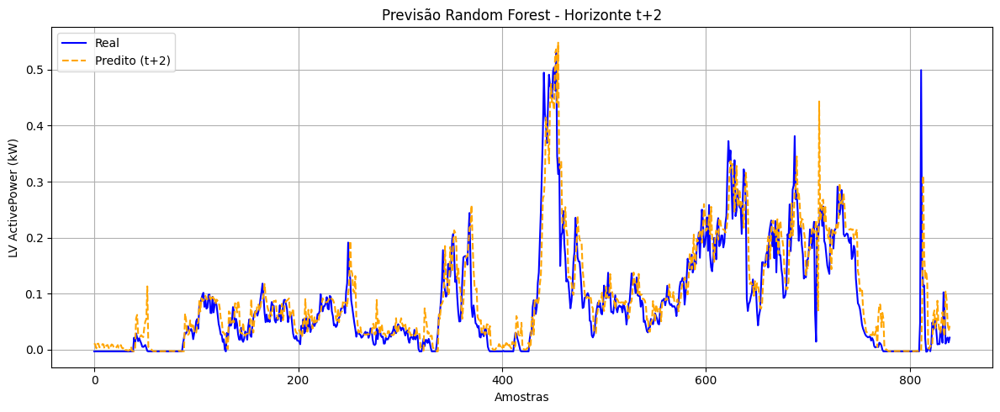


Horizonte t+3:
  MAPE: 3.2848
  RMSE: 0.0532
  MAE: 0.0338


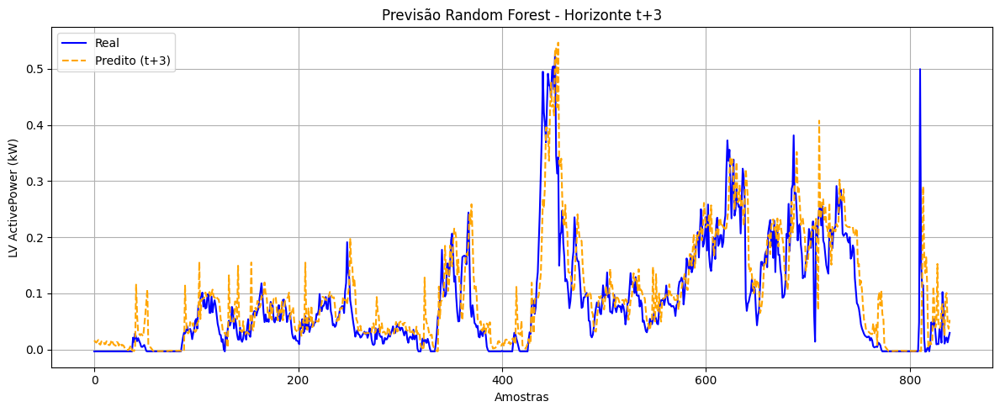

(RandomForestRegressor(max_depth=7, min_samples_leaf=4, min_samples_split=5,
                       n_estimators=213, n_jobs=-1, random_state=1234),
 array([[ 0.00143569,  0.01134993,  0.01635491],
        [ 0.00377942,  0.00861399,  0.01373914],
        [-0.00093264,  0.00236869,  0.01251157],
        ...,
        [ 0.03440719,  0.046736  ,  0.04611906],
        [ 0.02751228,  0.03329794,  0.03716007],
        [ 0.0300529 ,  0.04236319,  0.05283812]]),
 array([[-0.003196 , -0.0032   , -0.0031856],
        [-0.0032   , -0.0031856, -0.0032   ],
        [-0.0031856, -0.0032   , -0.0031938],
        ...,
        [ 0.018353 ,  0.02154  ,  0.012863 ],
        [ 0.02154  ,  0.012863 ,  0.021424 ],
        [ 0.012863 ,  0.021424 ,  0.0298   ]]))

In [17]:
rf_model_optuna(new_data,i,look_back,data_partition,cap)

--- EXECUTANDO LSTM EM MODO DE TREINAMENTO ---
Treinando modelo LSTM para o quantil: 0.1


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
Modelo LSTM salvo em: saved_models/lstm_model/model_q01.keras
Treinando modelo LSTM para o quantil: 0.5


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
Modelo LSTM salvo em: saved_models/lstm_model/model_q05.keras
Treinando modelo LSTM para o quantil: 0.9


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
Modelo LSTM salvo em: saved_models/lstm_model/model_q09.keras
Scalers para LSTM salvos com sucesso.
Aplicando correção de cruzamento de quantis...

===== Métricas Completas LSTM (baseadas na previsão da mediana q=0.5) =====
Horizonte t+10: MAPE=4.3708%, RMSE=0.0819, MAE=0.0450, R²=0.9337
Horizonte t+20: MAPE=6.0281%, RMSE=0.1132, MAE=0.0621, R²=0.8731
Horizonte t+30: MAPE=7.0488%, RMSE=0.1278, MAE=0.0726, R²=0.8384


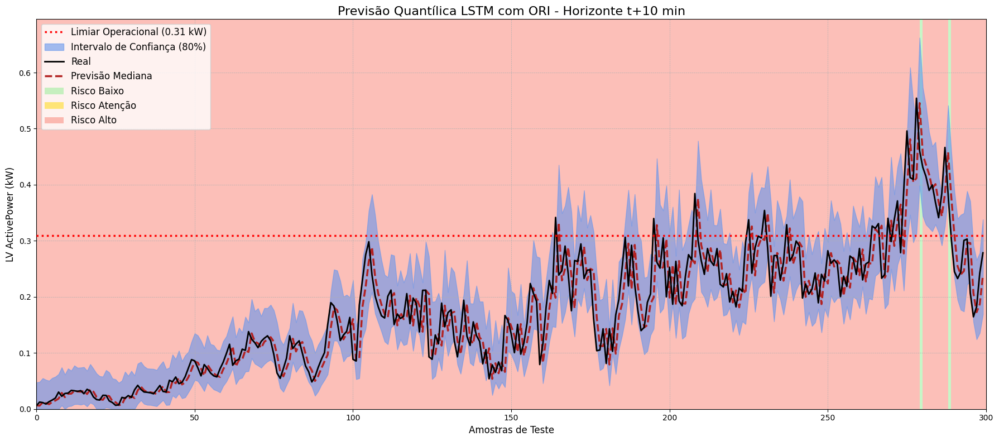

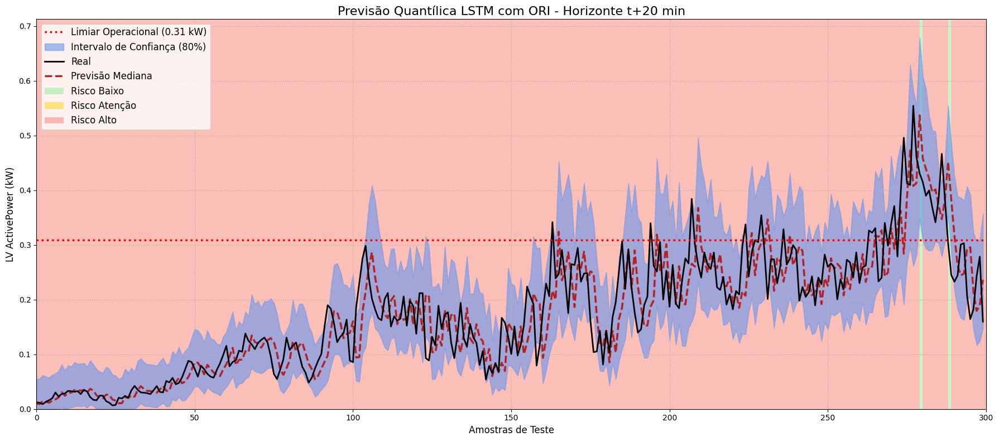

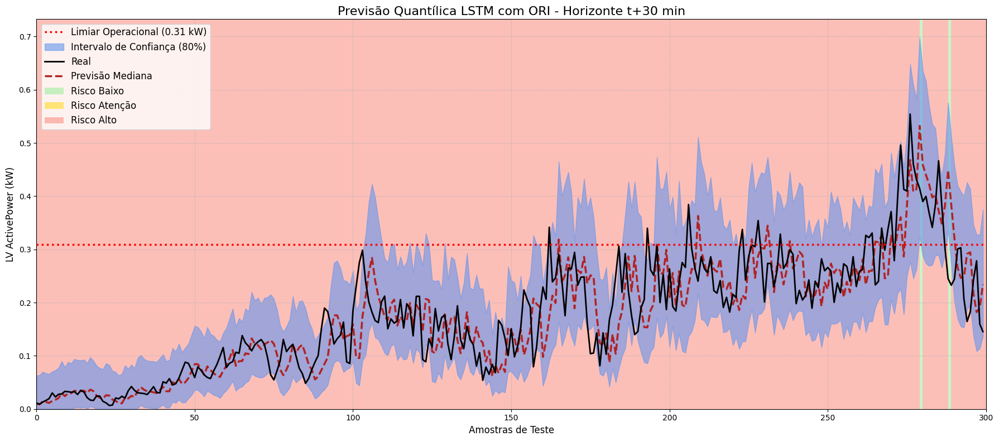

({0.1: array([[0.        , 0.        , 0.        ],
         [0.        , 0.        , 0.        ],
         [0.        , 0.        , 0.        ],
         ...,
         [0.76283467, 0.74217063, 0.7183048 ],
         [0.7625856 , 0.7419401 , 0.7180674 ],
         [0.7622718 , 0.74166375, 0.7177977 ]], dtype=float32),
  0.5: array([[0.00638202, 0.00953276, 0.00954986],
         [0.00598892, 0.00902982, 0.00898647],
         [0.01193041, 0.01439591, 0.01405236],
         ...,
         [0.8101947 , 0.80841386, 0.80860746],
         [0.8100127 , 0.80825263, 0.8084593 ],
         [0.8097085 , 0.80796146, 0.8081774 ]], dtype=float32),
  0.9: array([[0.04734233, 0.05452855, 0.06273761],
         [0.04833001, 0.05545883, 0.06377488],
         [0.05493486, 0.06184484, 0.06997418],
         ...,
         [0.8456832 , 0.8608063 , 0.87637883],
         [0.8455253 , 0.86067057, 0.8762563 ],
         [0.84538186, 0.86058986, 0.8761228 ]], dtype=float32)},
 array([[0.0060356, 0.0123626, 0.0114462],
  

In [18]:
lstm_model(new_data,i,look_back,data_partition,cap)

[I 2025-09-09 23:57:58,495] A new study created in memory with name: no-name-28019a46-ae39-4b71-9659-42916974dc62


  0%|          | 0/20 [00:00<?, ?it/s]

[I 2025-09-09 23:59:05,539] Trial 5 finished with value: 8.434892180390106 and parameters: {'neuron': 64, 'dropout': 0.27305862470857095, 'lr': 0.0047682174040079885, 'batch_size': 32}. Best is trial 5 with value: 8.434892180390106.
[I 2025-09-09 23:59:44,662] Trial 3 finished with value: 9.407823737525801 and parameters: {'neuron': 32, 'dropout': 0.3188490980736038, 'lr': 0.0014959450205418745, 'batch_size': 64}. Best is trial 5 with value: 8.434892180390106.
[I 2025-09-10 00:00:11,697] Trial 0 finished with value: 8.126642434486447 and parameters: {'neuron': 16, 'dropout': 0.010660504140974358, 'lr': 0.0020116696531591654, 'batch_size': 32}. Best is trial 0 with value: 8.126642434486447.
[I 2025-09-10 00:00:20,299] Trial 2 finished with value: 9.062369072243035 and parameters: {'neuron': 64, 'dropout': 0.4811847277034654, 'lr': 0.0008212284815011307, 'batch_size': 64}. Best is trial 0 with value: 8.126642434486447.
[I 2025-09-10 00:01:35,404] Trial 8 finished with value: 8.7816700042

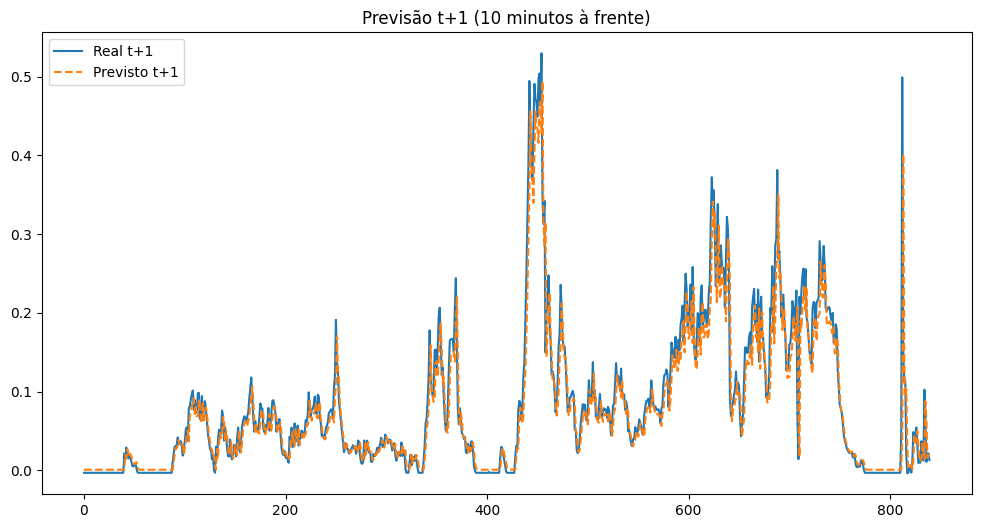

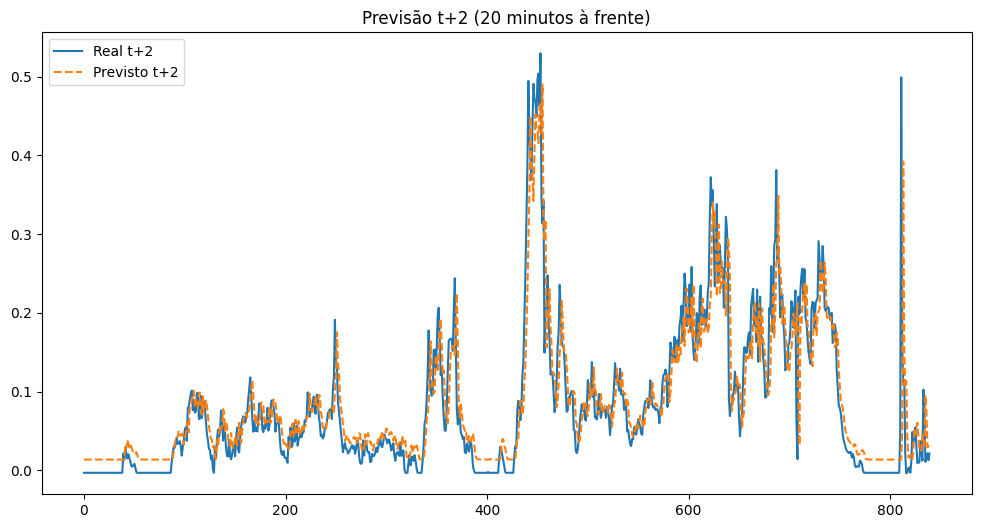

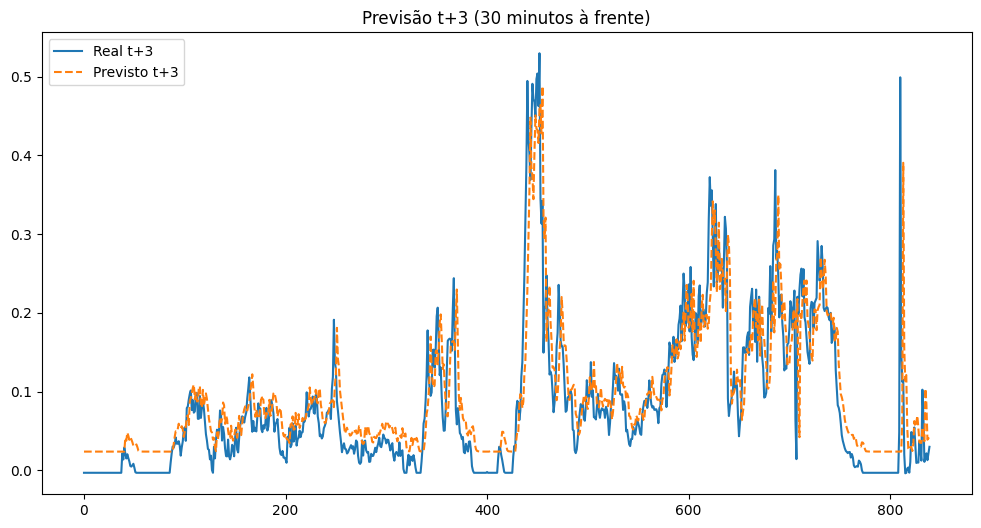

{'Metrics': {'Horizonte t+1': {'MAPE': 1.7726799204253931,
   'RMSE': 0.03374614561966996,
   'MAE': 0.018251512460699847},
  'Horizonte t+2': {'MAPE': 2.598264726310874,
   'RMSE': 0.04235036128726886,
   'MAE': 0.026751733622096763},
  'Horizonte t+3': {'MAPE': 3.321604585320243,
   'RMSE': 0.04936589630388368,
   'MAE': 0.03419924081045723}},
 'Best Params': {'neuron': 16,
  'dropout': 0.4175904091136385,
  'lr': 0.009483903843230288,
  'batch_size': 32}}

In [13]:
lstm_model_with_optuna(new_data,i,look_back,data_partition,cap)

--- EXECUTANDO BI-LSTM EM MODO DE TREINamento ---
Treinando modelo Bi-LSTM para o quantil: 0.1


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step
Modelo Bi-LSTM salvo em: saved_models/bilstm_model/model_q01.keras
Treinando modelo Bi-LSTM para o quantil: 0.5


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step
Modelo Bi-LSTM salvo em: saved_models/bilstm_model/model_q05.keras
Treinando modelo Bi-LSTM para o quantil: 0.9


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step
Modelo Bi-LSTM salvo em: saved_models/bilstm_model/model_q09.keras
Scalers para Bi-LSTM salvos com sucesso.
Aplicando correção de cruzamento de quantis...

===== Métricas Completas Bi-LSTM (baseadas na previsão da mediana q=0.5) =====
Horizonte t+10: MAPE=4.3486%, RMSE=0.0814, MAE=0.0448, R²=0.9344
Horizonte t+20: MAPE=6.0454%, RMSE=0.1126, MAE=0.0622, R²=0.8747
Horizonte t+30: MAPE=7.0931%, RMSE=0.1267, MAE=0.0730, R²=0.8410


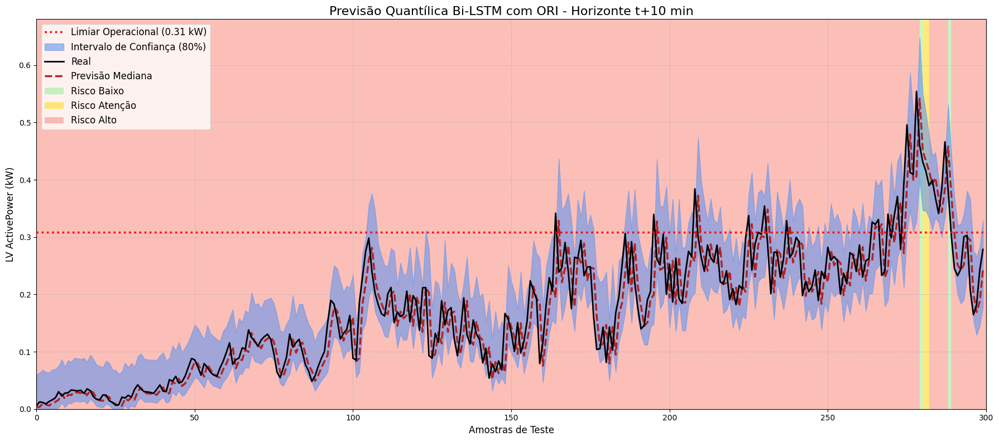

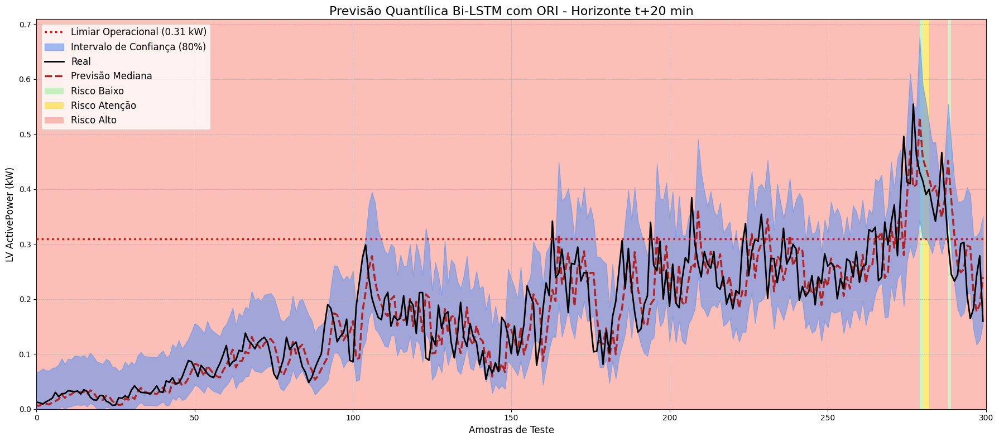

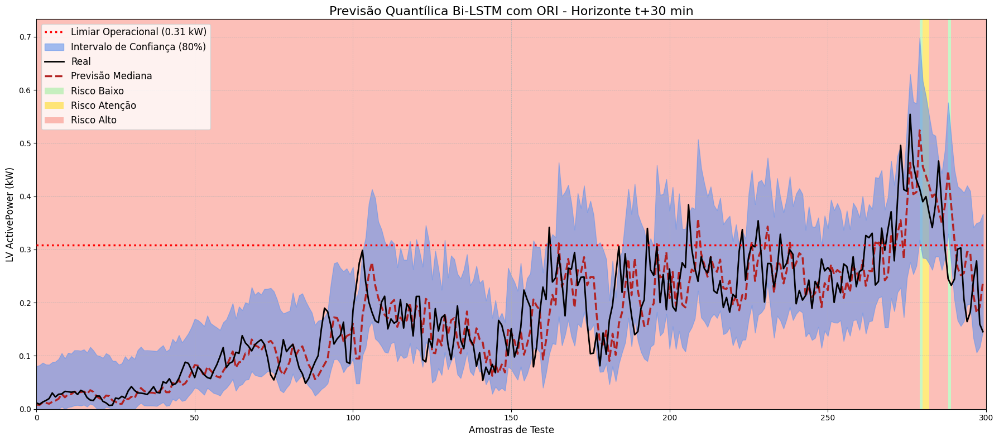

({0.1: array([[0.        , 0.        , 0.        ],
         [0.        , 0.        , 0.        ],
         [0.        , 0.        , 0.        ],
         ...,
         [0.7785262 , 0.7567963 , 0.7250389 ],
         [0.7782889 , 0.7566711 , 0.72494423],
         [0.7780652 , 0.7564846 , 0.72474533]], dtype=float32),
  0.5: array([[0.00387552, 0.00636615, 0.00823811],
         [0.00359037, 0.00592099, 0.00771555],
         [0.00952688, 0.01114903, 0.01263601],
         ...,
         [0.807031  , 0.8068497 , 0.8044546 ],
         [0.80685955, 0.8067107 , 0.8043306 ],
         [0.8065734 , 0.8064491 , 0.80408186]], dtype=float32),
  0.9: array([[0.06031525, 0.06668799, 0.08033064],
         [0.06294838, 0.06870414, 0.08241031],
         [0.06837437, 0.07355286, 0.0869863 ],
         ...,
         [0.8763353 , 0.89697844, 0.90950733],
         [0.8762447 , 0.8969144 , 0.90945035],
         [0.8761029 , 0.8968121 , 0.9093504 ]], dtype=float32)},
 array([[0.0060356, 0.0123626, 0.0114462],
  

In [19]:
bilstm_model(new_data,i,look_back,data_partition,cap)

[I 2025-09-10 00:15:28,499] A new study created in memory with name: no-name-341fd172-8d7e-4305-a4fa-587673bb0722


  0%|          | 0/20 [00:00<?, ?it/s]

[I 2025-09-10 00:17:43,606] Trial 5 finished with value: 7.910878495178689 and parameters: {'neuron': 64, 'dropout': 0.43982942824257787, 'lr': 0.0036660635030005455, 'batch_size': 16}. Best is trial 5 with value: 7.910878495178689.
[I 2025-09-10 00:18:04,193] Trial 1 finished with value: 9.155425735433148 and parameters: {'neuron': 128, 'dropout': 0.3031467210639883, 'lr': 0.001567590766579141, 'batch_size': 16}. Best is trial 5 with value: 7.910878495178689.
[I 2025-09-10 00:18:09,713] Trial 2 finished with value: 9.840293582300307 and parameters: {'neuron': 128, 'dropout': 0.4758628956831594, 'lr': 0.0004996025919899328, 'batch_size': 64}. Best is trial 5 with value: 7.910878495178689.
[I 2025-09-10 00:18:41,187] Trial 0 finished with value: 11.576743408159794 and parameters: {'neuron': 16, 'dropout': 0.029921616594957456, 'lr': 0.0006925553270158424, 'batch_size': 64}. Best is trial 5 with value: 7.910878495178689.
[I 2025-09-10 00:19:26,557] Trial 4 finished with value: 10.6514714

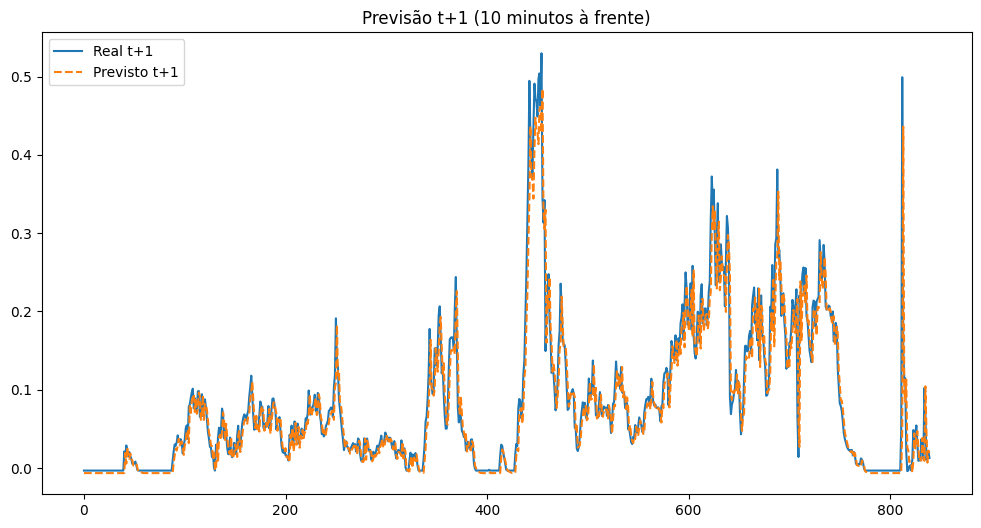

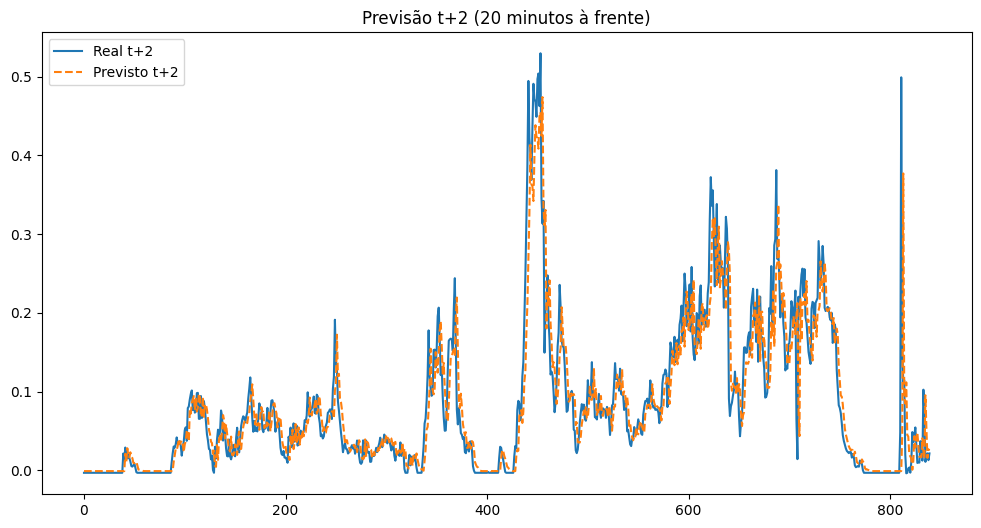

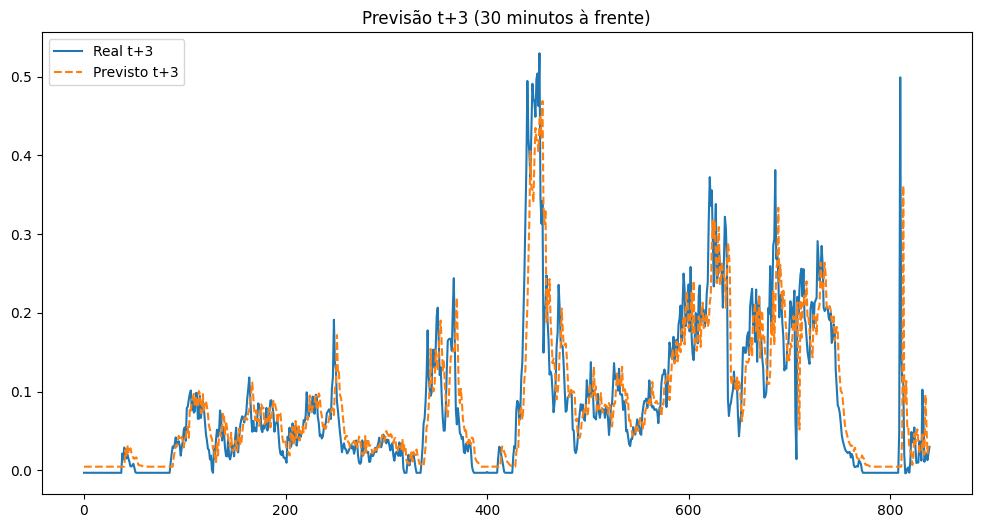

{'Metrics': {'Horizonte t+1': {'MAPE': 1.699411940915178,
   'RMSE': 0.03337586744257643,
   'MAE': 0.017497145343662673},
  'Horizonte t+2': {'MAPE': 2.3270379840476285,
   'RMSE': 0.04206389003192279,
   'MAE': 0.023959183083754387},
  'Horizonte t+3': {'MAPE': 2.8350340469071638,
   'RMSE': 0.04773934208560513,
   'MAE': 0.02918951054695616}},
 'Best Params': {'neuron': 64,
  'dropout': 0.3871074830960058,
  'lr': 0.008860294107199622,
  'batch_size': 32}}

In [13]:
bilstm_model_with_optuna(new_data,i,look_back,data_partition,cap)

27/27 [==============================] - 1s 2ms/step
Horizonte t+1: MAPE=2.4186, RMSE=0.0375, MAE=0.0249
Horizonte t+2: MAPE=3.3549, RMSE=0.0479, MAE=0.0345
Horizonte t+3: MAPE=3.9476, RMSE=0.0555, MAE=0.0406


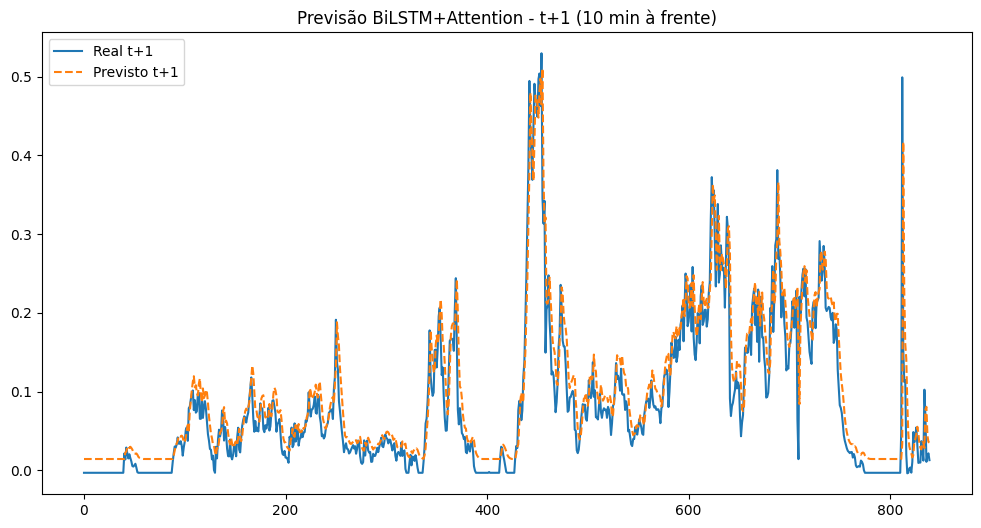

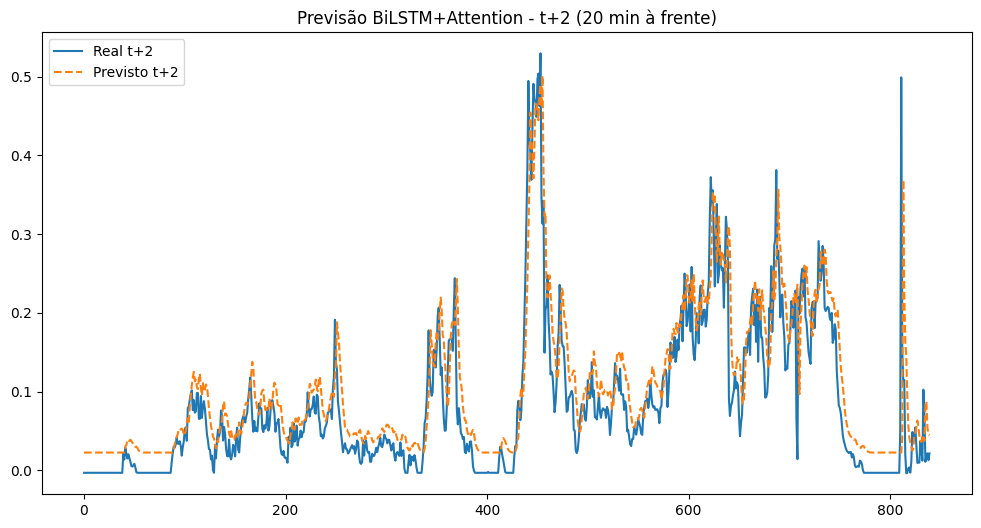

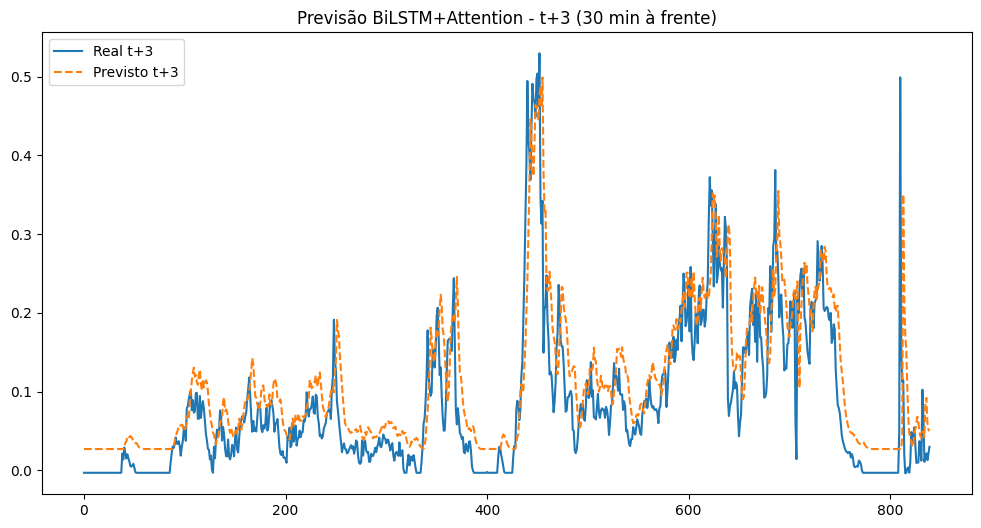

In [20]:
bilstm_att_model(new_data,i,look_back,data_partition,cap)

In [ ]:
bilstm_att_model_with_optuna(new_data,i,look_back,data_partition,cap)

[I 2025-10-28 12:04:04,136] A new study created in memory with name: no-name-0b121173-0906-46af-a5ce-d6df29c8934d


--- PREPARANDO DADOS PARA OTIMIZAÇÃO E TREINO DO BI-LSTM+ATTENTION ---
Dados preparados: 21006 amostras de treino, 5246 amostras de teste.

--- INICIANDO BUSCA DE HIPERPARÂMETROS PARA BI-LSTM+ATTENTION COM OPTUNA ---


  0%|          | 0/30 [00:00<?, ?it/s]

I0000 00:00:1761653044.871865    4665 gpu_device.cc:2019] Created device /job:localhost/replica:0/task:0/device:GPU:0 with 13949 MB memory:  -> device: 0, name: Tesla T4, pci bus id: 0000:00:1e.0, compute capability: 7.5
I0000 00:00:1761653049.751672    8079 cuda_dnn.cc:529] Loaded cuDNN version 90701


--- EXECUTANDO CNN-BI-LSTM EM MODO DE TREINAMENTO ---
Treinando modelo CNN-Bi-LSTM para o quantil: 0.1
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
Modelo CNN-Bi-LSTM salvo em: saved_models/cnn_bilstm_model/model_q01.keras
Treinando modelo CNN-Bi-LSTM para o quantil: 0.5
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
Modelo CNN-Bi-LSTM salvo em: saved_models/cnn_bilstm_model/model_q05.keras
Treinando modelo CNN-Bi-LSTM para o quantil: 0.9
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
Modelo CNN-Bi-LSTM salvo em: saved_models/cnn_bilstm_model/model_q09.keras
Scalers para CNN-Bi-LSTM salvos com sucesso.
Aplicando correção de cruzamento de quantis...

===== Métricas Completas CNN-Bi-LSTM (baseadas na mediana q=0.5) =====
Horizonte t+10: MAPE=4.4175%, RMSE=0.0809, MAE=0.0455, R²=0.9353
Horizonte t+20: MAPE=6.1308%, RMSE=0.1121, MAE=0.0631, R²=0.8757
Horizonte t+30: MAPE=7.1550%, RMSE=0.1262, MAE=0.0737, R²=0.8425


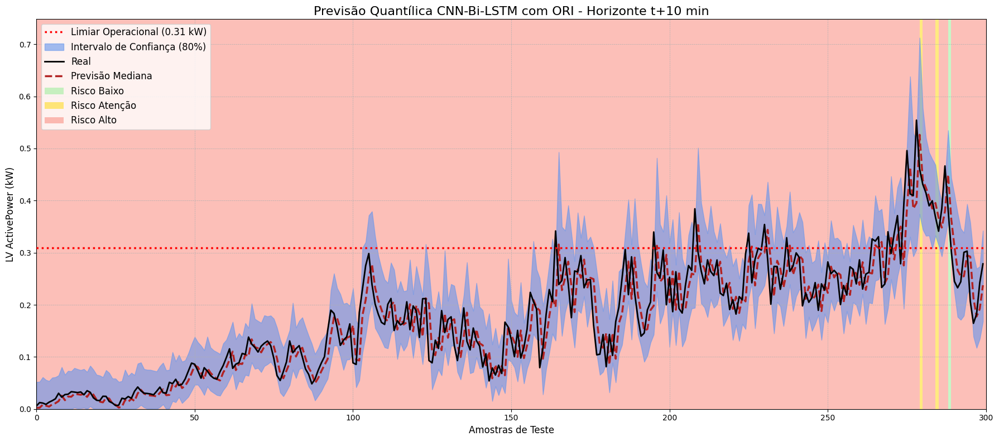

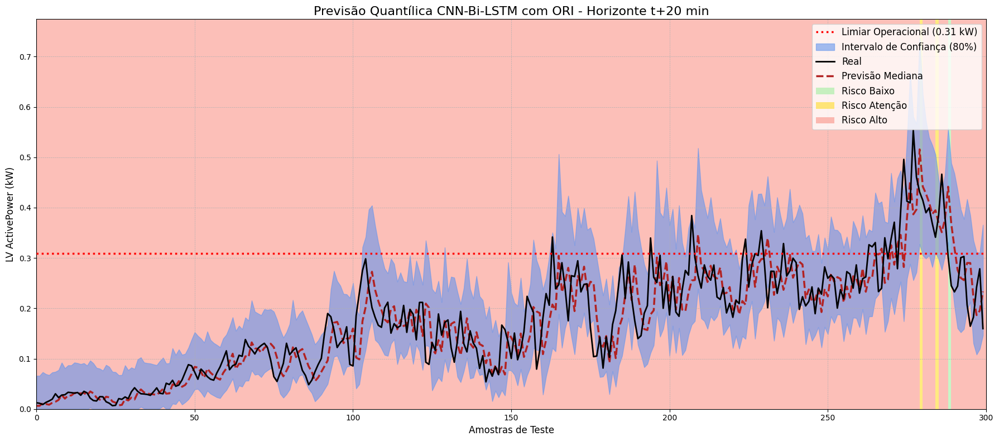

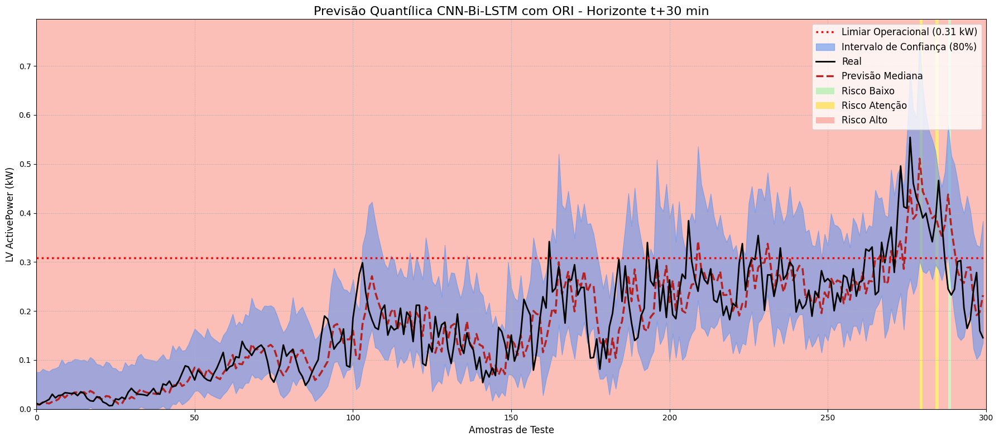

({0.1: array([[0.        , 0.        , 0.        ],
         [0.        , 0.        , 0.        ],
         [0.        , 0.        , 0.        ],
         ...,
         [0.7761245 , 0.76935416, 0.7593654 ],
         [0.7759969 , 0.76925397, 0.7592772 ],
         [0.77570003, 0.7689829 , 0.7590173 ]], dtype=float32),
  0.5: array([[0.00228774, 0.0063483 , 0.00905129],
         [0.00240528, 0.00642671, 0.00908351],
         [0.00820058, 0.01141761, 0.01369616],
         ...,
         [0.8107533 , 0.80803543, 0.80572164],
         [0.81055176, 0.8078636 , 0.8055641 ],
         [0.81023604, 0.80757105, 0.8052813 ]], dtype=float32),
  0.9: array([[0.05178484, 0.06601311, 0.07527566],
         [0.0522866 , 0.06604259, 0.07507756],
         [0.06107455, 0.07321943, 0.08177263],
         ...,
         [0.8185242 , 0.8219109 , 0.8322921 ],
         [0.8186121 , 0.82201827, 0.83239216],
         [0.8185154 , 0.82195437, 0.8323192 ]], dtype=float32)},
 array([[0.0060356, 0.0123626, 0.0114462],
  

In [20]:
cnn_bilstm_model(new_data,i,look_back,data_partition,cap)

[I 2025-09-10 09:47:17,129] A new study created in memory with name: no-name-ff843090-b700-4fb1-ac5d-b3b3279eac45


  0%|          | 0/30 [00:00<?, ?it/s]

27/27 [==============================] - 3s 14ms/step
[I 2025-09-10 09:49:25,379] Trial 4 finished with value: 8.708719299382567 and parameters: {'filters': 16, 'kernel_size': 2, 'neuron': 64, 'dropout': 0.38093710552440324, 'lr': 0.0045591848776775365, 'batch_size': 64}. Best is trial 4 with value: 8.708719299382567.
27/27 [==============================] - 3s 12ms/step
[I 2025-09-10 09:49:38,594] Trial 3 finished with value: 8.759551142235159 and parameters: {'filters': 64, 'kernel_size': 5, 'neuron': 16, 'dropout': 0.1246915377220349, 'lr': 0.002825928359315868, 'batch_size': 64}. Best is trial 4 with value: 8.708719299382567.
27/27 [==============================] - 6s 32ms/step
[I 2025-09-10 09:49:47,982] Trial 2 finished with value: 9.396980348787201 and parameters: {'filters': 64, 'kernel_size': 5, 'neuron': 16, 'dropout': 0.03612670589003969, 'lr': 0.00847544997235719, 'batch_size': 32}. Best is trial 4 with value: 8.708719299382567.
27/27 [==============================] - 3s 

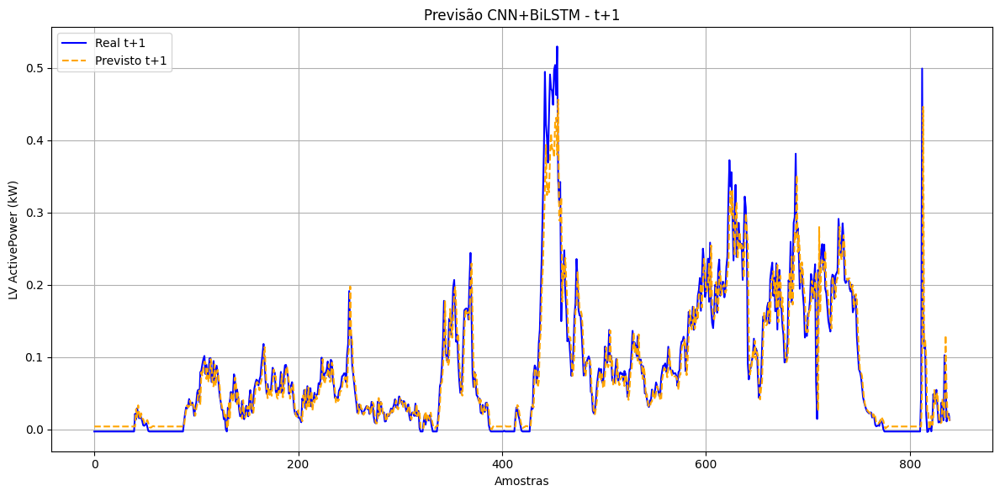

Horizonte t+2: MAPE=2.4731, RMSE=0.0424, MAE=0.0255


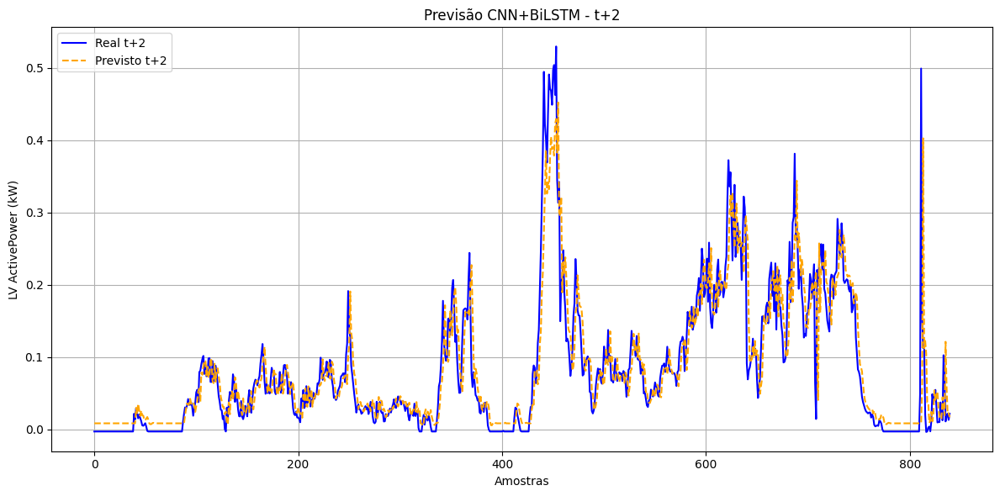

Horizonte t+3: MAPE=2.9790, RMSE=0.0483, MAE=0.0307


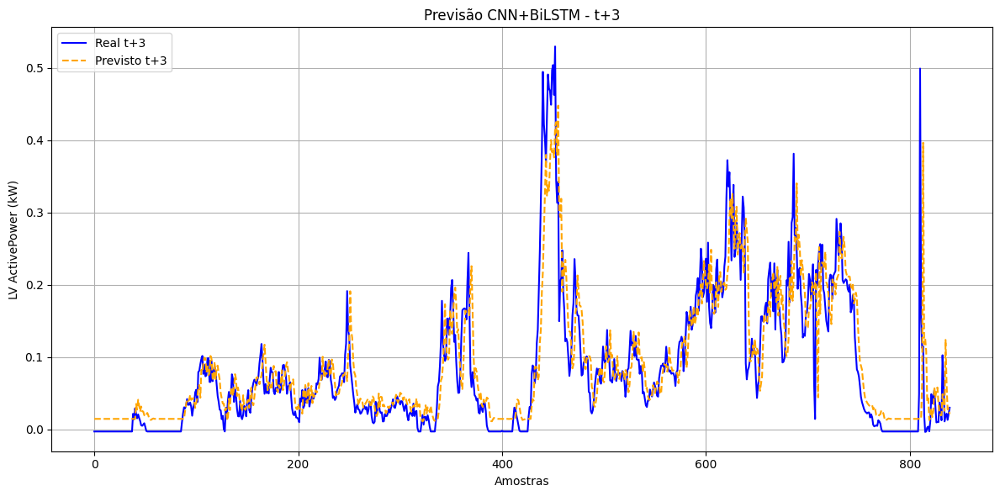

{'Resultados': {'Horizonte t+1': {'MAPE': 1.791366084514098,
   'RMSE': 0.034051905463282565,
   'MAE': 0.018443905206157154},
  'Horizonte t+2': {'MAPE': 2.4731384089859874,
   'RMSE': 0.04244812471488915,
   'MAE': 0.02546343305891972},
  'Horizonte t+3': {'MAPE': 2.9790494164862777,
   'RMSE': 0.04834319964016612,
   'MAE': 0.030672292792142706}},
 'Best Params': {'filters': 32,
  'kernel_size': 2,
  'neuron': 32,
  'dropout': 0.42542670944970906,
  'lr': 0.005887127264021788,
  'batch_size': 32}}

In [13]:
cnn_bilstm_model_with_optuna(new_data,i,look_back,data_partition,cap)

--- EXECUTANDO CNN-BI-LSTM+ATTENTION EM MODO DE TREINAMENTO ---
Treinando modelo CNN-Bi-LSTM+Attention para o quantil: 0.1
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
Modelo CNN-Bi-LSTM+Attention salvo em: saved_models/cnn_bilstm_att_model/model_q01.keras
Treinando modelo CNN-Bi-LSTM+Attention para o quantil: 0.5
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
Modelo CNN-Bi-LSTM+Attention salvo em: saved_models/cnn_bilstm_att_model/model_q05.keras
Treinando modelo CNN-Bi-LSTM+Attention para o quantil: 0.9
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
Modelo CNN-Bi-LSTM+Attention salvo em: saved_models/cnn_bilstm_att_model/model_q09.keras
Scalers para CNN-Bi-LSTM+Attention salvos com sucesso.
Aplicando correção de cruzamento de quantis...

===== Métricas Completas CNN-Bi-LSTM+Attention (baseadas na mediana q=0.5) =====
Horizonte t+10: MAPE=4.5669%, RMSE=0.0825, MAE=0.0470, R²=0.9327
Horizonte t+20: MAPE=6.2016%, RMSE=0.1126, MAE=0.0639, R²=0.8746
Horizonte t+30: MAPE=7.1766%, RMSE=0.1267, MAE=0.0739, 

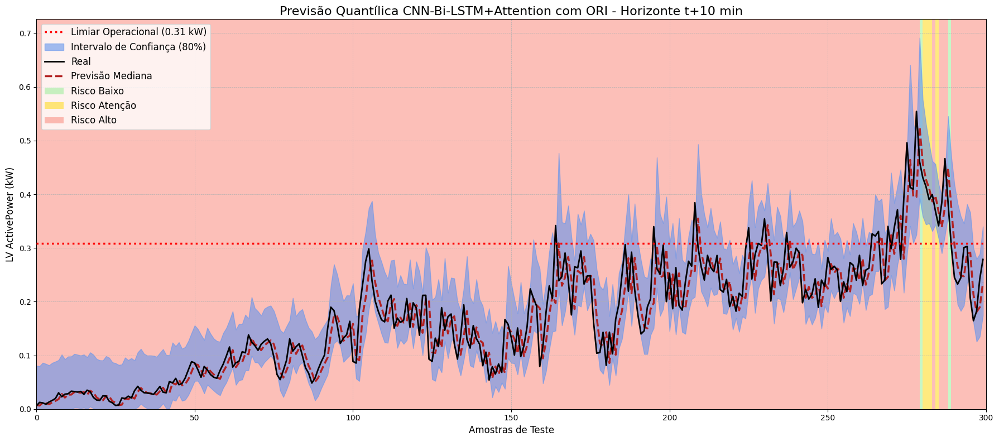

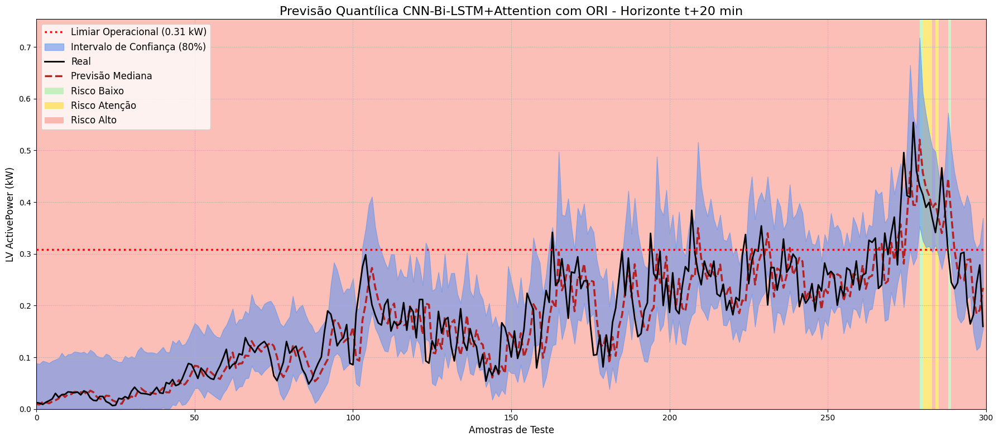

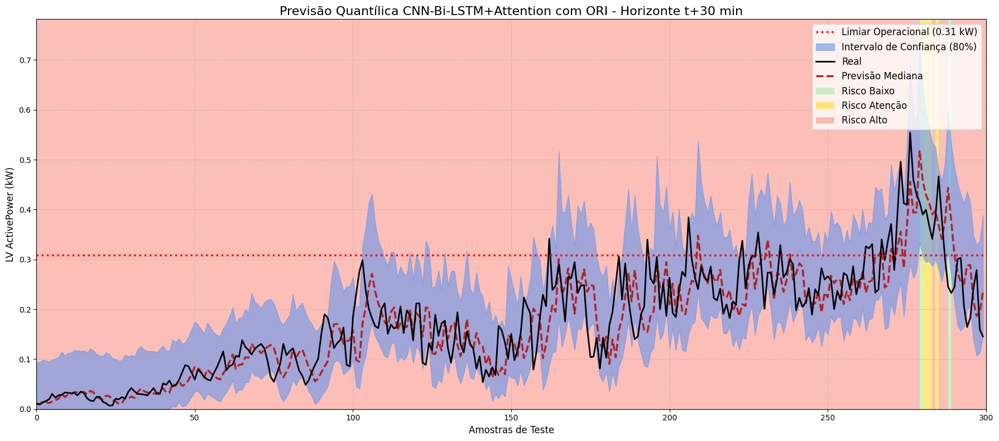

({0.1: array([[0.        , 0.        , 0.        ],
         [0.        , 0.        , 0.        ],
         [0.        , 0.        , 0.        ],
         ...,
         [0.7557124 , 0.732319  , 0.70756805],
         [0.75556225, 0.73217356, 0.7074166 ],
         [0.7552305 , 0.73180676, 0.70703936]], dtype=float32),
  0.5: array([[0.00711122, 0.00939168, 0.01042762],
         [0.00644615, 0.00871147, 0.00975332],
         [0.01178744, 0.01372521, 0.01460812],
         ...,
         [0.8135525 , 0.81155473, 0.811125  ],
         [0.8134019 , 0.81141996, 0.8109978 ],
         [0.81312144, 0.8111553 , 0.8107388 ]], dtype=float32),
  0.9: array([[0.08068883, 0.088232  , 0.09421918],
         [0.07984012, 0.08721192, 0.09318674],
         [0.0861488 , 0.09287219, 0.09885967],
         ...,
         [0.85911185, 0.8823511 , 0.90446585],
         [0.859007  , 0.8822897 , 0.90441155],
         [0.8587362 , 0.8820749 , 0.9042122 ]], dtype=float32)},
 array([[0.0060356, 0.0123626, 0.0114462],
  

In [21]:
cnn_bilstm_att_model(new_data,i,look_back,data_partition,cap)

[I 2025-10-24 20:48:30,733] A new study created in memory with name: no-name-406c8b12-7771-4e08-bce7-1f39bf3dacbe


--- PREPARANDO DADOS PARA OTIMIZAÇÃO E TREINO DO CNN-BI-LSTM-ATTENTION ---
Dados preparados: 21006 amostras de treino, 5246 amostras de teste.

--- INICIANDO BUSCA DE HIPERPARÂMETROS PARA CNN-BI-LSTM-ATTENTION COM OPTUNA ---


  0%|          | 0/30 [00:00<?, ?it/s]

I0000 00:00:1761338911.651318    7357 gpu_device.cc:2019] Created device /job:localhost/replica:0/task:0/device:GPU:0 with 13949 MB memory:  -> device: 0, name: Tesla T4, pci bus id: 0000:00:1e.0, compute capability: 7.5
I0000 00:00:1761338915.882619   11642 cuda_dnn.cc:529] Loaded cuDNN version 90701


[I 2025-10-24 20:50:37,293] Trial 0 finished with value: 6.113841449218122 and parameters: {'cnn_filters': 32, 'kernel_size': 2, 'bilstm_units': 128, 'agg_lstm_units': 64, 'dropout_rate': 0.21819709119007716, 'learning_rate': 0.004507789244380858, 'batch_size': 128}. Best is trial 0 with value: 6.113841449218122.
[I 2025-10-24 20:52:54,990] Trial 1 finished with value: 6.023986665611074 and parameters: {'cnn_filters': 64, 'kernel_size': 3, 'bilstm_units': 32, 'agg_lstm_units': 64, 'dropout_rate': 0.49832180456153496, 'learning_rate': 0.002096639138734541, 'batch_size': 128}. Best is trial 1 with value: 6.023986665611074.
[I 2025-10-24 20:58:23,377] Trial 2 finished with value: 5.934431409327437 and parameters: {'cnn_filters': 32, 'kernel_size': 5, 'bilstm_units': 64, 'agg_lstm_units': 64, 'dropout_rate': 0.4287458607742449, 'learning_rate': 0.0006609537193909548, 'batch_size': 128}. Best is trial 2 with value: 5.934431409327437.
[I 2025-10-24 21:01:23,470] Trial 3 finished with value: 

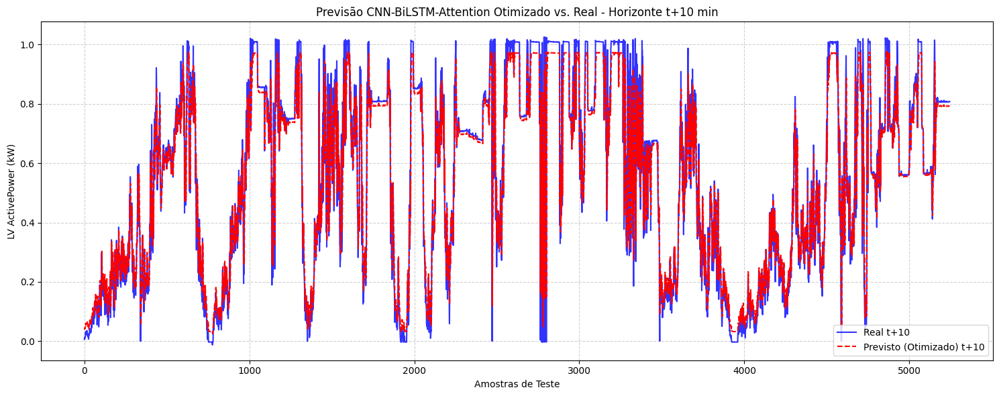

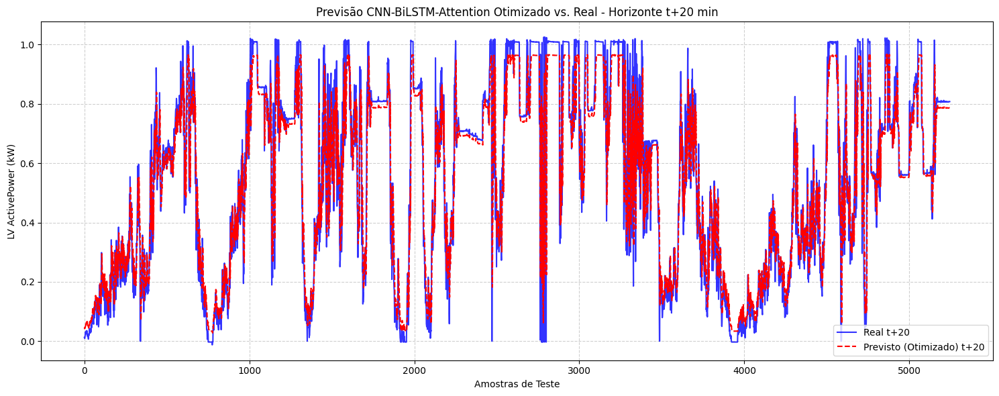

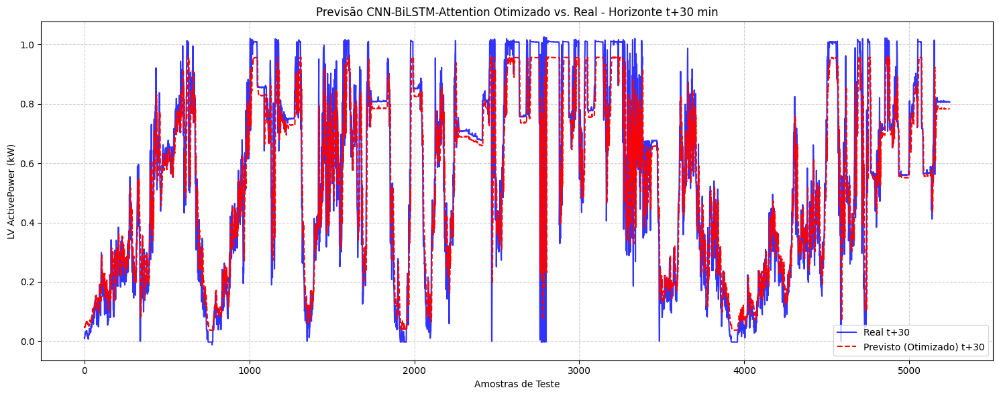

(<Functional name=functional, built=True>,
 {'cnn_filters': 128,
  'kernel_size': 5,
  'bilstm_units': 64,
  'agg_lstm_units': 32,
  'dropout_rate': 0.2329937583942957,
  'learning_rate': 0.00010174940696950422,
  'batch_size': 128},
   Horizonte  MAPE (%)  RMSE (MW)  MAE (MW)        R²
 0  t+10 min  5.180039   0.082830  0.053334  0.932160
 1  t+20 min  6.856522   0.110651  0.070595  0.878881
 2  t+30 min  7.901169   0.124211  0.081350  0.847311)

In [23]:
cnn_bilstm_att_model_with_optuna(new_data,i,look_back,data_partition,cap)

--- EXECUTANDO TRANSFORMER (v3) EM MODO DE TREINAMENTO ---
Treinando modelo Transformer (v3) para o quantil: 0.1


2025-10-28 19:18:21.937821: I external/local_xla/xla/stream_executor/cuda/subprocess_compilation.cc:346] ptxas warning : Registers are spilled to local memory in function 'input_add_multiply_reduce_fusion', 32 bytes spill stores, 32 bytes spill loads



164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
Modelo Transformer (v3) salvo em: saved_models/transformer_model/model_q01.keras
Treinando modelo Transformer (v3) para o quantil: 0.5


2025-10-28 19:20:09.273551: I external/local_xla/xla/stream_executor/cuda/subprocess_compilation.cc:346] ptxas warning : Registers are spilled to local memory in function 'input_add_multiply_reduce_fusion', 32 bytes spill stores, 32 bytes spill loads



164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
Modelo Transformer (v3) salvo em: saved_models/transformer_model/model_q05.keras
Treinando modelo Transformer (v3) para o quantil: 0.9


2025-10-28 19:21:01.473928: I external/local_xla/xla/stream_executor/cuda/subprocess_compilation.cc:346] ptxas warning : Registers are spilled to local memory in function 'input_add_multiply_reduce_fusion', 32 bytes spill stores, 32 bytes spill loads



164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
Modelo Transformer (v3) salvo em: saved_models/transformer_model/model_q09.keras
Scalers para Transformer (v3) salvos com sucesso.
Aplicando correção de cruzamento de quantis...

===== Métricas Completas Transformer (v3) (baseadas na mediana q=0.5) =====
Horizonte t+10: MAPE=5.1096%, RMSE=0.0909, MAE=0.0526, R²=0.9182
Horizonte t+20: MAPE=6.5040%, RMSE=0.1155, MAE=0.0670, R²=0.8680
Horizonte t+30: MAPE=7.4920%, RMSE=0.1291, MAE=0.0771, R²=0.8351


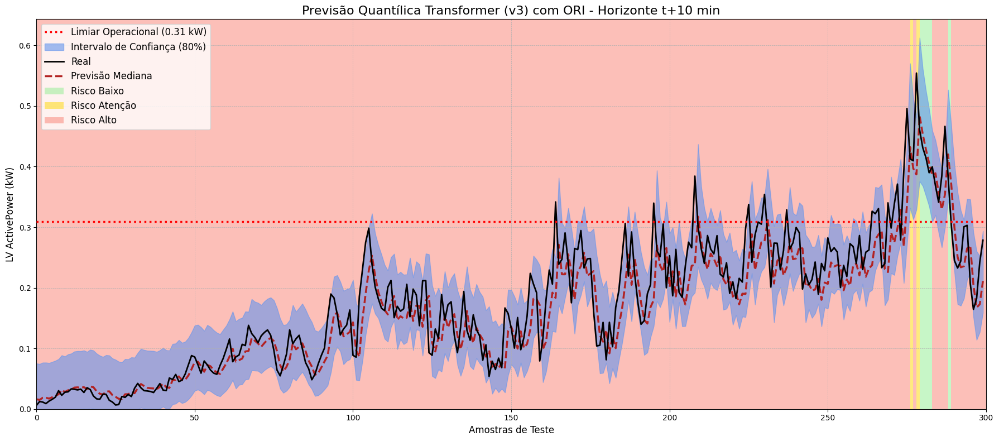

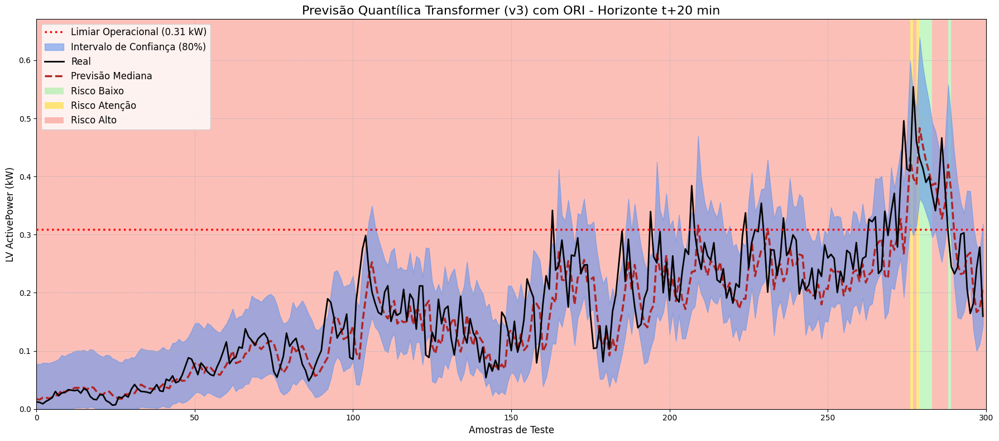

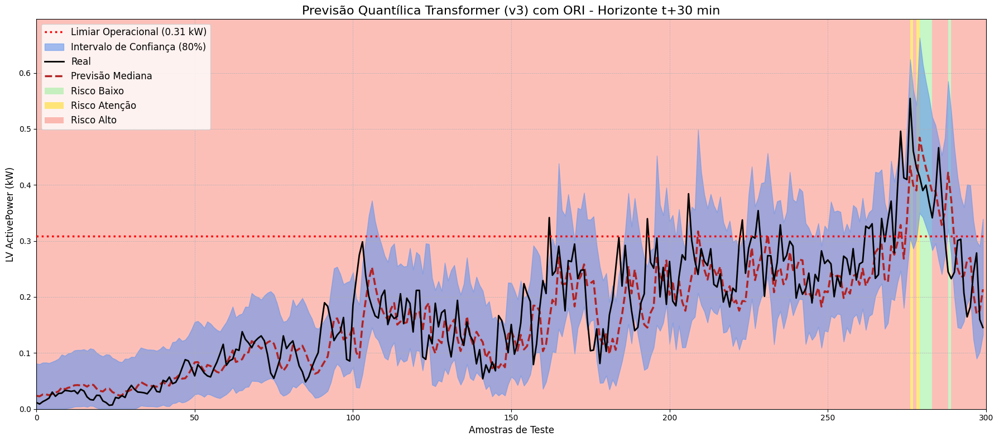

({0.1: array([[0.        , 0.        , 0.        ],
         [0.        , 0.        , 0.        ],
         [0.        , 0.        , 0.        ],
         ...,
         [0.70995235, 0.70164096, 0.6889897 ],
         [0.70974857, 0.7014366 , 0.68878734],
         [0.7094176 , 0.70110404, 0.6884573 ]], dtype=float32),
  0.5: array([[0.01608923, 0.01705684, 0.02364239],
         [0.01510817, 0.01607223, 0.02264357],
         [0.0185807 , 0.01955615, 0.0260137 ],
         ...,
         [0.81309396, 0.8111044 , 0.8159591 ],
         [0.813143  , 0.8111539 , 0.8160088 ],
         [0.81303805, 0.81104714, 0.81590796]], dtype=float32),
  0.9: array([[0.07519194, 0.07785384, 0.08117995],
         [0.07429501, 0.07685532, 0.08007878],
         [0.07656425, 0.079401  , 0.08281279],
         ...,
         [0.860954  , 0.87087524, 0.8854869 ],
         [0.8609058 , 0.8708311 , 0.8854437 ],
         [0.8606966 , 0.8706384 , 0.88525873]], dtype=float32)},
 array([[0.0060356, 0.0123626, 0.0114462],
  

In [22]:
transformer_model(new_data,i,look_back,data_partition,cap)

--- EXECUTANDO TFT EM MODO DE TREINAMENTO ---


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/layer.py:421: UserWarning: `build()` was called on layer 'gated_residual_network_1', however the layer does not have a `build()` method implemented and it looks like it has unbuilt state. This will cause the layer to be marked as built, despite not being actually built, which may cause failures down the line. Make sure to implement a proper `build()` method.
  warnings.warn(
/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/layer.py:421: UserWarning: `build()` was called on layer 'gated_residual_network_2', however the layer does not have a `build()` method implemented and it looks like it has unbuilt state. This will cause the layer to be marked as built, despite not being actually built, which may cause failures down the line. Make sure to implement a proper `build()` method.
  warnings.warn(


Modelo TFT e scalers salvos com sucesso.
164/164 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
Aplicando correção de cruzamento de quantis...

===== Métricas Completas TFT (baseadas na mediana q=0.5) =====
Horizonte t+10: MAPE=4.6762%, RMSE=0.0815, MAE=0.0481, R²=0.9343
Horizonte t+20: MAPE=6.2143%, RMSE=0.1096, MAE=0.0640, R²=0.8812
Horizonte t+30: MAPE=7.1999%, RMSE=0.1238, MAE=0.0741, R²=0.8484


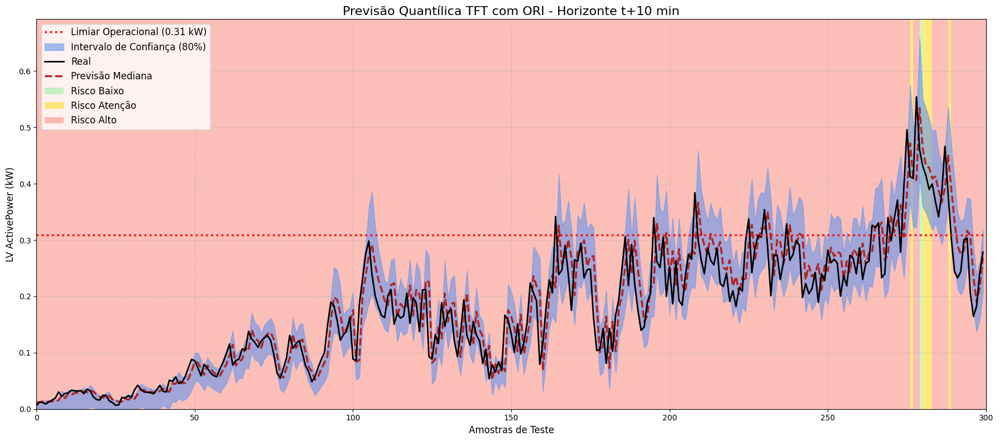

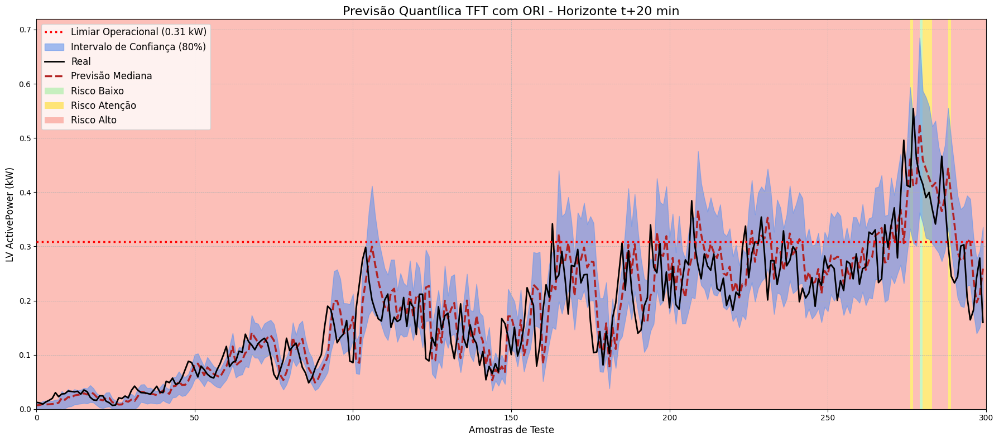

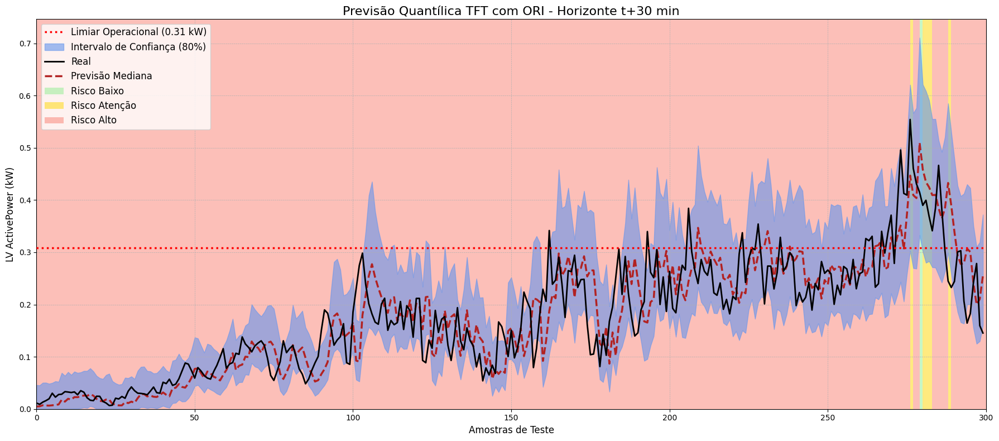

({0.1: array([[0.        , 0.        , 0.        ],
         [0.        , 0.        , 0.        ],
         [0.        , 0.        , 0.        ],
         ...,
         [0.7458222 , 0.7300951 , 0.7031135 ],
         [0.7453481 , 0.7301093 , 0.7022431 ],
         [0.7408938 , 0.72671115, 0.697258  ]], dtype=float32),
  0.5: array([[0.01137593, 0.0066792 , 0.00485036],
         [0.01244196, 0.00747651, 0.00523928],
         [0.01335656, 0.00902515, 0.00717139],
         ...,
         [0.8156037 , 0.8164437 , 0.81530994],
         [0.815201  , 0.815693  , 0.815267  ],
         [0.81249475, 0.8115877 , 0.8139447 ]], dtype=float32),
  0.9: array([[0.01167714, 0.01106596, 0.04592639],
         [0.01244196, 0.01046228, 0.04527092],
         [0.01435748, 0.0143663 , 0.05029672],
         ...,
         [0.8630096 , 0.8834437 , 0.87836653],
         [0.8634164 , 0.8831297 , 0.87747276],
         [0.86322343, 0.8818179 , 0.87625307]], dtype=float32)},
 array([[0.0060356, 0.0123626, 0.0114462],
  

In [23]:
tft_model(new_data,i,look_back,data_partition,cap)

--- EXECUTANDO proposed_method EM MODO DE TREINAMENTO ---
Iniciando decomposição do sinal (CEEMDAN + EWT)...
Decomposição concluída e salva.
--- Q0.1 | Treinando LSTM para: imf_denoised ---


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


--- Q0.1 | Treinando LSTM para: imf_1 ---


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


--- Q0.1 | Treinando LSTM para: imf_2 ---


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


--- Q0.1 | Treinando LSTM para: imf_3 ---


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


--- Q0.1 | Treinando LSTM para: imf_4 ---


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


--- Q0.1 | Treinando LSTM para: imf_5 ---


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


--- Q0.1 | Treinando LSTM para: imf_6 ---


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


--- Q0.1 | Treinando LSTM para: imf_7 ---


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


--- Q0.1 | Treinando LSTM para: imf_8 ---


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


--- Q0.1 | Treinando LSTM para: imf_9 ---


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


--- Q0.1 | Treinando LSTM para: imf_10 ---


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


--- Q0.1 | Treinando LSTM para: imf_11 ---


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


--- Q0.1 | Treinando LSTM para: imf_12 ---


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


--- Q0.1 | Treinando LSTM para: imf_13 ---


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


--- Q0.5 | Treinando LSTM para: imf_denoised ---


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


--- Q0.5 | Treinando LSTM para: imf_1 ---


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


--- Q0.5 | Treinando LSTM para: imf_2 ---


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


--- Q0.5 | Treinando LSTM para: imf_3 ---


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


--- Q0.5 | Treinando LSTM para: imf_4 ---


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


--- Q0.5 | Treinando LSTM para: imf_5 ---


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


--- Q0.5 | Treinando LSTM para: imf_6 ---


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


--- Q0.5 | Treinando LSTM para: imf_7 ---


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


--- Q0.5 | Treinando LSTM para: imf_8 ---


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


--- Q0.5 | Treinando LSTM para: imf_9 ---


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


--- Q0.5 | Treinando LSTM para: imf_10 ---


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


--- Q0.5 | Treinando LSTM para: imf_11 ---


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


--- Q0.5 | Treinando LSTM para: imf_12 ---


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


--- Q0.5 | Treinando LSTM para: imf_13 ---


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


--- Q0.9 | Treinando LSTM para: imf_denoised ---


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


--- Q0.9 | Treinando LSTM para: imf_1 ---


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


--- Q0.9 | Treinando LSTM para: imf_2 ---


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


--- Q0.9 | Treinando LSTM para: imf_3 ---


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


--- Q0.9 | Treinando LSTM para: imf_4 ---


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


--- Q0.9 | Treinando LSTM para: imf_5 ---


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


--- Q0.9 | Treinando LSTM para: imf_6 ---


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


--- Q0.9 | Treinando LSTM para: imf_7 ---


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


--- Q0.9 | Treinando LSTM para: imf_8 ---


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


--- Q0.9 | Treinando LSTM para: imf_9 ---


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


--- Q0.9 | Treinando LSTM para: imf_10 ---


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


--- Q0.9 | Treinando LSTM para: imf_11 ---


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


--- Q0.9 | Treinando LSTM para: imf_12 ---


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


--- Q0.9 | Treinando LSTM para: imf_13 ---


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


Aplicando correção de cruzamento de quantis...

===== Métricas Completas (CEEMDAN-EWT-LSTM) =====
Horizonte t+10: MAPE=1.6947%, RMSE=0.0294, MAE=0.0174, R²=0.9914
Horizonte t+20: MAPE=2.2512%, RMSE=0.0394, MAE=0.0232, R²=0.9846
Horizonte t+30: MAPE=2.5011%, RMSE=0.0431, MAE=0.0258, R²=0.9816


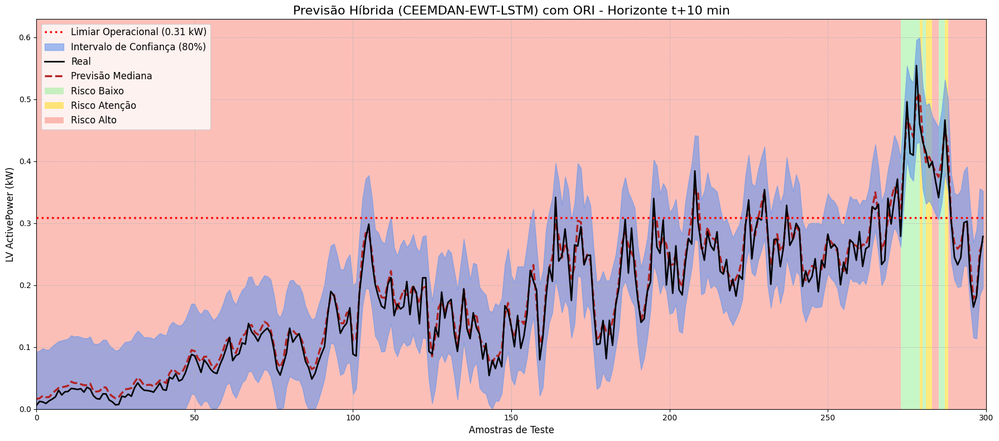

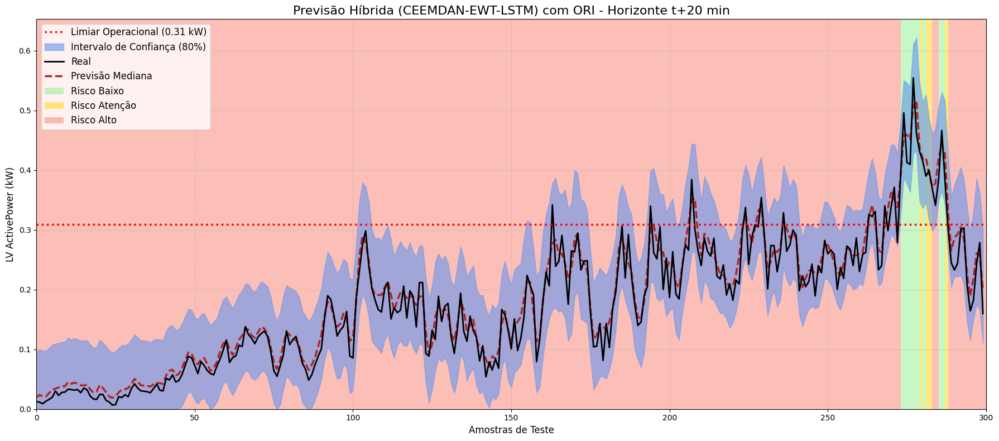

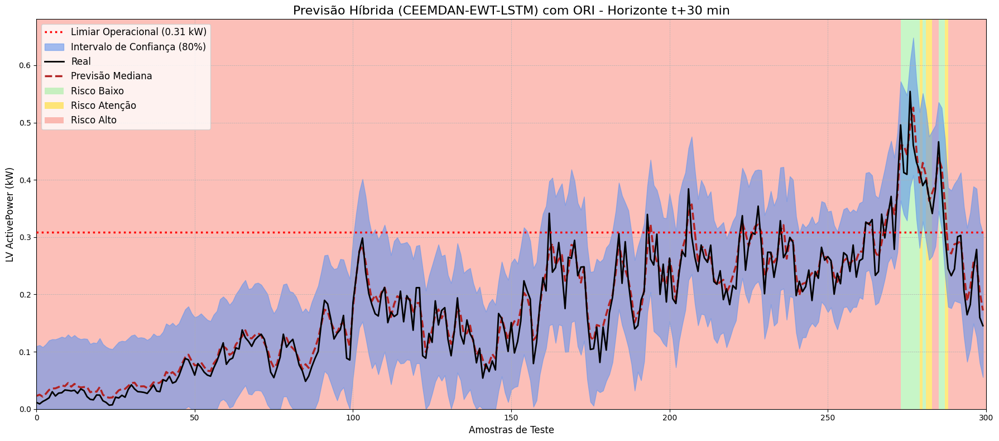

({0.1: array([[0.        , 0.        , 0.        ],
         [0.        , 0.        , 0.        ],
         [0.        , 0.        , 0.        ],
         ...,
         [0.7175013 , 0.6998446 , 0.7107017 ],
         [0.71764785, 0.6968527 , 0.7071755 ],
         [0.7158121 , 0.6982707 , 0.709893  ]], dtype=float32),
  0.5: array([[0.01614326, 0.0196633 , 0.02292567],
         [0.01740479, 0.02369067, 0.02503106],
         [0.02141517, 0.02110642, 0.02159271],
         ...,
         [0.81126463, 0.8143925 , 0.8147739 ],
         [0.811829  , 0.8112691 , 0.81095326],
         [0.8098433 , 0.81350017, 0.8146342 ]], dtype=float32),
  0.9: array([[0.09253573, 0.09572089, 0.1097368 ],
         [0.09390742, 0.09955898, 0.11144441],
         [0.0979445 , 0.09737748, 0.10792547],
         ...,
         [0.8675949 , 0.86934793, 0.8802652 ],
         [0.8679118 , 0.86630845, 0.87646264],
         [0.8660041 , 0.8680968 , 0.87995386]], dtype=float32)},
 array([[0.0060356, 0.0123626, 0.0114462],
  

In [24]:
proposed_method(new_data,i,look_back,data_partition,cap)

--- EXECUTANDO (CEEMDAN-EWT)-TFT EM MODO DE TREINAMENTO ---
Iniciando decomposição do sinal (CEEMDAN + EWT)...
Decomposição concluída e features salvas.
Construindo e treinando o modelo (CEEMDAN-EWT)-TFT...


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/layer.py:421: UserWarning: `build()` was called on layer 'gated_residual_network_1', however the layer does not have a `build()` method implemented and it looks like it has unbuilt state. This will cause the layer to be marked as built, despite not being actually built, which may cause failures down the line. Make sure to implement a proper `build()` method.
  warnings.warn(
/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/layer.py:421: UserWarning: `build()` was called on layer 'gated_residual_network_2', however the layer does not have a `build()` method implemented and it looks like it has unbuilt state. This will cause the layer to be marked as built, despite not being actually built, which may cause failures down the line. Make sure to implement a proper `build()` method.
  warnings.warn(


Modelo TFT Agregador salvo com sucesso.
164/164 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
Aplicando correção de cruzamento de quantis...

===== Métricas Completas (CEEMDAN-EWT-TFT) =====
Horizonte t+10: MAPE=1.7610%, RMSE=0.0324, MAE=0.0181, R²=0.9896
Horizonte t+20: MAPE=2.3419%, RMSE=0.0444, MAE=0.0241, R²=0.9805
Horizonte t+30: MAPE=2.6802%, RMSE=0.0499, MAE=0.0276, R²=0.9754


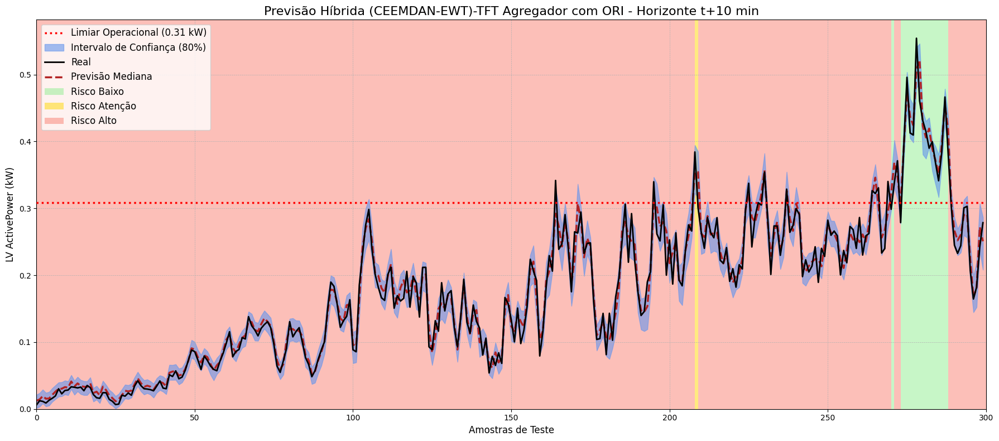

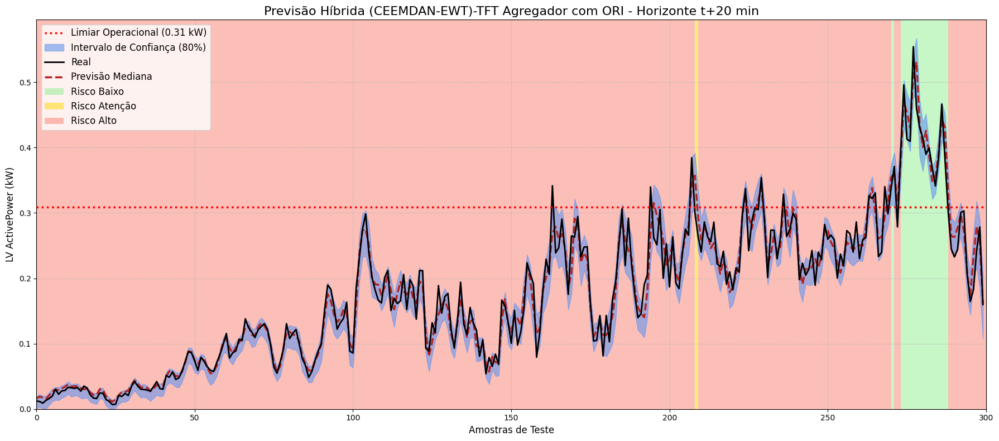

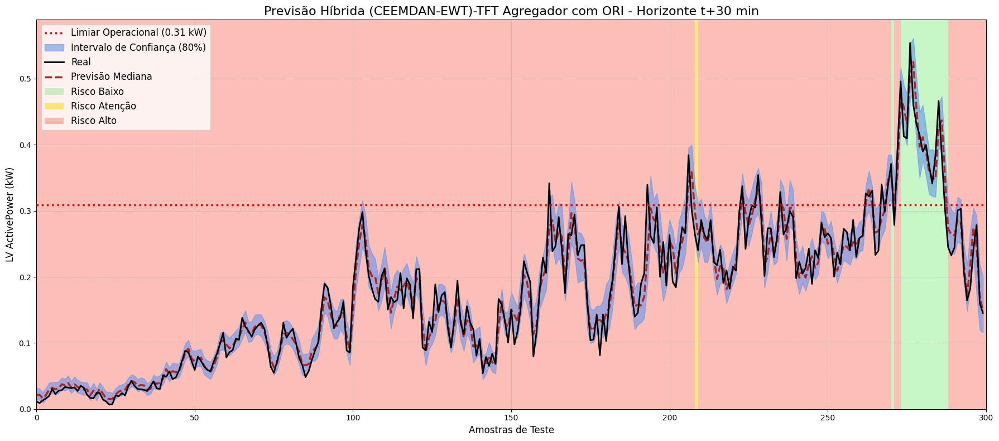

({0.1: array([[1.4297940e-03, 1.0046341e-03, 1.4016150e-02],
         [3.5471297e-03, 3.2093502e-03, 1.3817577e-02],
         [8.4247570e-03, 7.1441900e-04, 9.3619805e-03],
         ...,
         [7.8809416e-01, 7.9012948e-01, 7.8168684e-01],
         [7.9151452e-01, 7.8862894e-01, 7.7719700e-01],
         [7.8500748e-01, 7.8902745e-01, 7.8240103e-01]], dtype=float32),
  0.5: array([[0.01252526, 0.01592922, 0.02148148],
         [0.01425275, 0.01911148, 0.02132019],
         [0.01946595, 0.01734775, 0.01623139],
         ...,
         [0.8066371 , 0.80910724, 0.8099752 ],
         [0.8099032 , 0.8079813 , 0.8059062 ],
         [0.8037993 , 0.8075717 , 0.81020004]], dtype=float32),
  0.9: array([[0.02137679, 0.01974568, 0.03222116],
         [0.02390823, 0.02247152, 0.03059369],
         [0.02905384, 0.02020654, 0.02529102],
         ...,
         [0.82757604, 0.83075935, 0.8401523 ],
         [0.8309274 , 0.82912093, 0.83551514],
         [0.82463926, 0.82952684, 0.8406017 ]], dtype=fl

In [25]:
proposed_method_tft_aggregator(new_data,i,look_back,data_partition,cap)

--- EXECUTANDO proposed_method_bilstm EM MODO DE TREINAMENTO ---
Iniciando decomposição do sinal (CEEMDAN + EWT)...
Decomposição concluída e salva.
--- Q0.1 | Treinando BiLSTM para: imf_denoised ---


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


--- Q0.1 | Treinando BiLSTM para: imf_1 ---


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


--- Q0.1 | Treinando BiLSTM para: imf_2 ---


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


--- Q0.1 | Treinando BiLSTM para: imf_3 ---


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


--- Q0.1 | Treinando BiLSTM para: imf_4 ---


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


--- Q0.1 | Treinando BiLSTM para: imf_5 ---


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


--- Q0.1 | Treinando BiLSTM para: imf_6 ---


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


--- Q0.1 | Treinando BiLSTM para: imf_7 ---


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


--- Q0.1 | Treinando BiLSTM para: imf_8 ---


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


--- Q0.1 | Treinando BiLSTM para: imf_9 ---


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


--- Q0.1 | Treinando BiLSTM para: imf_10 ---


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


--- Q0.1 | Treinando BiLSTM para: imf_11 ---


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


--- Q0.1 | Treinando BiLSTM para: imf_12 ---


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


--- Q0.1 | Treinando BiLSTM para: imf_13 ---


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


--- Q0.5 | Treinando BiLSTM para: imf_denoised ---


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


--- Q0.5 | Treinando BiLSTM para: imf_1 ---


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


--- Q0.5 | Treinando BiLSTM para: imf_2 ---


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


--- Q0.5 | Treinando BiLSTM para: imf_3 ---


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


--- Q0.5 | Treinando BiLSTM para: imf_4 ---


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


--- Q0.5 | Treinando BiLSTM para: imf_5 ---


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


--- Q0.5 | Treinando BiLSTM para: imf_6 ---


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


--- Q0.5 | Treinando BiLSTM para: imf_7 ---


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


--- Q0.5 | Treinando BiLSTM para: imf_8 ---


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


--- Q0.5 | Treinando BiLSTM para: imf_9 ---


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


--- Q0.5 | Treinando BiLSTM para: imf_10 ---


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


--- Q0.5 | Treinando BiLSTM para: imf_11 ---


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


--- Q0.5 | Treinando BiLSTM para: imf_12 ---


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


--- Q0.5 | Treinando BiLSTM para: imf_13 ---


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


--- Q0.9 | Treinando BiLSTM para: imf_denoised ---


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


--- Q0.9 | Treinando BiLSTM para: imf_1 ---


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


--- Q0.9 | Treinando BiLSTM para: imf_2 ---


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


--- Q0.9 | Treinando BiLSTM para: imf_3 ---


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


--- Q0.9 | Treinando BiLSTM para: imf_4 ---


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


--- Q0.9 | Treinando BiLSTM para: imf_5 ---


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


--- Q0.9 | Treinando BiLSTM para: imf_6 ---


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


--- Q0.9 | Treinando BiLSTM para: imf_7 ---


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


--- Q0.9 | Treinando BiLSTM para: imf_8 ---


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


--- Q0.9 | Treinando BiLSTM para: imf_9 ---


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


--- Q0.9 | Treinando BiLSTM para: imf_10 ---


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


--- Q0.9 | Treinando BiLSTM para: imf_11 ---


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


--- Q0.9 | Treinando BiLSTM para: imf_12 ---


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


--- Q0.9 | Treinando BiLSTM para: imf_13 ---


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


Aplicando correção de cruzamento de quantis...

===== Métricas Completas (CEEMDAN-EWT-BiLSTM) =====
Horizonte t+10: MAPE=2.1980%, RMSE=0.0333, MAE=0.0226, R²=0.9890
Horizonte t+20: MAPE=2.7308%, RMSE=0.0429, MAE=0.0281, R²=0.9818
Horizonte t+30: MAPE=2.8965%, RMSE=0.0456, MAE=0.0298, R²=0.9794


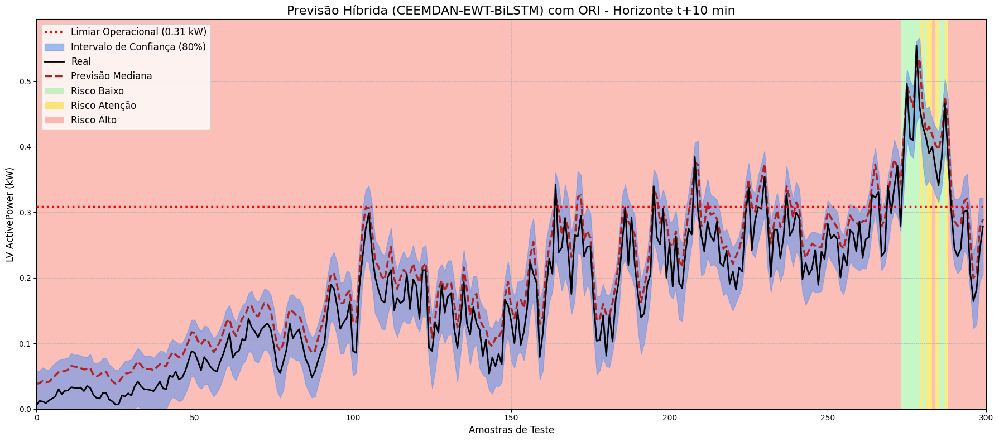

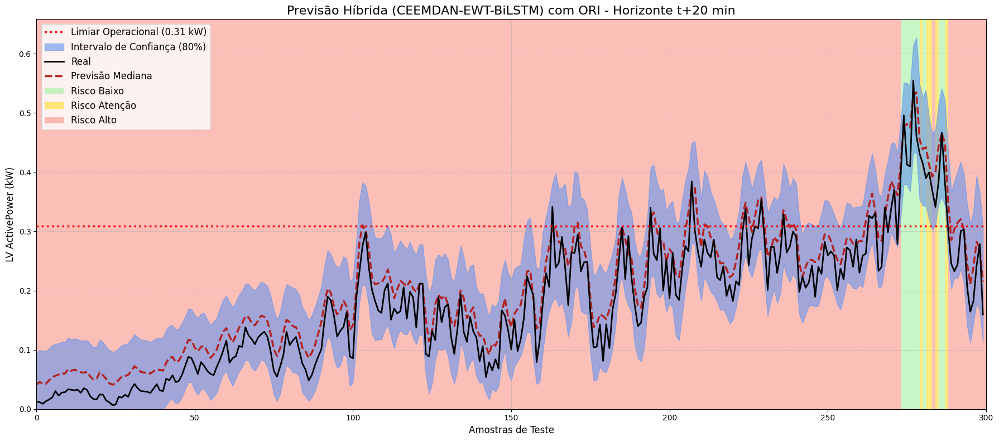

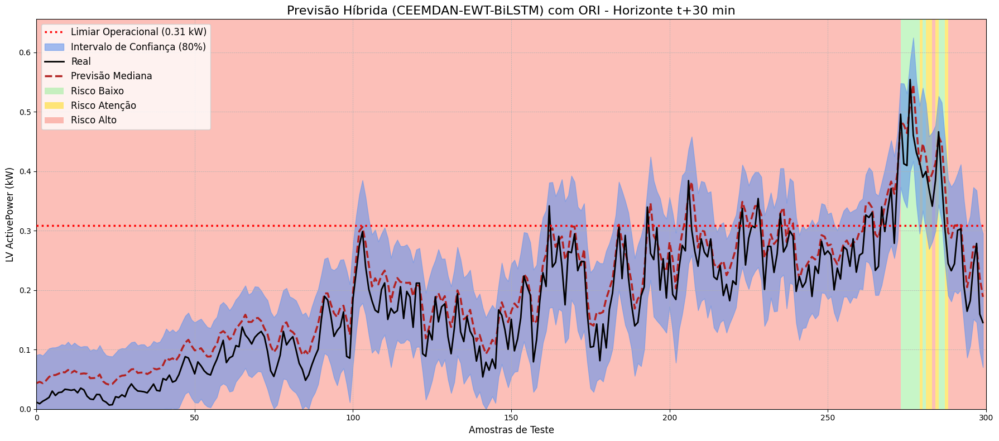

({0.1: array([[0.        , 0.        , 0.        ],
         [0.        , 0.        , 0.        ],
         [0.        , 0.        , 0.        ],
         ...,
         [0.73747057, 0.73439777, 0.72447824],
         [0.7376558 , 0.7310746 , 0.72027063],
         [0.7359067 , 0.7333076 , 0.72415984]], dtype=float32),
  0.5: array([[0.0381853 , 0.0413425 , 0.04348001],
         [0.03975242, 0.04570201, 0.04577827],
         [0.04267535, 0.04305047, 0.04342884],
         ...,
         [0.80581415, 0.80729187, 0.80585825],
         [0.8057609 , 0.8041896 , 0.80274725],
         [0.8046067 , 0.8063129 , 0.80533886]], dtype=float32),
  0.9: array([[0.05675238, 0.09496206, 0.09066534],
         [0.05819422, 0.09908736, 0.09232333],
         [0.0632371 , 0.09780136, 0.08975309],
         ...,
         [0.8932505 , 0.889761  , 0.90456665],
         [0.8943105 , 0.887098  , 0.90094805],
         [0.8914352 , 0.88841724, 0.90412635]], dtype=float32)},
 array([[0.0060356, 0.0123626, 0.0114462],
  

In [26]:
proposed_method_bilstm(new_data,i,look_back,data_partition,cap)

--- EXECUTANDO proposed_method_bilstm_att EM MODO DE TREINAMENTO ---
Iniciando decomposição do sinal (CEEMDAN + EWT)...
Decomposição concluída e salva.
--- Q0.1 | Treinando BiLSTM+Attn para: imf_denoised ---
--- Q0.1 | Treinando BiLSTM+Attn para: imf_1 ---
--- Q0.1 | Treinando BiLSTM+Attn para: imf_2 ---
--- Q0.1 | Treinando BiLSTM+Attn para: imf_3 ---
--- Q0.1 | Treinando BiLSTM+Attn para: imf_4 ---
--- Q0.1 | Treinando BiLSTM+Attn para: imf_5 ---
--- Q0.1 | Treinando BiLSTM+Attn para: imf_6 ---
--- Q0.1 | Treinando BiLSTM+Attn para: imf_7 ---
--- Q0.1 | Treinando BiLSTM+Attn para: imf_8 ---
--- Q0.1 | Treinando BiLSTM+Attn para: imf_9 ---
--- Q0.1 | Treinando BiLSTM+Attn para: imf_10 ---
--- Q0.1 | Treinando BiLSTM+Attn para: imf_11 ---
--- Q0.1 | Treinando BiLSTM+Attn para: imf_12 ---
--- Q0.1 | Treinando BiLSTM+Attn para: imf_13 ---
--- Q0.5 | Treinando BiLSTM+Attn para: imf_denoised ---
--- Q0.5 | Treinando BiLSTM+Attn para: imf_1 ---
--- Q0.5 | Treinando BiLSTM+Attn para: imf_2 -

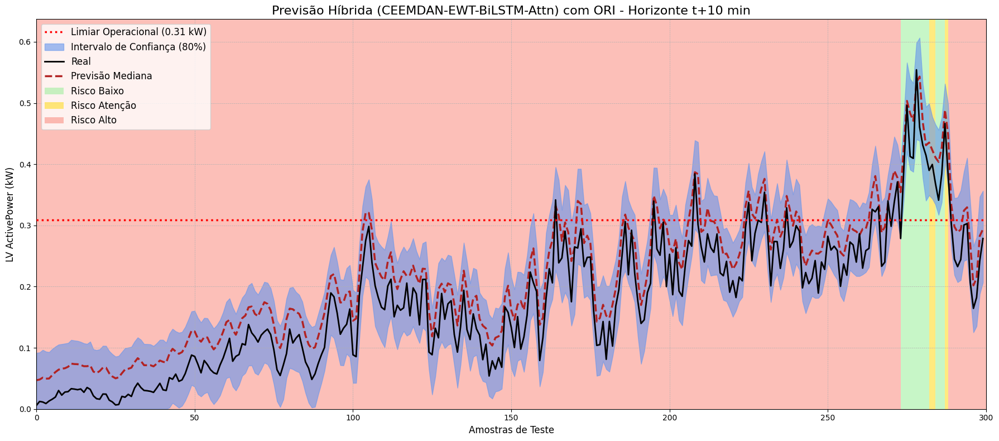

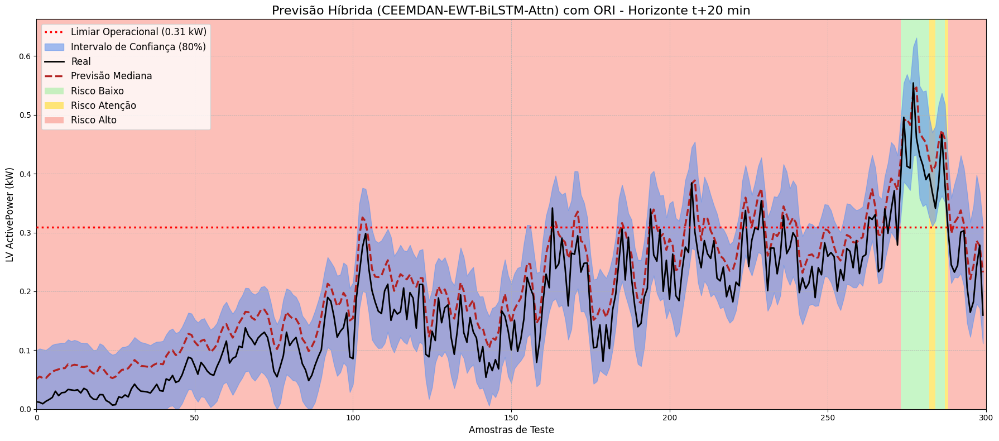

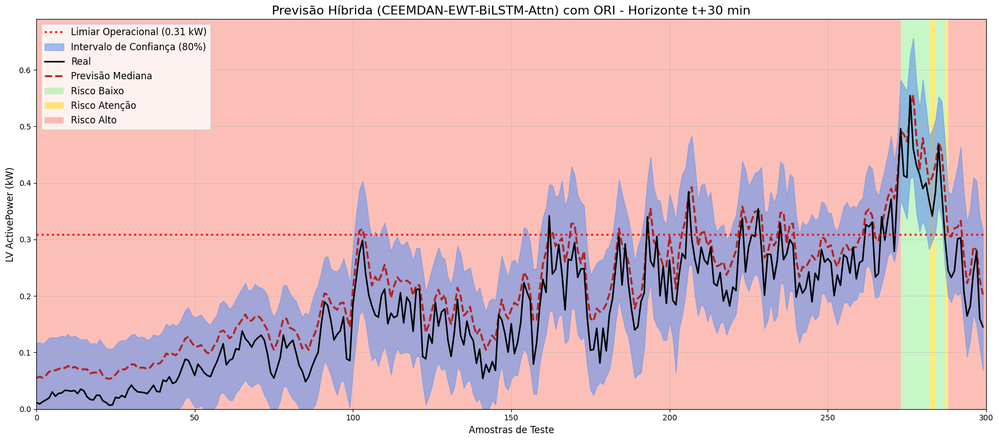

({0.1: array([[0.        , 0.        , 0.        ],
         [0.        , 0.        , 0.        ],
         [0.        , 0.        , 0.        ],
         ...,
         [0.74318975, 0.7407241 , 0.72608274],
         [0.74286485, 0.7378605 , 0.723196  ],
         [0.7418973 , 0.7393578 , 0.7258231 ]], dtype=float32),
  0.5: array([[0.0470455 , 0.05108911, 0.05478987],
         [0.04816663, 0.0552386 , 0.05721536],
         [0.05125266, 0.05280536, 0.05526975],
         ...,
         [0.8031268 , 0.80509645, 0.8032299 ],
         [0.80268383, 0.8018842 , 0.80059016],
         [0.8016457 , 0.80377364, 0.80264884]], dtype=float32),
  0.9: array([[0.09168667, 0.09945625, 0.11658424],
         [0.09242603, 0.10272849, 0.11790556],
         [0.09658706, 0.10109547, 0.11495787],
         ...,
         [0.8774006 , 0.881519  , 0.88951164],
         [0.8779872 , 0.8789308 , 0.8860747 ],
         [0.8756558 , 0.87987334, 0.8887777 ]], dtype=float32)},
 array([[0.0060356, 0.0123626, 0.0114462],
  

In [27]:
proposed_method_bilstm_att(new_data,i,look_back,data_partition,cap)

--- EXECUTANDO proposed_method_cnn_bilstm EM MODO DE TREINAMENTO ---
Iniciando decomposição do sinal (CEEMDAN + EWT)...
Decomposição concluída e salva.
--- Q0.1 | Treinando CNN-BiLSTM para: imf_denoised ---


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/convolutional/base_conv.py:113: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


--- Q0.1 | Treinando CNN-BiLSTM para: imf_1 ---


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/convolutional/base_conv.py:113: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


--- Q0.1 | Treinando CNN-BiLSTM para: imf_2 ---


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/convolutional/base_conv.py:113: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


--- Q0.1 | Treinando CNN-BiLSTM para: imf_3 ---


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/convolutional/base_conv.py:113: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


--- Q0.1 | Treinando CNN-BiLSTM para: imf_4 ---


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/convolutional/base_conv.py:113: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


--- Q0.1 | Treinando CNN-BiLSTM para: imf_5 ---


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/convolutional/base_conv.py:113: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


--- Q0.1 | Treinando CNN-BiLSTM para: imf_6 ---


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/convolutional/base_conv.py:113: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


--- Q0.1 | Treinando CNN-BiLSTM para: imf_7 ---


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/convolutional/base_conv.py:113: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


--- Q0.1 | Treinando CNN-BiLSTM para: imf_8 ---


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/convolutional/base_conv.py:113: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


--- Q0.1 | Treinando CNN-BiLSTM para: imf_9 ---


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/convolutional/base_conv.py:113: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


--- Q0.1 | Treinando CNN-BiLSTM para: imf_10 ---


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/convolutional/base_conv.py:113: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


--- Q0.1 | Treinando CNN-BiLSTM para: imf_11 ---


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/convolutional/base_conv.py:113: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


--- Q0.1 | Treinando CNN-BiLSTM para: imf_12 ---


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/convolutional/base_conv.py:113: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


--- Q0.1 | Treinando CNN-BiLSTM para: imf_13 ---


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/convolutional/base_conv.py:113: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


--- Q0.5 | Treinando CNN-BiLSTM para: imf_denoised ---


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/convolutional/base_conv.py:113: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


--- Q0.5 | Treinando CNN-BiLSTM para: imf_1 ---


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/convolutional/base_conv.py:113: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


--- Q0.5 | Treinando CNN-BiLSTM para: imf_2 ---


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/convolutional/base_conv.py:113: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


--- Q0.5 | Treinando CNN-BiLSTM para: imf_3 ---


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/convolutional/base_conv.py:113: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


--- Q0.5 | Treinando CNN-BiLSTM para: imf_4 ---


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/convolutional/base_conv.py:113: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


--- Q0.5 | Treinando CNN-BiLSTM para: imf_5 ---


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/convolutional/base_conv.py:113: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


--- Q0.5 | Treinando CNN-BiLSTM para: imf_6 ---


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/convolutional/base_conv.py:113: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


--- Q0.5 | Treinando CNN-BiLSTM para: imf_7 ---


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/convolutional/base_conv.py:113: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


--- Q0.5 | Treinando CNN-BiLSTM para: imf_8 ---


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/convolutional/base_conv.py:113: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


--- Q0.5 | Treinando CNN-BiLSTM para: imf_9 ---


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/convolutional/base_conv.py:113: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


--- Q0.5 | Treinando CNN-BiLSTM para: imf_10 ---


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/convolutional/base_conv.py:113: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


--- Q0.5 | Treinando CNN-BiLSTM para: imf_11 ---


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/convolutional/base_conv.py:113: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


--- Q0.5 | Treinando CNN-BiLSTM para: imf_12 ---


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/convolutional/base_conv.py:113: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


--- Q0.5 | Treinando CNN-BiLSTM para: imf_13 ---


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/convolutional/base_conv.py:113: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


--- Q0.9 | Treinando CNN-BiLSTM para: imf_denoised ---


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/convolutional/base_conv.py:113: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


--- Q0.9 | Treinando CNN-BiLSTM para: imf_1 ---


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/convolutional/base_conv.py:113: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


--- Q0.9 | Treinando CNN-BiLSTM para: imf_2 ---


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/convolutional/base_conv.py:113: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


--- Q0.9 | Treinando CNN-BiLSTM para: imf_3 ---


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/convolutional/base_conv.py:113: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


--- Q0.9 | Treinando CNN-BiLSTM para: imf_4 ---


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/convolutional/base_conv.py:113: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


--- Q0.9 | Treinando CNN-BiLSTM para: imf_5 ---


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/convolutional/base_conv.py:113: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


--- Q0.9 | Treinando CNN-BiLSTM para: imf_6 ---


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/convolutional/base_conv.py:113: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


--- Q0.9 | Treinando CNN-BiLSTM para: imf_7 ---


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/convolutional/base_conv.py:113: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


--- Q0.9 | Treinando CNN-BiLSTM para: imf_8 ---


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/convolutional/base_conv.py:113: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


--- Q0.9 | Treinando CNN-BiLSTM para: imf_9 ---


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/convolutional/base_conv.py:113: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


--- Q0.9 | Treinando CNN-BiLSTM para: imf_10 ---


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/convolutional/base_conv.py:113: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


--- Q0.9 | Treinando CNN-BiLSTM para: imf_11 ---


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/convolutional/base_conv.py:113: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


--- Q0.9 | Treinando CNN-BiLSTM para: imf_12 ---


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/convolutional/base_conv.py:113: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


--- Q0.9 | Treinando CNN-BiLSTM para: imf_13 ---


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/convolutional/base_conv.py:113: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Aplicando correção de cruzamento de quantis...

===== Métricas Completas (CEEMDAN-EWT-CNN-BiLSTM) =====
Horizonte t+10: MAPE=2.5715%, RMSE=0.0362, MAE=0.0265, R²=0.9871
Horizonte t+20: MAPE=3.0480%, RMSE=0.0446, MAE=0.0314, R²=0.9803
Horizonte t+30: MAPE=3.1083%, RMSE=0.0470, MAE=0.0320, R²=0.9782


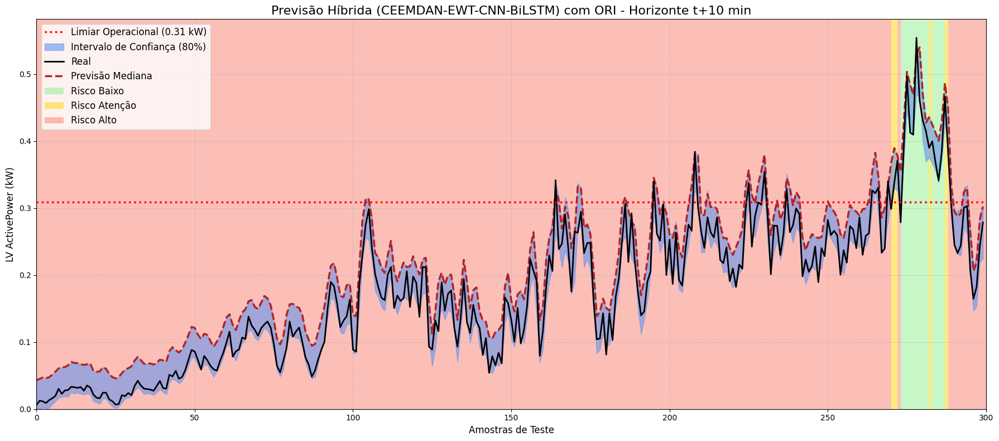

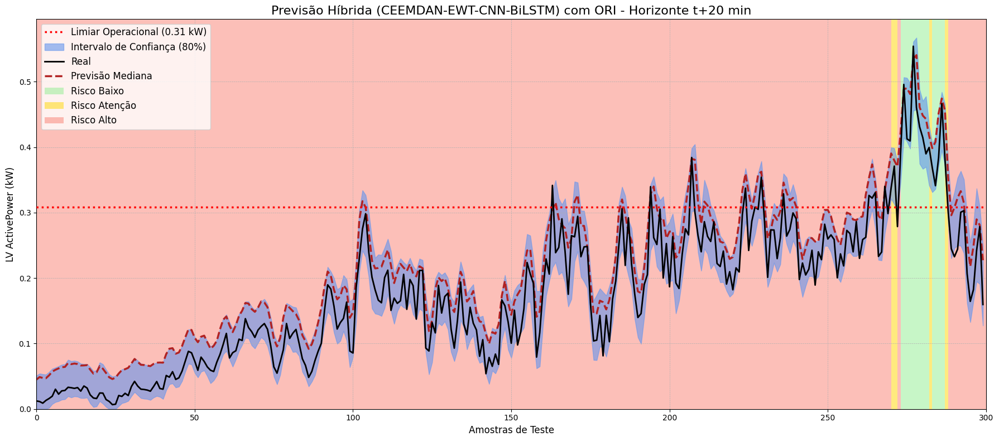

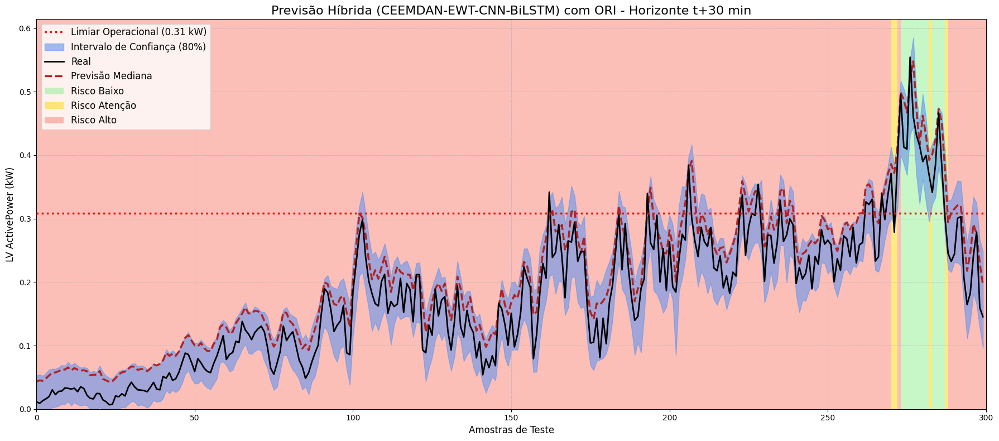

({0.1: array([[0.        , 0.        , 0.        ],
         [0.        , 0.        , 0.        ],
         [0.00204459, 0.        , 0.        ],
         ...,
         [0.7323984 , 0.7298004 , 0.7215564 ],
         [0.7320094 , 0.7267045 , 0.71813035],
         [0.73044384, 0.72828805, 0.7209896 ]], dtype=float32),
  0.5: array([[0.04315683, 0.04500884, 0.04327697],
         [0.04498702, 0.04885557, 0.04512709],
         [0.04713279, 0.04745406, 0.04450822],
         ...,
         [0.8298205 , 0.83122575, 0.8309113 ],
         [0.82919997, 0.82863486, 0.8287877 ],
         [0.8287222 , 0.82981193, 0.83014464]], dtype=float32),
  0.9: array([[0.04315683, 0.05105269, 0.05295709],
         [0.04498702, 0.05416214, 0.05448577],
         [0.04713279, 0.05321726, 0.0521681 ],
         ...,
         [0.84750533, 0.8473321 , 0.8545617 ],
         [0.8477104 , 0.8453639 , 0.85181653],
         [0.8465788 , 0.84657806, 0.85446036]], dtype=float32)},
 array([[0.0060356, 0.0123626, 0.0114462],
  

In [28]:
proposed_method_cnn_bilstm(new_data,i,look_back,data_partition,cap)

In [ ]:
proposed_method_cnn_bilstm_att(new_data,i,look_back,data_partition,cap)

--- EXECUTANDO proposed_method_cnn_bilstm_att EM MODO DE TREINAMENTO ---
Iniciando decomposição do sinal (CEEMDAN + EWT)...
Decomposição concluída e salva.
--- Q0.1 | Treinando CNN-BiLSTM-Attn para: imf_denoised ---
--- Q0.1 | Treinando CNN-BiLSTM-Attn para: imf_1 ---
--- Q0.1 | Treinando CNN-BiLSTM-Attn para: imf_2 ---
--- Q0.1 | Treinando CNN-BiLSTM-Attn para: imf_3 ---
--- Q0.1 | Treinando CNN-BiLSTM-Attn para: imf_4 ---
--- Q0.1 | Treinando CNN-BiLSTM-Attn para: imf_5 ---
--- Q0.1 | Treinando CNN-BiLSTM-Attn para: imf_6 ---
--- Q0.1 | Treinando CNN-BiLSTM-Attn para: imf_7 ---
--- Q0.1 | Treinando CNN-BiLSTM-Attn para: imf_8 ---
--- Q0.1 | Treinando CNN-BiLSTM-Attn para: imf_9 ---
--- Q0.1 | Treinando CNN-BiLSTM-Attn para: imf_10 ---
--- Q0.1 | Treinando CNN-BiLSTM-Attn para: imf_11 ---
--- Q0.1 | Treinando CNN-BiLSTM-Attn para: imf_12 ---
--- Q0.1 | Treinando CNN-BiLSTM-Attn para: imf_13 ---
--- Q0.5 | Treinando CNN-BiLSTM-Attn para: imf_denoised ---
--- Q0.5 | Treinando CNN-BiLSTM

In [ ]:
proposed_method_lstm_optuna(new_data,i,look_back,data_partition,cap)

[I 2025-08-21 13:21:35,917] A new study created in memory with name: no-name-815516be-66ce-4c4f-9aa2-079f1b4c37fa


  0%|          | 0/20 [00:00<?, ?it/s]

[I 2025-08-21 13:58:37,656] Trial 0 finished with value: 2.8265673420150272 and parameters: {'lstm_units': 32, 'dropout': 0.4852650290539918, 'lr': 0.0010676260610853687, 'batch_size': 16}. Best is trial 0 with value: 2.8265673420150272.


In [ ]:
proposed_method_bilstm_optuna(new_data,i,look_back,data_partition,cap)

In [ ]:
proposed_method_bilstm_att_optuna(new_data,i,look_back,data_partition,cap)

In [45]:
proposed_method_cnn_bilstm_att_optuna(new_data,i,look_back,data_partition,cap)

NameError: name 'proposed_method_cnn_bilstm_att_optuna' is not defined

[I 2025-10-27 14:32:55,151] A new study created in memory with name: no-name-f5a3eb31-a12c-49bb-8d59-f5f257c57a36


--- PREPARANDO DADOS PARA OTIMIZAÇÃO E TREINO DO TRANSFORMER ---
Dados preparados: 21006 amostras de treino, 5246 amostras de teste.

--- INICIANDO BUSCA DE HIPERPARÂMETROS PARA TRANSFORMER COM OPTUNA ---


  0%|          | 0/30 [00:00<?, ?it/s]

I0000 00:00:1761575575.686786    2607 gpu_device.cc:2019] Created device /job:localhost/replica:0/task:0/device:GPU:0 with 43629 MB memory:  -> device: 0, name: NVIDIA L40S, pci bus id: 0000:34:00.0, compute capability: 8.9
I0000 00:00:1761575581.460676    3370 service.cc:152] XLA service 0x7f9f8c00b660 initialized for platform CUDA (this does not guarantee that XLA will be used). Devices:
I0000 00:00:1761575581.460810    3370 service.cc:160]   StreamExecutor device (0): NVIDIA L40S, Compute Capability 8.9
2025-10-27 14:33:01.629049: I tensorflow/compiler/mlir/tensorflow/utils/dump_mlir_util.cc:269] disabling MLIR crash reproducer, set env var `MLIR_CRASH_REPRODUCER_DIRECTORY` to enable.
I0000 00:00:1761575582.509631    3370 cuda_dnn.cc:529] Loaded cuDNN version 90701
2025-10-27 14:33:04.251228: I external/local_xla/xla/stream_executor/cuda/subprocess_compilation.cc:346] ptxas warning : Registers are spilled to local memory in function 'gemm_fusion_dot_67', 240 bytes spill stores, 240 

[I 2025-10-27 14:35:45,305] Trial 0 finished with value: 11.009525715949943 and parameters: {'head_size': 64, 'num_heads': 8, 'ff_dim': 8, 'num_transformer_blocks': 3, 'mlp_units': 128, 'dropout': 0.26298677175216084, 'mlp_dropout': 0.29886477003670786, 'learning_rate': 0.0026156348354458036, 'batch_size': 32}. Best is trial 0 with value: 11.009525715949943.


2025-10-27 14:35:52.044432: I external/local_xla/xla/stream_executor/cuda/subprocess_compilation.cc:346] ptxas warning : Registers are spilled to local memory in function 'gemm_fusion_dot_73_0', 140 bytes spill stores, 140 bytes spill loads

2025-10-27 14:35:52.133716: I external/local_xla/xla/stream_executor/cuda/subprocess_compilation.cc:346] ptxas warning : Registers are spilled to local memory in function 'gemm_fusion_dot_73', 452 bytes spill stores, 356 bytes spill loads

2025-10-27 14:35:52.590847: I external/local_xla/xla/stream_executor/cuda/subprocess_compilation.cc:346] ptxas warning : Registers are spilled to local memory in function 'gemm_fusion_dot_73', 428 bytes spill stores, 340 bytes spill loads

2025-10-27 14:35:53.494660: I external/local_xla/xla/stream_executor/cuda/subprocess_compilation.cc:346] ptxas warning : Registers are spilled to local memory in function 'gemm_fusion_dot_23_0', 404 bytes spill stores, 404 bytes spill loads

2025-10-27 14:35:53.541926: I extern

[I 2025-10-27 14:38:27,721] Trial 1 finished with value: 6.976201486537264 and parameters: {'head_size': 128, 'num_heads': 2, 'ff_dim': 8, 'num_transformer_blocks': 3, 'mlp_units': 128, 'dropout': 0.1824635247055018, 'mlp_dropout': 0.10910421102305215, 'learning_rate': 0.0001019698055704366, 'batch_size': 64}. Best is trial 1 with value: 6.976201486537264.


2025-10-27 14:38:35.789315: I external/local_xla/xla/stream_executor/cuda/subprocess_compilation.cc:346] ptxas warning : Registers are spilled to local memory in function 'gemm_fusion_dot_25', 8 bytes spill stores, 8 bytes spill loads

2025-10-27 14:38:36.180813: I external/local_xla/xla/stream_executor/cuda/subprocess_compilation.cc:346] ptxas warning : Registers are spilled to local memory in function 'gemm_fusion_dot_25', 12 bytes spill stores, 12 bytes spill loads

2025-10-27 14:38:45.678494: I external/local_xla/xla/stream_executor/cuda/subprocess_compilation.cc:346] ptxas warning : Registers are spilled to local memory in function 'gemm_fusion_dot_96', 8 bytes spill stores, 8 bytes spill loads

2025-10-27 14:38:53.108204: I external/local_xla/xla/stream_executor/cuda/subprocess_compilation.cc:346] ptxas warning : Registers are spilled to local memory in function 'gemm_fusion_dot_6', 8 bytes spill stores, 8 bytes spill loads

2025-10-27 14:38:55.109399: I external/local_xla/xla/st

[I 2025-10-27 14:41:25,088] Trial 2 finished with value: 6.030078902035793 and parameters: {'head_size': 32, 'num_heads': 2, 'ff_dim': 8, 'num_transformer_blocks': 4, 'mlp_units': 128, 'dropout': 0.24120692980641487, 'mlp_dropout': 0.2602983890774624, 'learning_rate': 0.00044593800841929087, 'batch_size': 32}. Best is trial 2 with value: 6.030078902035793.


2025-10-27 14:41:31.937663: I external/local_xla/xla/stream_executor/cuda/subprocess_compilation.cc:346] ptxas warning : Registers are spilled to local memory in function 'gemm_fusion_dot_67', 452 bytes spill stores, 356 bytes spill loads

2025-10-27 14:41:32.038731: I external/local_xla/xla/stream_executor/cuda/subprocess_compilation.cc:346] ptxas warning : Registers are spilled to local memory in function 'gemm_fusion_dot_67', 240 bytes spill stores, 240 bytes spill loads

2025-10-27 14:41:32.299681: I external/local_xla/xla/stream_executor/cuda/subprocess_compilation.cc:346] ptxas warning : Registers are spilled to local memory in function 'gemm_fusion_dot_67', 236 bytes spill stores, 236 bytes spill loads

2025-10-27 14:41:32.304663: I external/local_xla/xla/stream_executor/cuda/subprocess_compilation.cc:346] ptxas warning : Registers are spilled to local memory in function 'gemm_fusion_dot_67', 556 bytes spill stores, 420 bytes spill loads

2025-10-27 14:41:32.377261: I external/l

[I 2025-10-27 14:45:01,582] Trial 3 finished with value: 6.691901398825304 and parameters: {'head_size': 64, 'num_heads': 8, 'ff_dim': 16, 'num_transformer_blocks': 3, 'mlp_units': 128, 'dropout': 0.137542949617563, 'mlp_dropout': 0.3059528550604258, 'learning_rate': 0.00011314474964846224, 'batch_size': 64}. Best is trial 2 with value: 6.030078902035793.


2025-10-27 14:45:04.920605: I external/local_xla/xla/stream_executor/cuda/subprocess_compilation.cc:346] ptxas warning : Registers are spilled to local memory in function 'gemm_fusion_dot_7', 4 bytes spill stores, 4 bytes spill loads

2025-10-27 14:45:05.044842: I external/local_xla/xla/stream_executor/cuda/subprocess_compilation.cc:346] ptxas warning : Registers are spilled to local memory in function 'gemm_fusion_dot_9', 220 bytes spill stores, 256 bytes spill loads

2025-10-27 14:45:05.045535: I external/local_xla/xla/stream_executor/cuda/subprocess_compilation.cc:346] ptxas warning : Registers are spilled to local memory in function 'gemm_fusion_dot_27', 428 bytes spill stores, 340 bytes spill loads

2025-10-27 14:45:05.969106: I external/local_xla/xla/stream_executor/cuda/subprocess_compilation.cc:346] ptxas warning : Registers are spilled to local memory in function 'gemm_fusion_dot_27', 416 bytes spill stores, 352 bytes spill loads

2025-10-27 14:45:06.157219: I external/local_x

[I 2025-10-27 14:47:27,551] Trial 4 finished with value: 6.036338907673874 and parameters: {'head_size': 32, 'num_heads': 4, 'ff_dim': 16, 'num_transformer_blocks': 1, 'mlp_units': 64, 'dropout': 0.3754773714257066, 'mlp_dropout': 0.1005943004997631, 'learning_rate': 0.0066395961743779715, 'batch_size': 32}. Best is trial 2 with value: 6.030078902035793.


2025-10-27 14:47:30.823276: I external/local_xla/xla/stream_executor/cuda/subprocess_compilation.cc:346] ptxas warning : Registers are spilled to local memory in function 'gemm_fusion_dot_9', 8 bytes spill stores, 8 bytes spill loads

2025-10-27 14:47:30.858135: I external/local_xla/xla/stream_executor/cuda/subprocess_compilation.cc:346] ptxas warning : Registers are spilled to local memory in function 'gemm_fusion_dot_9_0', 900 bytes spill stores, 616 bytes spill loads

2025-10-27 14:47:31.510041: I external/local_xla/xla/stream_executor/cuda/subprocess_compilation.cc:346] ptxas warning : Registers are spilled to local memory in function 'gemm_fusion_dot_9', 44 bytes spill stores, 44 bytes spill loads

2025-10-27 14:47:31.592514: I external/local_xla/xla/stream_executor/cuda/subprocess_compilation.cc:346] ptxas warning : Registers are spilled to local memory in function 'gemm_fusion_dot_9_0', 852 bytes spill stores, 1192 bytes spill loads

2025-10-27 14:47:32.126702: I external/local_

[I 2025-10-27 14:50:05,702] Trial 5 finished with value: 6.221952042609331 and parameters: {'head_size': 128, 'num_heads': 4, 'ff_dim': 16, 'num_transformer_blocks': 1, 'mlp_units': 128, 'dropout': 0.35635167532947065, 'mlp_dropout': 0.14844483492373764, 'learning_rate': 0.00013076431246825769, 'batch_size': 32}. Best is trial 2 with value: 6.030078902035793.


2025-10-27 14:50:14.060616: I external/local_xla/xla/stream_executor/cuda/subprocess_compilation.cc:346] ptxas warning : Registers are spilled to local memory in function 'input_add_multiply_reduce_fusion', 36 bytes spill stores, 28 bytes spill loads

2025-10-27 14:50:48.967027: I external/local_xla/xla/stream_executor/cuda/subprocess_compilation.cc:346] ptxas warning : Registers are spilled to local memory in function 'input_add_multiply_reduce_fusion', 36 bytes spill stores, 28 bytes spill loads

2025-10-27 14:51:29.634947: I external/local_xla/xla/stream_executor/cuda/subprocess_compilation.cc:346] ptxas warning : Registers are spilled to local memory in function 'input_add_multiply_reduce_fusion', 36 bytes spill stores, 28 bytes spill loads



[I 2025-10-27 14:51:57,825] Trial 6 finished with value: 7.548848805333479 and parameters: {'head_size': 128, 'num_heads': 2, 'ff_dim': 8, 'num_transformer_blocks': 2, 'mlp_units': 128, 'dropout': 0.33165039132523666, 'mlp_dropout': 0.13920737996631205, 'learning_rate': 0.002699988774535402, 'batch_size': 64}. Best is trial 2 with value: 6.030078902035793.


2025-10-27 14:52:03.965742: I external/local_xla/xla/stream_executor/cuda/subprocess_compilation.cc:346] ptxas warning : Registers are spilled to local memory in function 'gemm_fusion_dot_19', 12 bytes spill stores, 12 bytes spill loads

2025-10-27 14:52:04.113933: I external/local_xla/xla/stream_executor/cuda/subprocess_compilation.cc:346] ptxas warning : Registers are spilled to local memory in function 'gemm_fusion_dot_19', 4 bytes spill stores, 4 bytes spill loads

2025-10-27 14:52:51.020172: I external/local_xla/xla/stream_executor/cuda/subprocess_compilation.cc:346] ptxas warning : Registers are spilled to local memory in function 'gemm_fusion_dot_19', 4 bytes spill stores, 4 bytes spill loads

2025-10-27 14:53:39.718716: I external/local_xla/xla/stream_executor/cuda/subprocess_compilation.cc:346] ptxas warning : Registers are spilled to local memory in function 'gemm_fusion_dot_19', 4 bytes spill stores, 4 bytes spill loads



[I 2025-10-27 14:54:51,307] Trial 7 finished with value: 6.199339016478805 and parameters: {'head_size': 32, 'num_heads': 4, 'ff_dim': 4, 'num_transformer_blocks': 3, 'mlp_units': 128, 'dropout': 0.12133172929602494, 'mlp_dropout': 0.3390821843577482, 'learning_rate': 0.0003283057022664405, 'batch_size': 32}. Best is trial 2 with value: 6.030078902035793.


2025-10-27 14:54:54.635846: I external/local_xla/xla/stream_executor/cuda/subprocess_compilation.cc:346] ptxas warning : Registers are spilled to local memory in function 'gemm_fusion_dot_7', 12 bytes spill stores, 12 bytes spill loads

2025-10-27 14:54:54.698132: I external/local_xla/xla/stream_executor/cuda/subprocess_compilation.cc:346] ptxas warning : Registers are spilled to local memory in function 'gemm_fusion_dot_27', 428 bytes spill stores, 340 bytes spill loads

2025-10-27 14:54:54.795343: I external/local_xla/xla/stream_executor/cuda/subprocess_compilation.cc:346] ptxas warning : Registers are spilled to local memory in function 'gemm_fusion_dot_27', 424 bytes spill stores, 352 bytes spill loads

2025-10-27 14:54:54.957766: I external/local_xla/xla/stream_executor/cuda/subprocess_compilation.cc:346] ptxas warning : Registers are spilled to local memory in function 'gemm_fusion_dot_9', 40 bytes spill stores, 48 bytes spill loads

2025-10-27 14:54:54.986833: I external/local_x

[I 2025-10-27 14:56:26,664] Trial 8 finished with value: 7.110318524380069 and parameters: {'head_size': 64, 'num_heads': 2, 'ff_dim': 16, 'num_transformer_blocks': 1, 'mlp_units': 64, 'dropout': 0.13669227661235653, 'mlp_dropout': 0.3844209318136681, 'learning_rate': 0.00013938296756231351, 'batch_size': 64}. Best is trial 2 with value: 6.030078902035793.
[I 2025-10-27 14:59:40,772] Trial 9 finished with value: 6.166155027702345 and parameters: {'head_size': 32, 'num_heads': 2, 'ff_dim': 8, 'num_transformer_blocks': 2, 'mlp_units': 128, 'dropout': 0.10404084643772893, 'mlp_dropout': 0.1956505949400462, 'learning_rate': 0.00276717784585136, 'batch_size': 32}. Best is trial 2 with value: 6.030078902035793.


2025-10-27 14:59:48.798521: I external/local_xla/xla/stream_executor/cuda/subprocess_compilation.cc:346] ptxas warning : Registers are spilled to local memory in function 'gemm_fusion_dot_25', 12 bytes spill stores, 12 bytes spill loads

2025-10-27 14:59:49.025007: I external/local_xla/xla/stream_executor/cuda/subprocess_compilation.cc:346] ptxas warning : Registers are spilled to local memory in function 'gemm_fusion_dot_25', 8 bytes spill stores, 8 bytes spill loads



[I 2025-10-27 15:02:42,797] Trial 10 finished with value: 6.284917445515988 and parameters: {'head_size': 32, 'num_heads': 2, 'ff_dim': 4, 'num_transformer_blocks': 4, 'mlp_units': 64, 'dropout': 0.252038977100268, 'mlp_dropout': 0.4897869824494572, 'learning_rate': 0.000658499733301244, 'batch_size': 32}. Best is trial 2 with value: 6.030078902035793.
[I 2025-10-27 15:05:35,299] Trial 11 finished with value: 7.247834681194206 and parameters: {'head_size': 32, 'num_heads': 4, 'ff_dim': 16, 'num_transformer_blocks': 4, 'mlp_units': 64, 'dropout': 0.3923058119365772, 'mlp_dropout': 0.23449166282904432, 'learning_rate': 0.007359669007589928, 'batch_size': 32}. Best is trial 2 with value: 6.030078902035793.


2025-10-27 15:05:38.181991: I external/local_xla/xla/stream_executor/cuda/subprocess_compilation.cc:346] ptxas warning : Registers are spilled to local memory in function 'gemm_fusion_dot_7', 12 bytes spill stores, 12 bytes spill loads

2025-10-27 15:05:38.315384: I external/local_xla/xla/stream_executor/cuda/subprocess_compilation.cc:346] ptxas warning : Registers are spilled to local memory in function 'gemm_fusion_dot_7', 4 bytes spill stores, 4 bytes spill loads

2025-10-27 15:05:45.380894: I external/local_xla/xla/stream_executor/cuda/subprocess_compilation.cc:346] ptxas warning : Registers are spilled to local memory in function 'gemm_fusion_dot_6', 8 bytes spill stores, 8 bytes spill loads

2025-10-27 15:06:08.827213: I external/local_xla/xla/stream_executor/cuda/subprocess_compilation.cc:346] ptxas warning : Registers are spilled to local memory in function 'gemm_fusion_dot_7', 4 bytes spill stores, 4 bytes spill loads

2025-10-27 15:06:43.028155: I external/local_xla/xla/strea

[I 2025-10-27 15:07:16,528] Trial 12 finished with value: 6.485193368279397 and parameters: {'head_size': 32, 'num_heads': 4, 'ff_dim': 8, 'num_transformer_blocks': 1, 'mlp_units': 64, 'dropout': 0.2906299932358933, 'mlp_dropout': 0.22830365382056728, 'learning_rate': 0.009589629903997126, 'batch_size': 32}. Best is trial 2 with value: 6.030078902035793.


2025-10-27 15:08:44.270400: I external/local_xla/xla/stream_executor/cuda/subprocess_compilation.cc:346] ptxas warning : Registers are spilled to local memory in function 'loop_add_subtract_fusion_6', 8 bytes spill stores, 8 bytes spill loads



[I 2025-10-27 15:09:30,712] Trial 13 finished with value: 6.255347032656079 and parameters: {'head_size': 32, 'num_heads': 4, 'ff_dim': 16, 'num_transformer_blocks': 2, 'mlp_units': 64, 'dropout': 0.21236368992349802, 'mlp_dropout': 0.3790287972823663, 'learning_rate': 0.0007693518975358147, 'batch_size': 32}. Best is trial 2 with value: 6.030078902035793.


2025-10-27 15:09:39.383752: I external/local_xla/xla/stream_executor/cuda/subprocess_compilation.cc:346] ptxas warning : Registers are spilled to local memory in function 'gemm_fusion_dot_27', 8 bytes spill stores, 8 bytes spill loads

2025-10-27 15:09:39.576150: I external/local_xla/xla/stream_executor/cuda/subprocess_compilation.cc:346] ptxas warning : Registers are spilled to local memory in function 'gemm_fusion_dot_27_0', 312 bytes spill stores, 312 bytes spill loads

2025-10-27 15:09:39.950504: I external/local_xla/xla/stream_executor/cuda/subprocess_compilation.cc:346] ptxas warning : Registers are spilled to local memory in function 'gemm_fusion_dot_25', 8 bytes spill stores, 8 bytes spill loads

2025-10-27 15:09:39.973757: I external/local_xla/xla/stream_executor/cuda/subprocess_compilation.cc:346] ptxas warning : Registers are spilled to local memory in function 'gemm_fusion_dot_29', 276 bytes spill stores, 244 bytes spill loads

2025-10-27 15:09:40.403526: I external/local_x

[I 2025-10-27 15:13:05,262] Trial 14 finished with value: 6.097991681847119 and parameters: {'head_size': 32, 'num_heads': 8, 'ff_dim': 4, 'num_transformer_blocks': 4, 'mlp_units': 64, 'dropout': 0.30920109391914696, 'mlp_dropout': 0.1741774059596765, 'learning_rate': 0.0003665669820846022, 'batch_size': 32}. Best is trial 2 with value: 6.030078902035793.
[I 2025-10-27 15:16:16,074] Trial 15 finished with value: 5.992232942613078 and parameters: {'head_size': 32, 'num_heads': 2, 'ff_dim': 8, 'num_transformer_blocks': 2, 'mlp_units': 64, 'dropout': 0.21999471633235795, 'mlp_dropout': 0.47188893025246703, 'learning_rate': 0.0014781102713024357, 'batch_size': 32}. Best is trial 15 with value: 5.992232942613078.
[I 2025-10-27 15:19:33,797] Trial 16 finished with value: 6.167658340029797 and parameters: {'head_size': 32, 'num_heads': 2, 'ff_dim': 8, 'num_transformer_blocks': 2, 'mlp_units': 64, 'dropout': 0.19037319248293544, 'mlp_dropout': 0.49225788390301417, 'learning_rate': 0.0012062741

2025-10-27 15:23:33.908368: I external/local_xla/xla/stream_executor/cuda/subprocess_compilation.cc:346] ptxas warning : Registers are spilled to local memory in function 'gemm_fusion_dot_19', 12 bytes spill stores, 12 bytes spill loads

2025-10-27 15:23:33.937467: I external/local_xla/xla/stream_executor/cuda/subprocess_compilation.cc:346] ptxas warning : Registers are spilled to local memory in function 'gemm_fusion_dot_19', 4 bytes spill stores, 4 bytes spill loads

2025-10-27 15:23:38.470668: I external/local_xla/xla/stream_executor/cuda/subprocess_compilation.cc:346] ptxas warning : Registers are spilled to local memory in function 'input_add_multiply_reduce_fusion_2', 36 bytes spill stores, 28 bytes spill loads
ptxas warning : Registers are spilled to local memory in function 'input_add_multiply_reduce_fusion', 12 bytes spill stores, 8 bytes spill loads

2025-10-27 15:24:15.247888: I external/local_xla/xla/stream_executor/cuda/subprocess_compilation.cc:346] ptxas warning : Regist

[I 2025-10-27 15:25:24,441] Trial 18 finished with value: 7.0008996206050185 and parameters: {'head_size': 64, 'num_heads': 2, 'ff_dim': 8, 'num_transformer_blocks': 3, 'mlp_units': 64, 'dropout': 0.22841155403470048, 'mlp_dropout': 0.41110100125750965, 'learning_rate': 0.00035972930542070775, 'batch_size': 64}. Best is trial 15 with value: 5.992232942613078.


2025-10-27 15:25:28.943364: I external/local_xla/xla/stream_executor/cuda/subprocess_compilation.cc:346] ptxas warning : Registers are spilled to local memory in function 'gemm_fusion_dot_13', 8 bytes spill stores, 8 bytes spill loads

2025-10-27 15:25:29.403728: I external/local_xla/xla/stream_executor/cuda/subprocess_compilation.cc:346] ptxas warning : Registers are spilled to local memory in function 'gemm_fusion_dot_15', 8 bytes spill stores, 8 bytes spill loads

2025-10-27 15:25:30.278220: I external/local_xla/xla/stream_executor/cuda/subprocess_compilation.cc:346] ptxas warning : Registers are spilled to local memory in function 'gemm_fusion_dot_15', 44 bytes spill stores, 44 bytes spill loads

2025-10-27 15:25:30.360864: I external/local_xla/xla/stream_executor/cuda/subprocess_compilation.cc:346] ptxas warning : Registers are spilled to local memory in function 'gemm_fusion_dot_17_0', 404 bytes spill stores, 404 bytes spill loads

2025-10-27 15:25:30.437312: I external/local_xla

[I 2025-10-27 15:27:55,219] Trial 19 finished with value: 6.594432066577448 and parameters: {'head_size': 128, 'num_heads': 2, 'ff_dim': 8, 'num_transformer_blocks': 2, 'mlp_units': 128, 'dropout': 0.1650533416001197, 'mlp_dropout': 0.27043358331888834, 'learning_rate': 0.00022776894343196544, 'batch_size': 32}. Best is trial 15 with value: 5.992232942613078.
[I 2025-10-27 15:33:02,556] Trial 20 finished with value: 6.115588120124685 and parameters: {'head_size': 32, 'num_heads': 2, 'ff_dim': 8, 'num_transformer_blocks': 4, 'mlp_units': 64, 'dropout': 0.27338246386478393, 'mlp_dropout': 0.34234238736546646, 'learning_rate': 0.0017002500089533955, 'batch_size': 32}. Best is trial 15 with value: 5.992232942613078.


2025-10-27 15:34:36.452664: I external/local_xla/xla/stream_executor/cuda/subprocess_compilation.cc:346] ptxas warning : Registers are spilled to local memory in function 'input_add_multiply_reduce_fusion', 12 bytes spill stores, 12 bytes spill loads



[I 2025-10-27 15:35:30,480] Trial 21 finished with value: 6.346173987720978 and parameters: {'head_size': 32, 'num_heads': 4, 'ff_dim': 16, 'num_transformer_blocks': 1, 'mlp_units': 64, 'dropout': 0.234496978988366, 'mlp_dropout': 0.10627310574540766, 'learning_rate': 0.005215504853986797, 'batch_size': 32}. Best is trial 15 with value: 5.992232942613078.


2025-10-27 15:36:36.423523: I external/local_xla/xla/stream_executor/cuda/subprocess_compilation.cc:346] ptxas warning : Registers are spilled to local memory in function 'input_add_multiply_reduce_fusion', 12 bytes spill stores, 12 bytes spill loads



[I 2025-10-27 15:38:02,621] Trial 22 finished with value: 5.919048461139631 and parameters: {'head_size': 32, 'num_heads': 4, 'ff_dim': 16, 'num_transformer_blocks': 1, 'mlp_units': 64, 'dropout': 0.3743992732647771, 'mlp_dropout': 0.4392687065771505, 'learning_rate': 0.000634654116306671, 'batch_size': 32}. Best is trial 22 with value: 5.919048461139631.
[I 2025-10-27 15:41:09,219] Trial 23 finished with value: 6.327617378194223 and parameters: {'head_size': 32, 'num_heads': 8, 'ff_dim': 4, 'num_transformer_blocks': 2, 'mlp_units': 64, 'dropout': 0.3242181960897811, 'mlp_dropout': 0.4302683865118803, 'learning_rate': 0.0006318435443843439, 'batch_size': 32}. Best is trial 22 with value: 5.919048461139631.
[I 2025-10-27 15:43:32,461] Trial 24 finished with value: 6.7636415235881095 and parameters: {'head_size': 32, 'num_heads': 2, 'ff_dim': 8, 'num_transformer_blocks': 1, 'mlp_units': 64, 'dropout': 0.28980136903894255, 'mlp_dropout': 0.4596216552629469, 'learning_rate': 0.000471238823

2025-10-27 15:45:07.594243: I external/local_xla/xla/stream_executor/cuda/subprocess_compilation.cc:346] ptxas warning : Registers are spilled to local memory in function 'loop_add_subtract_fusion_6', 8 bytes spill stores, 8 bytes spill loads



[I 2025-10-27 15:46:15,817] Trial 25 finished with value: 6.034921935914137 and parameters: {'head_size': 32, 'num_heads': 4, 'ff_dim': 16, 'num_transformer_blocks': 2, 'mlp_units': 64, 'dropout': 0.23312681114833275, 'mlp_dropout': 0.40261143470207705, 'learning_rate': 0.0010280531286227272, 'batch_size': 32}. Best is trial 22 with value: 5.919048461139631.


2025-10-27 15:46:22.310646: I external/local_xla/xla/stream_executor/cuda/subprocess_compilation.cc:346] ptxas warning : Registers are spilled to local memory in function 'gemm_fusion_dot_19', 12 bytes spill stores, 12 bytes spill loads

2025-10-27 15:46:23.108330: I external/local_xla/xla/stream_executor/cuda/subprocess_compilation.cc:346] ptxas warning : Registers are spilled to local memory in function 'gemm_fusion_dot_19', 8 bytes spill stores, 8 bytes spill loads



[I 2025-10-27 15:48:38,242] Trial 26 finished with value: 6.547221230243349 and parameters: {'head_size': 32, 'num_heads': 2, 'ff_dim': 8, 'num_transformer_blocks': 3, 'mlp_units': 128, 'dropout': 0.17948892398770122, 'mlp_dropout': 0.3536723984114033, 'learning_rate': 0.0002506293819545874, 'batch_size': 64}. Best is trial 22 with value: 5.919048461139631.
[I 2025-10-27 15:51:22,610] Trial 27 finished with value: 6.249469334403787 and parameters: {'head_size': 32, 'num_heads': 2, 'ff_dim': 4, 'num_transformer_blocks': 1, 'mlp_units': 64, 'dropout': 0.2848524311545299, 'mlp_dropout': 0.4614247411600639, 'learning_rate': 0.0016352798658747655, 'batch_size': 32}. Best is trial 22 with value: 5.919048461139631.


2025-10-27 15:51:27.731813: I external/local_xla/xla/stream_executor/cuda/subprocess_compilation.cc:346] ptxas warning : Registers are spilled to local memory in function 'gemm_fusion_dot_46', 572 bytes spill stores, 572 bytes spill loads

2025-10-27 15:51:27.738466: I external/local_xla/xla/stream_executor/cuda/subprocess_compilation.cc:346] ptxas warning : Registers are spilled to local memory in function 'gemm_fusion_dot_46', 184 bytes spill stores, 528 bytes spill loads

2025-10-27 15:51:27.764443: I external/local_xla/xla/stream_executor/cuda/subprocess_compilation.cc:346] ptxas warning : Registers are spilled to local memory in function 'gemm_fusion_dot_46', 348 bytes spill stores, 348 bytes spill loads

2025-10-27 15:51:27.943414: I external/local_xla/xla/stream_executor/cuda/subprocess_compilation.cc:346] ptxas warning : Registers are spilled to local memory in function 'gemm_fusion_dot_13', 56 bytes spill stores, 56 bytes spill loads

2025-10-27 15:51:27.980488: I external/loc

[I 2025-10-27 15:55:55,280] Trial 28 finished with value: 6.574156207230399 and parameters: {'head_size': 128, 'num_heads': 8, 'ff_dim': 8, 'num_transformer_blocks': 2, 'mlp_units': 128, 'dropout': 0.353066350761489, 'mlp_dropout': 0.24672194082870502, 'learning_rate': 0.0008588096552323338, 'batch_size': 32}. Best is trial 22 with value: 5.919048461139631.


2025-10-27 15:56:01.858979: I external/local_xla/xla/stream_executor/cuda/subprocess_compilation.cc:346] ptxas warning : Registers are spilled to local memory in function 'gemm_fusion_dot_21', 44 bytes spill stores, 44 bytes spill loads

2025-10-27 15:56:02.133780: I external/local_xla/xla/stream_executor/cuda/subprocess_compilation.cc:346] ptxas warning : Registers are spilled to local memory in function 'gemm_fusion_dot_21_0', 312 bytes spill stores, 312 bytes spill loads

2025-10-27 15:56:02.235562: I external/local_xla/xla/stream_executor/cuda/subprocess_compilation.cc:346] ptxas warning : Registers are spilled to local memory in function 'gemm_fusion_dot_21', 8 bytes spill stores, 8 bytes spill loads

2025-10-27 15:56:03.322713: I external/local_xla/xla/stream_executor/cuda/subprocess_compilation.cc:346] ptxas warning : Registers are spilled to local memory in function 'gemm_fusion_dot_23_0', 304 bytes spill stores, 304 bytes spill loads

2025-10-27 15:56:03.540723: I external/loc

[I 2025-10-27 15:59:11,764] Trial 29 finished with value: 6.717451764233424 and parameters: {'head_size': 64, 'num_heads': 4, 'ff_dim': 16, 'num_transformer_blocks': 3, 'mlp_units': 128, 'dropout': 0.2546647617190735, 'mlp_dropout': 0.3017600493815518, 'learning_rate': 0.002083863265772016, 'batch_size': 32}. Best is trial 22 with value: 5.919048461139631.

OTIMIZAÇÃO DO TRANSFORMER CONCLUÍDA
Melhor resultado (MAPE médio na validação): 5.9190%

Hiperparâmetros Ótimos Encontrados:
  - head_size: 32
  - num_heads: 4
  - ff_dim: 16
  - num_transformer_blocks: 1
  - mlp_units: 64
  - dropout: 0.3743992732647771
  - mlp_dropout: 0.4392687065771505
  - learning_rate: 0.000634654116306671
  - batch_size: 32

--- TREINANDO MODELO TRANSFORMER FINAL COM OS MELHORES PARÂMETROS ---


2025-10-27 15:59:19.072115: I external/local_xla/xla/stream_executor/cuda/subprocess_compilation.cc:346] ptxas warning : Registers are spilled to local memory in function 'gemm_fusion_dot_9', 8 bytes spill stores, 8 bytes spill loads



Epoch 81: early stopping
Restoring model weights from the end of the best epoch: 61.
Treinamento final concluído.


2025-10-27 16:00:48.662751: I external/local_xla/xla/stream_executor/cuda/subprocess_compilation.cc:346] ptxas warning : Registers are spilled to local memory in function 'gemm_fusion_dot_6', 8 bytes spill stores, 8 bytes spill loads

2025-10-27 16:00:49.180872: I external/local_xla/xla/stream_executor/cuda/subprocess_compilation.cc:346] ptxas warning : Registers are spilled to local memory in function 'gemm_fusion_dot_10', 428 bytes spill stores, 340 bytes spill loads

2025-10-27 16:00:49.642480: I external/local_xla/xla/stream_executor/cuda/subprocess_compilation.cc:346] ptxas warning : Registers are spilled to local memory in function 'gemm_fusion_dot_10', 416 bytes spill stores, 352 bytes spill loads




===== MÉTRICAS FINAIS NO CONJUNTO DE TESTE =====
Horizonte t+10: MAPE=5.0568%, RMSE=0.0834, MAE=0.0521, R²=0.9313
Horizonte t+20: MAPE=6.5846%, RMSE=0.1106, MAE=0.0678, R²=0.8789
Horizonte t+30: MAPE=7.5379%, RMSE=0.1242, MAE=0.0776, R²=0.8473

--- GERANDO GRÁFICOS DE RESULTADOS ---


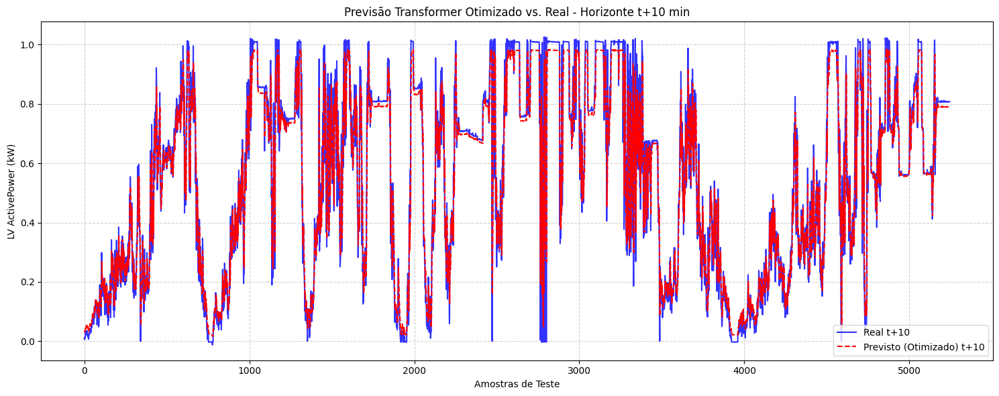

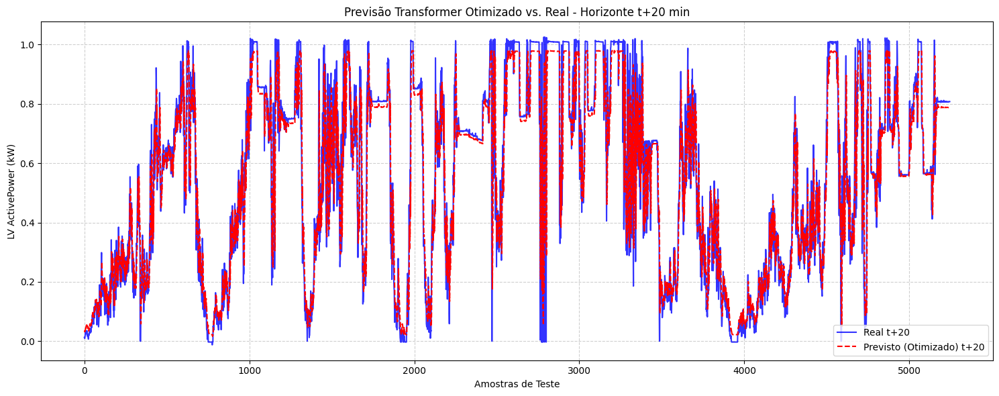

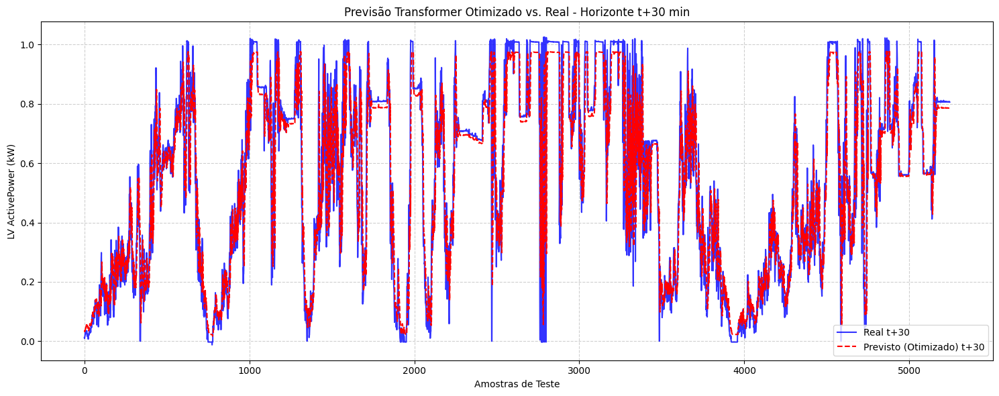

(<Functional name=functional, built=True>,
 {'head_size': 32,
  'num_heads': 4,
  'ff_dim': 16,
  'num_transformer_blocks': 1,
  'mlp_units': 64,
  'dropout': 0.3743992732647771,
  'mlp_dropout': 0.4392687065771505,
  'learning_rate': 0.000634654116306671,
  'batch_size': 32},
   Horizonte  MAPE (%)  RMSE (MW)  MAE (MW)        R²
 0  t+10 min  5.056755   0.083374  0.052064  0.931267
 1  t+20 min  6.584557   0.110620  0.067795  0.878949
 2  t+30 min  7.537878   0.124222  0.077610  0.847285)

In [12]:
transformer_model_with_optuna(new_data,i,look_back,data_partition,cap)

[I 2025-10-27 21:18:36,410] A new study created in memory with name: no-name-0aa1577d-085d-4b25-9f92-25f9b6bb3e7f


--- PREPARANDO DADOS PARA OTIMIZAÇÃO E TREINO DO TFT ---
Dados preparados: 21006 amostras de treino, 5246 amostras de teste.

--- INICIANDO BUSCA DE HIPERPARÂMETROS PARA TFT COM OPTUNA ---


  0%|          | 0/30 [00:00<?, ?it/s]

/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/layer.py:421: UserWarning: `build()` was called on layer 'gated_residual_network_4', however the layer does not have a `build()` method implemented and it looks like it has unbuilt state. This will cause the layer to be marked as built, despite not being actually built, which may cause failures down the line. Make sure to implement a proper `build()` method.
  warnings.warn(
/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/layer.py:421: UserWarning: `build()` was called on layer 'gated_residual_network_5', however the layer does not have a `build()` method implemented and it looks like it has unbuilt state. This will cause the layer to be marked as built, despite not being actually built, which may cause failures down the line. Make sure to implement a proper `build()` method.
  warnings.warn(
/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src

[I 2025-10-27 21:21:19,244] Trial 0 finished with value: 6.734675221613345 and parameters: {'hidden_units': 32, 'dropout_rate': 0.23207510443607957, 'num_heads': 4, 'learning_rate': 0.0011263895580138539, 'batch_size': 64}. Best is trial 0 with value: 6.734675221613345.


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/layer.py:421: UserWarning: `build()` was called on layer 'gated_residual_network_1', however the layer does not have a `build()` method implemented and it looks like it has unbuilt state. This will cause the layer to be marked as built, despite not being actually built, which may cause failures down the line. Make sure to implement a proper `build()` method.
  warnings.warn(
/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/layer.py:421: UserWarning: `build()` was called on layer 'gated_residual_network_2', however the layer does not have a `build()` method implemented and it looks like it has unbuilt state. This will cause the layer to be marked as built, despite not being actually built, which may cause failures down the line. Make sure to implement a proper `build()` method.
  warnings.warn(
2025-10-27 21:21:28.118439: I external/local_xla/xla/stream_executor/cuda/su

[I 2025-10-27 21:23:13,795] Trial 1 finished with value: 14.604389943709473 and parameters: {'hidden_units': 128, 'dropout_rate': 0.2244904771242428, 'num_heads': 4, 'learning_rate': 0.004516405598005801, 'batch_size': 64}. Best is trial 0 with value: 6.734675221613345.


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/layer.py:421: UserWarning: `build()` was called on layer 'gated_residual_network_1', however the layer does not have a `build()` method implemented and it looks like it has unbuilt state. This will cause the layer to be marked as built, despite not being actually built, which may cause failures down the line. Make sure to implement a proper `build()` method.
  warnings.warn(
/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/layer.py:421: UserWarning: `build()` was called on layer 'gated_residual_network_2', however the layer does not have a `build()` method implemented and it looks like it has unbuilt state. This will cause the layer to be marked as built, despite not being actually built, which may cause failures down the line. Make sure to implement a proper `build()` method.
  warnings.warn(
2025-10-27 21:23:19.524605: I external/local_xla/xla/stream_executor/cuda/su

[I 2025-10-27 21:24:58,525] Trial 2 finished with value: 18.15489657299562 and parameters: {'hidden_units': 64, 'dropout_rate': 0.28124453861326276, 'num_heads': 2, 'learning_rate': 0.006351941781828519, 'batch_size': 64}. Best is trial 0 with value: 6.734675221613345.


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/layer.py:421: UserWarning: `build()` was called on layer 'gated_residual_network_1', however the layer does not have a `build()` method implemented and it looks like it has unbuilt state. This will cause the layer to be marked as built, despite not being actually built, which may cause failures down the line. Make sure to implement a proper `build()` method.
  warnings.warn(
/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/layer.py:421: UserWarning: `build()` was called on layer 'gated_residual_network_2', however the layer does not have a `build()` method implemented and it looks like it has unbuilt state. This will cause the layer to be marked as built, despite not being actually built, which may cause failures down the line. Make sure to implement a proper `build()` method.
  warnings.warn(
/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src

[I 2025-10-27 21:27:56,051] Trial 3 finished with value: 6.733780183538279 and parameters: {'hidden_units': 32, 'dropout_rate': 0.20483443114169167, 'num_heads': 8, 'learning_rate': 0.00037028097481192954, 'batch_size': 64}. Best is trial 3 with value: 6.733780183538279.


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/layer.py:421: UserWarning: `build()` was called on layer 'gated_residual_network_1', however the layer does not have a `build()` method implemented and it looks like it has unbuilt state. This will cause the layer to be marked as built, despite not being actually built, which may cause failures down the line. Make sure to implement a proper `build()` method.
  warnings.warn(
/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/layer.py:421: UserWarning: `build()` was called on layer 'gated_residual_network_2', however the layer does not have a `build()` method implemented and it looks like it has unbuilt state. This will cause the layer to be marked as built, despite not being actually built, which may cause failures down the line. Make sure to implement a proper `build()` method.
  warnings.warn(
/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src

[I 2025-10-27 21:30:02,907] Trial 4 finished with value: 17.764883288485677 and parameters: {'hidden_units': 32, 'dropout_rate': 0.2448622068749389, 'num_heads': 2, 'learning_rate': 0.0086926939515969, 'batch_size': 32}. Best is trial 3 with value: 6.733780183538279.


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/layer.py:421: UserWarning: `build()` was called on layer 'gated_residual_network_1', however the layer does not have a `build()` method implemented and it looks like it has unbuilt state. This will cause the layer to be marked as built, despite not being actually built, which may cause failures down the line. Make sure to implement a proper `build()` method.
  warnings.warn(
/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/layer.py:421: UserWarning: `build()` was called on layer 'gated_residual_network_2', however the layer does not have a `build()` method implemented and it looks like it has unbuilt state. This will cause the layer to be marked as built, despite not being actually built, which may cause failures down the line. Make sure to implement a proper `build()` method.
  warnings.warn(
/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src

[I 2025-10-27 21:34:14,683] Trial 5 finished with value: 6.246307345894938 and parameters: {'hidden_units': 64, 'dropout_rate': 0.38986078965596593, 'num_heads': 8, 'learning_rate': 0.0016416747270927943, 'batch_size': 32}. Best is trial 5 with value: 6.246307345894938.


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/layer.py:421: UserWarning: `build()` was called on layer 'gated_residual_network_1', however the layer does not have a `build()` method implemented and it looks like it has unbuilt state. This will cause the layer to be marked as built, despite not being actually built, which may cause failures down the line. Make sure to implement a proper `build()` method.
  warnings.warn(
/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/layer.py:421: UserWarning: `build()` was called on layer 'gated_residual_network_2', however the layer does not have a `build()` method implemented and it looks like it has unbuilt state. This will cause the layer to be marked as built, despite not being actually built, which may cause failures down the line. Make sure to implement a proper `build()` method.
  warnings.warn(
/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src

[I 2025-10-27 21:38:56,903] Trial 6 finished with value: 6.4962041997643825 and parameters: {'hidden_units': 64, 'dropout_rate': 0.22131443444290372, 'num_heads': 4, 'learning_rate': 0.00012631085347669302, 'batch_size': 64}. Best is trial 5 with value: 6.246307345894938.


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/layer.py:421: UserWarning: `build()` was called on layer 'gated_residual_network_1', however the layer does not have a `build()` method implemented and it looks like it has unbuilt state. This will cause the layer to be marked as built, despite not being actually built, which may cause failures down the line. Make sure to implement a proper `build()` method.
  warnings.warn(
/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/layer.py:421: UserWarning: `build()` was called on layer 'gated_residual_network_2', however the layer does not have a `build()` method implemented and it looks like it has unbuilt state. This will cause the layer to be marked as built, despite not being actually built, which may cause failures down the line. Make sure to implement a proper `build()` method.
  warnings.warn(
/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src

[I 2025-10-27 21:44:40,514] Trial 7 finished with value: 6.250280863122765 and parameters: {'hidden_units': 64, 'dropout_rate': 0.3309095570206178, 'num_heads': 8, 'learning_rate': 0.00014306206739400298, 'batch_size': 32}. Best is trial 5 with value: 6.246307345894938.


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/layer.py:421: UserWarning: `build()` was called on layer 'gated_residual_network_1', however the layer does not have a `build()` method implemented and it looks like it has unbuilt state. This will cause the layer to be marked as built, despite not being actually built, which may cause failures down the line. Make sure to implement a proper `build()` method.
  warnings.warn(
/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/layer.py:421: UserWarning: `build()` was called on layer 'gated_residual_network_2', however the layer does not have a `build()` method implemented and it looks like it has unbuilt state. This will cause the layer to be marked as built, despite not being actually built, which may cause failures down the line. Make sure to implement a proper `build()` method.
  warnings.warn(
/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src

[I 2025-10-27 21:46:31,956] Trial 8 finished with value: 14.57574838911286 and parameters: {'hidden_units': 64, 'dropout_rate': 0.20148069549941067, 'num_heads': 2, 'learning_rate': 0.005184212326026402, 'batch_size': 64}. Best is trial 5 with value: 6.246307345894938.


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/layer.py:421: UserWarning: `build()` was called on layer 'gated_residual_network_1', however the layer does not have a `build()` method implemented and it looks like it has unbuilt state. This will cause the layer to be marked as built, despite not being actually built, which may cause failures down the line. Make sure to implement a proper `build()` method.
  warnings.warn(
/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/layer.py:421: UserWarning: `build()` was called on layer 'gated_residual_network_2', however the layer does not have a `build()` method implemented and it looks like it has unbuilt state. This will cause the layer to be marked as built, despite not being actually built, which may cause failures down the line. Make sure to implement a proper `build()` method.
  warnings.warn(
/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src

[I 2025-10-27 21:50:56,382] Trial 9 finished with value: 6.284584615377649 and parameters: {'hidden_units': 32, 'dropout_rate': 0.2540596583840541, 'num_heads': 8, 'learning_rate': 0.00045440836735217944, 'batch_size': 32}. Best is trial 5 with value: 6.246307345894938.


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/layer.py:421: UserWarning: `build()` was called on layer 'gated_residual_network_1', however the layer does not have a `build()` method implemented and it looks like it has unbuilt state. This will cause the layer to be marked as built, despite not being actually built, which may cause failures down the line. Make sure to implement a proper `build()` method.
  warnings.warn(
/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/layer.py:421: UserWarning: `build()` was called on layer 'gated_residual_network_2', however the layer does not have a `build()` method implemented and it looks like it has unbuilt state. This will cause the layer to be marked as built, despite not being actually built, which may cause failures down the line. Make sure to implement a proper `build()` method.
  warnings.warn(
2025-10-27 21:51:01.912758: I external/local_xla/xla/stream_executor/cuda/su

[I 2025-10-27 21:54:02,204] Trial 10 finished with value: 14.126684429179425 and parameters: {'hidden_units': 128, 'dropout_rate': 0.3948206405542748, 'num_heads': 8, 'learning_rate': 0.001566704705756937, 'batch_size': 32}. Best is trial 5 with value: 6.246307345894938.


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/layer.py:421: UserWarning: `build()` was called on layer 'gated_residual_network_1', however the layer does not have a `build()` method implemented and it looks like it has unbuilt state. This will cause the layer to be marked as built, despite not being actually built, which may cause failures down the line. Make sure to implement a proper `build()` method.
  warnings.warn(
/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/layer.py:421: UserWarning: `build()` was called on layer 'gated_residual_network_2', however the layer does not have a `build()` method implemented and it looks like it has unbuilt state. This will cause the layer to be marked as built, despite not being actually built, which may cause failures down the line. Make sure to implement a proper `build()` method.
  warnings.warn(
/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src

[I 2025-10-27 22:01:06,020] Trial 11 finished with value: 6.341514515717807 and parameters: {'hidden_units': 64, 'dropout_rate': 0.39116859671396376, 'num_heads': 8, 'learning_rate': 0.00010303947953529216, 'batch_size': 32}. Best is trial 5 with value: 6.246307345894938.


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/layer.py:421: UserWarning: `build()` was called on layer 'gated_residual_network_1', however the layer does not have a `build()` method implemented and it looks like it has unbuilt state. This will cause the layer to be marked as built, despite not being actually built, which may cause failures down the line. Make sure to implement a proper `build()` method.
  warnings.warn(
/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/layer.py:421: UserWarning: `build()` was called on layer 'gated_residual_network_2', however the layer does not have a `build()` method implemented and it looks like it has unbuilt state. This will cause the layer to be marked as built, despite not being actually built, which may cause failures down the line. Make sure to implement a proper `build()` method.
  warnings.warn(
/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src

[I 2025-10-27 22:04:46,891] Trial 12 finished with value: 6.6181994933786426 and parameters: {'hidden_units': 64, 'dropout_rate': 0.33212470458067395, 'num_heads': 8, 'learning_rate': 0.0022481883053187294, 'batch_size': 32}. Best is trial 5 with value: 6.246307345894938.


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/layer.py:421: UserWarning: `build()` was called on layer 'gated_residual_network_1', however the layer does not have a `build()` method implemented and it looks like it has unbuilt state. This will cause the layer to be marked as built, despite not being actually built, which may cause failures down the line. Make sure to implement a proper `build()` method.
  warnings.warn(
/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/layer.py:421: UserWarning: `build()` was called on layer 'gated_residual_network_2', however the layer does not have a `build()` method implemented and it looks like it has unbuilt state. This will cause the layer to be marked as built, despite not being actually built, which may cause failures down the line. Make sure to implement a proper `build()` method.
  warnings.warn(
/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src

[I 2025-10-27 22:08:52,395] Trial 13 finished with value: 6.445060024844463 and parameters: {'hidden_units': 64, 'dropout_rate': 0.11975400972608957, 'num_heads': 8, 'learning_rate': 0.00043394761024587923, 'batch_size': 32}. Best is trial 5 with value: 6.246307345894938.


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/layer.py:421: UserWarning: `build()` was called on layer 'gated_residual_network_1', however the layer does not have a `build()` method implemented and it looks like it has unbuilt state. This will cause the layer to be marked as built, despite not being actually built, which may cause failures down the line. Make sure to implement a proper `build()` method.
  warnings.warn(
/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/layer.py:421: UserWarning: `build()` was called on layer 'gated_residual_network_2', however the layer does not have a `build()` method implemented and it looks like it has unbuilt state. This will cause the layer to be marked as built, despite not being actually built, which may cause failures down the line. Make sure to implement a proper `build()` method.
  warnings.warn(
/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src

[I 2025-10-27 22:12:48,005] Trial 14 finished with value: 6.294519139116889 and parameters: {'hidden_units': 64, 'dropout_rate': 0.3349259132770864, 'num_heads': 8, 'learning_rate': 0.00023731090238879408, 'batch_size': 32}. Best is trial 5 with value: 6.246307345894938.


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/layer.py:421: UserWarning: `build()` was called on layer 'gated_residual_network_1', however the layer does not have a `build()` method implemented and it looks like it has unbuilt state. This will cause the layer to be marked as built, despite not being actually built, which may cause failures down the line. Make sure to implement a proper `build()` method.
  warnings.warn(
/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/layer.py:421: UserWarning: `build()` was called on layer 'gated_residual_network_2', however the layer does not have a `build()` method implemented and it looks like it has unbuilt state. This will cause the layer to be marked as built, despite not being actually built, which may cause failures down the line. Make sure to implement a proper `build()` method.
  warnings.warn(
/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src

[I 2025-10-27 22:16:11,628] Trial 15 finished with value: 10.582380813692167 and parameters: {'hidden_units': 64, 'dropout_rate': 0.34616677802417256, 'num_heads': 8, 'learning_rate': 0.002552659560236827, 'batch_size': 32}. Best is trial 5 with value: 6.246307345894938.


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/layer.py:421: UserWarning: `build()` was called on layer 'gated_residual_network_1', however the layer does not have a `build()` method implemented and it looks like it has unbuilt state. This will cause the layer to be marked as built, despite not being actually built, which may cause failures down the line. Make sure to implement a proper `build()` method.
  warnings.warn(
/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/layer.py:421: UserWarning: `build()` was called on layer 'gated_residual_network_2', however the layer does not have a `build()` method implemented and it looks like it has unbuilt state. This will cause the layer to be marked as built, despite not being actually built, which may cause failures down the line. Make sure to implement a proper `build()` method.
  warnings.warn(
/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src

[I 2025-10-27 22:20:46,882] Trial 16 finished with value: 6.22002115061769 and parameters: {'hidden_units': 128, 'dropout_rate': 0.2936485590427042, 'num_heads': 8, 'learning_rate': 0.0006840175004337466, 'batch_size': 32}. Best is trial 16 with value: 6.22002115061769.


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/layer.py:421: UserWarning: `build()` was called on layer 'gated_residual_network_1', however the layer does not have a `build()` method implemented and it looks like it has unbuilt state. This will cause the layer to be marked as built, despite not being actually built, which may cause failures down the line. Make sure to implement a proper `build()` method.
  warnings.warn(
/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/layer.py:421: UserWarning: `build()` was called on layer 'gated_residual_network_2', however the layer does not have a `build()` method implemented and it looks like it has unbuilt state. This will cause the layer to be marked as built, despite not being actually built, which may cause failures down the line. Make sure to implement a proper `build()` method.
  warnings.warn(
/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src

[I 2025-10-27 22:25:29,876] Trial 17 finished with value: 6.374380658618063 and parameters: {'hidden_units': 128, 'dropout_rate': 0.14875926033999723, 'num_heads': 8, 'learning_rate': 0.0008811051002193639, 'batch_size': 32}. Best is trial 16 with value: 6.22002115061769.


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/layer.py:421: UserWarning: `build()` was called on layer 'gated_residual_network_1', however the layer does not have a `build()` method implemented and it looks like it has unbuilt state. This will cause the layer to be marked as built, despite not being actually built, which may cause failures down the line. Make sure to implement a proper `build()` method.
  warnings.warn(
/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/layer.py:421: UserWarning: `build()` was called on layer 'gated_residual_network_2', however the layer does not have a `build()` method implemented and it looks like it has unbuilt state. This will cause the layer to be marked as built, despite not being actually built, which may cause failures down the line. Make sure to implement a proper `build()` method.
  warnings.warn(
/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src

[I 2025-10-27 22:30:12,544] Trial 18 finished with value: 6.205526960855127 and parameters: {'hidden_units': 128, 'dropout_rate': 0.2936574293060651, 'num_heads': 4, 'learning_rate': 0.0009781659280415217, 'batch_size': 32}. Best is trial 18 with value: 6.205526960855127.


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/layer.py:421: UserWarning: `build()` was called on layer 'gated_residual_network_1', however the layer does not have a `build()` method implemented and it looks like it has unbuilt state. This will cause the layer to be marked as built, despite not being actually built, which may cause failures down the line. Make sure to implement a proper `build()` method.
  warnings.warn(
/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/layer.py:421: UserWarning: `build()` was called on layer 'gated_residual_network_2', however the layer does not have a `build()` method implemented and it looks like it has unbuilt state. This will cause the layer to be marked as built, despite not being actually built, which may cause failures down the line. Make sure to implement a proper `build()` method.
  warnings.warn(
/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src

[I 2025-10-27 22:35:27,094] Trial 19 finished with value: 6.199368378353461 and parameters: {'hidden_units': 128, 'dropout_rate': 0.28961796649204674, 'num_heads': 4, 'learning_rate': 0.0007802553471258404, 'batch_size': 32}. Best is trial 19 with value: 6.199368378353461.


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/layer.py:421: UserWarning: `build()` was called on layer 'gated_residual_network_1', however the layer does not have a `build()` method implemented and it looks like it has unbuilt state. This will cause the layer to be marked as built, despite not being actually built, which may cause failures down the line. Make sure to implement a proper `build()` method.
  warnings.warn(
/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/layer.py:421: UserWarning: `build()` was called on layer 'gated_residual_network_2', however the layer does not have a `build()` method implemented and it looks like it has unbuilt state. This will cause the layer to be marked as built, despite not being actually built, which may cause failures down the line. Make sure to implement a proper `build()` method.
  warnings.warn(
/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src

[I 2025-10-27 22:40:55,578] Trial 20 finished with value: 6.384332452034781 and parameters: {'hidden_units': 128, 'dropout_rate': 0.28801061570422715, 'num_heads': 4, 'learning_rate': 0.0006618526925735654, 'batch_size': 32}. Best is trial 19 with value: 6.199368378353461.


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/layer.py:421: UserWarning: `build()` was called on layer 'gated_residual_network_1', however the layer does not have a `build()` method implemented and it looks like it has unbuilt state. This will cause the layer to be marked as built, despite not being actually built, which may cause failures down the line. Make sure to implement a proper `build()` method.
  warnings.warn(
/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/layer.py:421: UserWarning: `build()` was called on layer 'gated_residual_network_2', however the layer does not have a `build()` method implemented and it looks like it has unbuilt state. This will cause the layer to be marked as built, despite not being actually built, which may cause failures down the line. Make sure to implement a proper `build()` method.
  warnings.warn(
/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src

[I 2025-10-27 22:45:36,298] Trial 21 finished with value: 6.300865979099224 and parameters: {'hidden_units': 128, 'dropout_rate': 0.2929705357479826, 'num_heads': 4, 'learning_rate': 0.0007361736505584588, 'batch_size': 32}. Best is trial 19 with value: 6.199368378353461.


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/layer.py:421: UserWarning: `build()` was called on layer 'gated_residual_network_1', however the layer does not have a `build()` method implemented and it looks like it has unbuilt state. This will cause the layer to be marked as built, despite not being actually built, which may cause failures down the line. Make sure to implement a proper `build()` method.
  warnings.warn(
/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/layer.py:421: UserWarning: `build()` was called on layer 'gated_residual_network_2', however the layer does not have a `build()` method implemented and it looks like it has unbuilt state. This will cause the layer to be marked as built, despite not being actually built, which may cause failures down the line. Make sure to implement a proper `build()` method.
  warnings.warn(
/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src

[I 2025-10-27 22:49:53,656] Trial 22 finished with value: 6.496999560021517 and parameters: {'hidden_units': 128, 'dropout_rate': 0.3030264879506426, 'num_heads': 4, 'learning_rate': 0.00027889213256302575, 'batch_size': 32}. Best is trial 19 with value: 6.199368378353461.


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/layer.py:421: UserWarning: `build()` was called on layer 'gated_residual_network_1', however the layer does not have a `build()` method implemented and it looks like it has unbuilt state. This will cause the layer to be marked as built, despite not being actually built, which may cause failures down the line. Make sure to implement a proper `build()` method.
  warnings.warn(
/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/layer.py:421: UserWarning: `build()` was called on layer 'gated_residual_network_2', however the layer does not have a `build()` method implemented and it looks like it has unbuilt state. This will cause the layer to be marked as built, despite not being actually built, which may cause failures down the line. Make sure to implement a proper `build()` method.
  warnings.warn(
/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src

[I 2025-10-27 22:54:07,771] Trial 23 finished with value: 10.848417750980213 and parameters: {'hidden_units': 128, 'dropout_rate': 0.273753442613028, 'num_heads': 4, 'learning_rate': 0.0012100654825965848, 'batch_size': 32}. Best is trial 19 with value: 6.199368378353461.


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/layer.py:421: UserWarning: `build()` was called on layer 'gated_residual_network_1', however the layer does not have a `build()` method implemented and it looks like it has unbuilt state. This will cause the layer to be marked as built, despite not being actually built, which may cause failures down the line. Make sure to implement a proper `build()` method.
  warnings.warn(
/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/layer.py:421: UserWarning: `build()` was called on layer 'gated_residual_network_2', however the layer does not have a `build()` method implemented and it looks like it has unbuilt state. This will cause the layer to be marked as built, despite not being actually built, which may cause failures down the line. Make sure to implement a proper `build()` method.
  warnings.warn(
/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src

[I 2025-10-27 22:57:52,770] Trial 24 finished with value: 6.555391391348173 and parameters: {'hidden_units': 128, 'dropout_rate': 0.31166152000573905, 'num_heads': 4, 'learning_rate': 0.0006426682237301113, 'batch_size': 32}. Best is trial 19 with value: 6.199368378353461.


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/layer.py:421: UserWarning: `build()` was called on layer 'gated_residual_network_1', however the layer does not have a `build()` method implemented and it looks like it has unbuilt state. This will cause the layer to be marked as built, despite not being actually built, which may cause failures down the line. Make sure to implement a proper `build()` method.
  warnings.warn(
/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/layer.py:421: UserWarning: `build()` was called on layer 'gated_residual_network_2', however the layer does not have a `build()` method implemented and it looks like it has unbuilt state. This will cause the layer to be marked as built, despite not being actually built, which may cause failures down the line. Make sure to implement a proper `build()` method.
  warnings.warn(
/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src

[I 2025-10-27 23:00:13,916] Trial 25 finished with value: 16.368136419057162 and parameters: {'hidden_units': 128, 'dropout_rate': 0.36626167592846376, 'num_heads': 4, 'learning_rate': 0.00306363843604986, 'batch_size': 32}. Best is trial 19 with value: 6.199368378353461.


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/layer.py:421: UserWarning: `build()` was called on layer 'gated_residual_network_1', however the layer does not have a `build()` method implemented and it looks like it has unbuilt state. This will cause the layer to be marked as built, despite not being actually built, which may cause failures down the line. Make sure to implement a proper `build()` method.
  warnings.warn(
/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/layer.py:421: UserWarning: `build()` was called on layer 'gated_residual_network_2', however the layer does not have a `build()` method implemented and it looks like it has unbuilt state. This will cause the layer to be marked as built, despite not being actually built, which may cause failures down the line. Make sure to implement a proper `build()` method.
  warnings.warn(
/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src

[I 2025-10-27 23:05:21,551] Trial 26 finished with value: 6.264343268842012 and parameters: {'hidden_units': 128, 'dropout_rate': 0.2587981507869096, 'num_heads': 4, 'learning_rate': 0.0005632778075091479, 'batch_size': 32}. Best is trial 19 with value: 6.199368378353461.


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/layer.py:421: UserWarning: `build()` was called on layer 'gated_residual_network_1', however the layer does not have a `build()` method implemented and it looks like it has unbuilt state. This will cause the layer to be marked as built, despite not being actually built, which may cause failures down the line. Make sure to implement a proper `build()` method.
  warnings.warn(
/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/layer.py:421: UserWarning: `build()` was called on layer 'gated_residual_network_2', however the layer does not have a `build()` method implemented and it looks like it has unbuilt state. This will cause the layer to be marked as built, despite not being actually built, which may cause failures down the line. Make sure to implement a proper `build()` method.
  warnings.warn(
2025-10-27 23:05:27.143849: I external/local_xla/xla/stream_executor/cuda/su

[I 2025-10-27 23:07:51,730] Trial 27 finished with value: 11.62546454688511 and parameters: {'hidden_units': 128, 'dropout_rate': 0.3150948917306052, 'num_heads': 2, 'learning_rate': 0.0015651474279688637, 'batch_size': 32}. Best is trial 19 with value: 6.199368378353461.


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/layer.py:421: UserWarning: `build()` was called on layer 'gated_residual_network_1', however the layer does not have a `build()` method implemented and it looks like it has unbuilt state. This will cause the layer to be marked as built, despite not being actually built, which may cause failures down the line. Make sure to implement a proper `build()` method.
  warnings.warn(
/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/layer.py:421: UserWarning: `build()` was called on layer 'gated_residual_network_2', however the layer does not have a `build()` method implemented and it looks like it has unbuilt state. This will cause the layer to be marked as built, despite not being actually built, which may cause failures down the line. Make sure to implement a proper `build()` method.
  warnings.warn(
/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src

[I 2025-10-27 23:11:25,998] Trial 28 finished with value: 6.317176509653031 and parameters: {'hidden_units': 128, 'dropout_rate': 0.1773078521162162, 'num_heads': 4, 'learning_rate': 0.00020060792617426066, 'batch_size': 32}. Best is trial 19 with value: 6.199368378353461.


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/layer.py:421: UserWarning: `build()` was called on layer 'gated_residual_network_1', however the layer does not have a `build()` method implemented and it looks like it has unbuilt state. This will cause the layer to be marked as built, despite not being actually built, which may cause failures down the line. Make sure to implement a proper `build()` method.
  warnings.warn(
/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/layer.py:421: UserWarning: `build()` was called on layer 'gated_residual_network_2', however the layer does not have a `build()` method implemented and it looks like it has unbuilt state. This will cause the layer to be marked as built, despite not being actually built, which may cause failures down the line. Make sure to implement a proper `build()` method.
  warnings.warn(
2025-10-27 23:11:34.609832: I external/local_xla/xla/stream_executor/cuda/su

[I 2025-10-27 23:14:40,892] Trial 29 finished with value: 6.424613449938761 and parameters: {'hidden_units': 128, 'dropout_rate': 0.36028679844488865, 'num_heads': 4, 'learning_rate': 0.0010914910910810524, 'batch_size': 64}. Best is trial 19 with value: 6.199368378353461.

OTIMIZAÇÃO DO TFT CONCLUÍDA
Melhor resultado (MAPE médio na validação): 6.1994%

Hiperparâmetros Ótimos Encontrados:
  - hidden_units: 128
  - dropout_rate: 0.28961796649204674
  - num_heads: 4
  - learning_rate: 0.0007802553471258404
  - batch_size: 32

--- TREINANDO MODELO TFT FINAL COM OS MELHORES PARÂMETROS ---


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/layer.py:421: UserWarning: `build()` was called on layer 'gated_residual_network_1', however the layer does not have a `build()` method implemented and it looks like it has unbuilt state. This will cause the layer to be marked as built, despite not being actually built, which may cause failures down the line. Make sure to implement a proper `build()` method.
  warnings.warn(
/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/layer.py:421: UserWarning: `build()` was called on layer 'gated_residual_network_2', however the layer does not have a `build()` method implemented and it looks like it has unbuilt state. This will cause the layer to be marked as built, despite not being actually built, which may cause failures down the line. Make sure to implement a proper `build()` method.
  warnings.warn(
2025-10-27 23:14:51.971162: I external/local_xla/xla/stream_executor/cuda/su

Epoch 67: early stopping
Restoring model weights from the end of the best epoch: 47.
Treinamento final concluído.


2025-10-27 23:16:29.437483: I external/local_xla/xla/stream_executor/cuda/subprocess_compilation.cc:346] ptxas warning : Registers are spilled to local memory in function 'gemm_fusion_dot_21', 40 bytes spill stores, 40 bytes spill loads

2025-10-27 23:16:29.675744: I external/local_xla/xla/stream_executor/cuda/subprocess_compilation.cc:346] ptxas warning : Registers are spilled to local memory in function 'gemm_fusion_dot_21', 60 bytes spill stores, 60 bytes spill loads

2025-10-27 23:16:30.185399: I external/local_xla/xla/stream_executor/cuda/subprocess_compilation.cc:346] ptxas warning : Registers are spilled to local memory in function 'gemm_fusion_dot_20', 432 bytes spill stores, 344 bytes spill loads

2025-10-27 23:16:30.266393: I external/local_xla/xla/stream_executor/cuda/subprocess_compilation.cc:346] ptxas warning : Registers are spilled to local memory in function 'gemm_fusion_dot_20', 428 bytes spill stores, 340 bytes spill loads

2025-10-27 23:16:30.662465: I external/local


===== MÉTRICAS FINAIS NO CONJUNTO DE TESTE =====
Horizonte t+10: MAPE=4.7114%, RMSE=0.0835, MAE=0.0485, R²=0.9310
Horizonte t+20: MAPE=6.2404%, RMSE=0.1122, MAE=0.0643, R²=0.8755
Horizonte t+30: MAPE=7.1580%, RMSE=0.1258, MAE=0.0737, R²=0.8434

--- GERANDO GRÁFICOS DE RESULTADOS ---


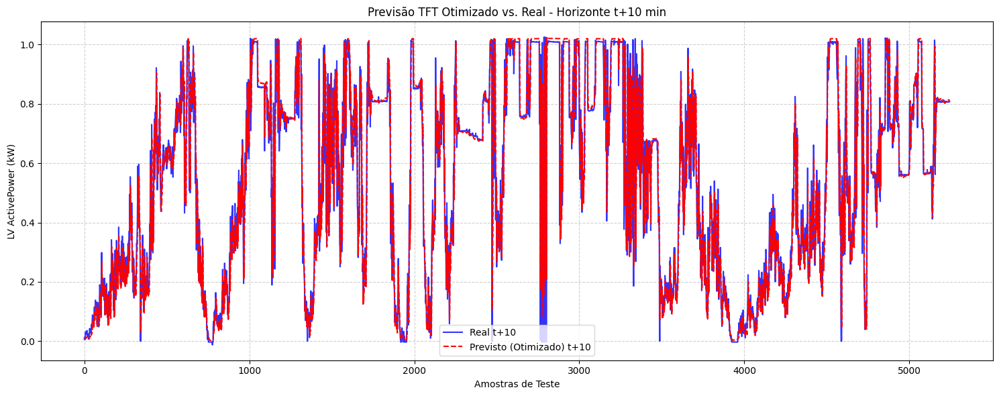

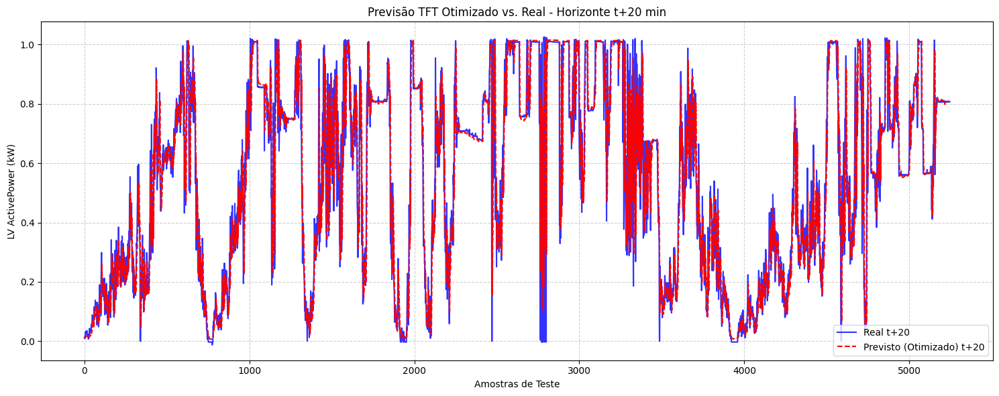

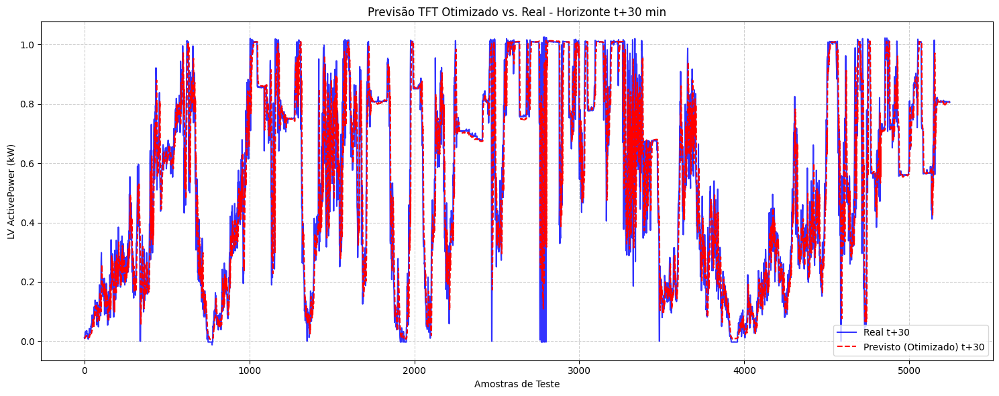

(<Functional name=functional, built=True>,
 {'hidden_units': 128,
  'dropout_rate': 0.28961796649204674,
  'num_heads': 4,
  'learning_rate': 0.0007802553471258404,
  'batch_size': 32},
   Horizonte  MAPE (%)  RMSE (MW)  MAE (MW)        R²
 0  t+10 min  4.711401   0.083536  0.048509  0.930999
 1  t+20 min  6.240401   0.112204  0.064251  0.875458
 2  t+30 min  7.158020   0.125788  0.073699  0.843409)

In [25]:
tft_model_with_optuna(new_data,i,look_back,data_partition,cap)

--- PREPARANDO DADOS PARA OTIMIZAÇÃO E TREINO DO CEEMDAN-EWT-TFT ---


[I 2025-10-27 18:05:24,243] A new study created in memory with name: no-name-b4f2bac5-efb4-41a4-9741-f249e943d4af


Dados preparados: 21006 amostras de treino, 5246 amostras de teste.

--- INICIANDO BUSCA DE HIPERPARÂMETROS PARA CEEMDAN-EWT-TFT COM OPTUNA ---


  0%|          | 0/60 [00:00<?, ?it/s]

I0000 00:00:1761588324.907933    4005 gpu_device.cc:2019] Created device /job:localhost/replica:0/task:0/device:GPU:0 with 43629 MB memory:  -> device: 0, name: NVIDIA L40S, pci bus id: 0000:34:00.0, compute capability: 8.9
/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/layer.py:421: UserWarning: `build()` was called on layer 'gated_residual_network_1', however the layer does not have a `build()` method implemented and it looks like it has unbuilt state. This will cause the layer to be marked as built, despite not being actually built, which may cause failures down the line. Make sure to implement a proper `build()` method.
  warnings.warn(
/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/layer.py:421: UserWarning: `build()` was called on layer 'gated_residual_network_2', however the layer does not have a `build()` method implemented and it looks like it has unbuilt state. This will cause the layer to be marked as 

[I 2025-10-27 18:10:17,496] Trial 0 finished with value: 7.590487199719131 and parameters: {'hidden_units': 32, 'dropout_rate': 0.2667139827092817, 'num_heads': 4, 'learning_rate': 0.0007232226588719274, 'batch_size': 32}. Best is trial 0 with value: 7.590487199719131.


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/layer.py:421: UserWarning: `build()` was called on layer 'gated_residual_network_1', however the layer does not have a `build()` method implemented and it looks like it has unbuilt state. This will cause the layer to be marked as built, despite not being actually built, which may cause failures down the line. Make sure to implement a proper `build()` method.
  warnings.warn(
/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/layer.py:421: UserWarning: `build()` was called on layer 'gated_residual_network_2', however the layer does not have a `build()` method implemented and it looks like it has unbuilt state. This will cause the layer to be marked as built, despite not being actually built, which may cause failures down the line. Make sure to implement a proper `build()` method.
  warnings.warn(
/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src

[I 2025-10-27 18:12:14,980] Trial 1 finished with value: 27.96471082569137 and parameters: {'hidden_units': 32, 'dropout_rate': 0.2944950166208571, 'num_heads': 4, 'learning_rate': 0.009034377820220627, 'batch_size': 32}. Best is trial 0 with value: 7.590487199719131.


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/layer.py:421: UserWarning: `build()` was called on layer 'gated_residual_network_1', however the layer does not have a `build()` method implemented and it looks like it has unbuilt state. This will cause the layer to be marked as built, despite not being actually built, which may cause failures down the line. Make sure to implement a proper `build()` method.
  warnings.warn(
/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/layer.py:421: UserWarning: `build()` was called on layer 'gated_residual_network_2', however the layer does not have a `build()` method implemented and it looks like it has unbuilt state. This will cause the layer to be marked as built, despite not being actually built, which may cause failures down the line. Make sure to implement a proper `build()` method.
  warnings.warn(
2025-10-27 18:12:19.887193: I external/local_xla/xla/stream_executor/cuda/su

[I 2025-10-27 18:14:00,501] Trial 2 finished with value: 11.154229118746045 and parameters: {'hidden_units': 32, 'dropout_rate': 0.3444376932165494, 'num_heads': 8, 'learning_rate': 0.00043080526982037295, 'batch_size': 64}. Best is trial 0 with value: 7.590487199719131.


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/layer.py:421: UserWarning: `build()` was called on layer 'gated_residual_network_1', however the layer does not have a `build()` method implemented and it looks like it has unbuilt state. This will cause the layer to be marked as built, despite not being actually built, which may cause failures down the line. Make sure to implement a proper `build()` method.
  warnings.warn(
/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/layer.py:421: UserWarning: `build()` was called on layer 'gated_residual_network_2', however the layer does not have a `build()` method implemented and it looks like it has unbuilt state. This will cause the layer to be marked as built, despite not being actually built, which may cause failures down the line. Make sure to implement a proper `build()` method.
  warnings.warn(
2025-10-27 18:14:06.037150: I external/local_xla/xla/stream_executor/cuda/su

[I 2025-10-27 18:15:57,547] Trial 3 finished with value: 27.32407923850572 and parameters: {'hidden_units': 128, 'dropout_rate': 0.19214045710578112, 'num_heads': 2, 'learning_rate': 0.006250714099408118, 'batch_size': 64}. Best is trial 0 with value: 7.590487199719131.


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/layer.py:421: UserWarning: `build()` was called on layer 'gated_residual_network_1', however the layer does not have a `build()` method implemented and it looks like it has unbuilt state. This will cause the layer to be marked as built, despite not being actually built, which may cause failures down the line. Make sure to implement a proper `build()` method.
  warnings.warn(
/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/layer.py:421: UserWarning: `build()` was called on layer 'gated_residual_network_2', however the layer does not have a `build()` method implemented and it looks like it has unbuilt state. This will cause the layer to be marked as built, despite not being actually built, which may cause failures down the line. Make sure to implement a proper `build()` method.
  warnings.warn(
2025-10-27 18:16:02.384482: I external/local_xla/xla/stream_executor/cuda/su

[I 2025-10-27 18:20:52,734] Trial 4 finished with value: 8.379708305888025 and parameters: {'hidden_units': 32, 'dropout_rate': 0.29482711046087495, 'num_heads': 2, 'learning_rate': 0.00036948373782937007, 'batch_size': 32}. Best is trial 0 with value: 7.590487199719131.


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/layer.py:421: UserWarning: `build()` was called on layer 'gated_residual_network_1', however the layer does not have a `build()` method implemented and it looks like it has unbuilt state. This will cause the layer to be marked as built, despite not being actually built, which may cause failures down the line. Make sure to implement a proper `build()` method.
  warnings.warn(
/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/layer.py:421: UserWarning: `build()` was called on layer 'gated_residual_network_2', however the layer does not have a `build()` method implemented and it looks like it has unbuilt state. This will cause the layer to be marked as built, despite not being actually built, which may cause failures down the line. Make sure to implement a proper `build()` method.
  warnings.warn(
/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src

[I 2025-10-27 18:22:50,705] Trial 5 finished with value: 14.334481882777657 and parameters: {'hidden_units': 32, 'dropout_rate': 0.34631181832491087, 'num_heads': 2, 'learning_rate': 0.005164262806592324, 'batch_size': 32}. Best is trial 0 with value: 7.590487199719131.


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/layer.py:421: UserWarning: `build()` was called on layer 'gated_residual_network_1', however the layer does not have a `build()` method implemented and it looks like it has unbuilt state. This will cause the layer to be marked as built, despite not being actually built, which may cause failures down the line. Make sure to implement a proper `build()` method.
  warnings.warn(
/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/layer.py:421: UserWarning: `build()` was called on layer 'gated_residual_network_2', however the layer does not have a `build()` method implemented and it looks like it has unbuilt state. This will cause the layer to be marked as built, despite not being actually built, which may cause failures down the line. Make sure to implement a proper `build()` method.
  warnings.warn(
2025-10-27 18:22:56.535716: I external/local_xla/xla/stream_executor/cuda/su

[I 2025-10-27 18:25:08,357] Trial 6 finished with value: 10.15299744711178 and parameters: {'hidden_units': 64, 'dropout_rate': 0.20577794985575204, 'num_heads': 2, 'learning_rate': 0.0002654514429703667, 'batch_size': 32}. Best is trial 0 with value: 7.590487199719131.


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/layer.py:421: UserWarning: `build()` was called on layer 'gated_residual_network_1', however the layer does not have a `build()` method implemented and it looks like it has unbuilt state. This will cause the layer to be marked as built, despite not being actually built, which may cause failures down the line. Make sure to implement a proper `build()` method.
  warnings.warn(
/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/layer.py:421: UserWarning: `build()` was called on layer 'gated_residual_network_2', however the layer does not have a `build()` method implemented and it looks like it has unbuilt state. This will cause the layer to be marked as built, despite not being actually built, which may cause failures down the line. Make sure to implement a proper `build()` method.
  warnings.warn(
/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src

[I 2025-10-27 18:27:13,169] Trial 7 finished with value: 8.809678657388455 and parameters: {'hidden_units': 32, 'dropout_rate': 0.3114576311836066, 'num_heads': 8, 'learning_rate': 0.0008777255376235497, 'batch_size': 64}. Best is trial 0 with value: 7.590487199719131.


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/layer.py:421: UserWarning: `build()` was called on layer 'gated_residual_network_1', however the layer does not have a `build()` method implemented and it looks like it has unbuilt state. This will cause the layer to be marked as built, despite not being actually built, which may cause failures down the line. Make sure to implement a proper `build()` method.
  warnings.warn(
/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/layer.py:421: UserWarning: `build()` was called on layer 'gated_residual_network_2', however the layer does not have a `build()` method implemented and it looks like it has unbuilt state. This will cause the layer to be marked as built, despite not being actually built, which may cause failures down the line. Make sure to implement a proper `build()` method.
  warnings.warn(
/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src

[I 2025-10-27 18:29:30,440] Trial 8 finished with value: 15.056286277992696 and parameters: {'hidden_units': 32, 'dropout_rate': 0.3321672184476105, 'num_heads': 8, 'learning_rate': 0.0034297767342487966, 'batch_size': 32}. Best is trial 0 with value: 7.590487199719131.


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/layer.py:421: UserWarning: `build()` was called on layer 'gated_residual_network_1', however the layer does not have a `build()` method implemented and it looks like it has unbuilt state. This will cause the layer to be marked as built, despite not being actually built, which may cause failures down the line. Make sure to implement a proper `build()` method.
  warnings.warn(
/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/layer.py:421: UserWarning: `build()` was called on layer 'gated_residual_network_2', however the layer does not have a `build()` method implemented and it looks like it has unbuilt state. This will cause the layer to be marked as built, despite not being actually built, which may cause failures down the line. Make sure to implement a proper `build()` method.
  warnings.warn(
/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src

[I 2025-10-27 18:33:51,595] Trial 9 finished with value: 10.775803158740251 and parameters: {'hidden_units': 32, 'dropout_rate': 0.23682317877211703, 'num_heads': 8, 'learning_rate': 0.00025633927989281093, 'batch_size': 32}. Best is trial 0 with value: 7.590487199719131.


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/layer.py:421: UserWarning: `build()` was called on layer 'gated_residual_network_1', however the layer does not have a `build()` method implemented and it looks like it has unbuilt state. This will cause the layer to be marked as built, despite not being actually built, which may cause failures down the line. Make sure to implement a proper `build()` method.
  warnings.warn(
/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/layer.py:421: UserWarning: `build()` was called on layer 'gated_residual_network_2', however the layer does not have a `build()` method implemented and it looks like it has unbuilt state. This will cause the layer to be marked as built, despite not being actually built, which may cause failures down the line. Make sure to implement a proper `build()` method.
  warnings.warn(
2025-10-27 18:33:56.698525: I external/local_xla/xla/stream_executor/cuda/su

[I 2025-10-27 18:36:14,294] Trial 10 finished with value: 7.971959527708974 and parameters: {'hidden_units': 64, 'dropout_rate': 0.11537414313386701, 'num_heads': 4, 'learning_rate': 0.0017001941387067656, 'batch_size': 64}. Best is trial 0 with value: 7.590487199719131.


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/layer.py:421: UserWarning: `build()` was called on layer 'gated_residual_network_1', however the layer does not have a `build()` method implemented and it looks like it has unbuilt state. This will cause the layer to be marked as built, despite not being actually built, which may cause failures down the line. Make sure to implement a proper `build()` method.
  warnings.warn(
/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/layer.py:421: UserWarning: `build()` was called on layer 'gated_residual_network_2', however the layer does not have a `build()` method implemented and it looks like it has unbuilt state. This will cause the layer to be marked as built, despite not being actually built, which may cause failures down the line. Make sure to implement a proper `build()` method.
  warnings.warn(
/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src

[I 2025-10-27 18:38:41,898] Trial 11 finished with value: 7.983693795643042 and parameters: {'hidden_units': 64, 'dropout_rate': 0.1003824821421904, 'num_heads': 4, 'learning_rate': 0.0012294800724141869, 'batch_size': 64}. Best is trial 0 with value: 7.590487199719131.


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/layer.py:421: UserWarning: `build()` was called on layer 'gated_residual_network_1', however the layer does not have a `build()` method implemented and it looks like it has unbuilt state. This will cause the layer to be marked as built, despite not being actually built, which may cause failures down the line. Make sure to implement a proper `build()` method.
  warnings.warn(
/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/layer.py:421: UserWarning: `build()` was called on layer 'gated_residual_network_2', however the layer does not have a `build()` method implemented and it looks like it has unbuilt state. This will cause the layer to be marked as built, despite not being actually built, which may cause failures down the line. Make sure to implement a proper `build()` method.
  warnings.warn(
/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src

[I 2025-10-27 18:40:54,226] Trial 12 finished with value: 9.414078037419799 and parameters: {'hidden_units': 64, 'dropout_rate': 0.1010561403109168, 'num_heads': 4, 'learning_rate': 0.0017942595049962548, 'batch_size': 64}. Best is trial 0 with value: 7.590487199719131.


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/layer.py:421: UserWarning: `build()` was called on layer 'gated_residual_network_1', however the layer does not have a `build()` method implemented and it looks like it has unbuilt state. This will cause the layer to be marked as built, despite not being actually built, which may cause failures down the line. Make sure to implement a proper `build()` method.
  warnings.warn(
/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/layer.py:421: UserWarning: `build()` was called on layer 'gated_residual_network_2', however the layer does not have a `build()` method implemented and it looks like it has unbuilt state. This will cause the layer to be marked as built, despite not being actually built, which may cause failures down the line. Make sure to implement a proper `build()` method.
  warnings.warn(
2025-10-27 18:40:59.522647: I external/local_xla/xla/stream_executor/cuda/su

[I 2025-10-27 18:43:59,799] Trial 13 finished with value: 7.959681835391506 and parameters: {'hidden_units': 128, 'dropout_rate': 0.16732586802137506, 'num_heads': 4, 'learning_rate': 0.0006854718728589906, 'batch_size': 64}. Best is trial 0 with value: 7.590487199719131.


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/layer.py:421: UserWarning: `build()` was called on layer 'gated_residual_network_1', however the layer does not have a `build()` method implemented and it looks like it has unbuilt state. This will cause the layer to be marked as built, despite not being actually built, which may cause failures down the line. Make sure to implement a proper `build()` method.
  warnings.warn(
/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/layer.py:421: UserWarning: `build()` was called on layer 'gated_residual_network_2', however the layer does not have a `build()` method implemented and it looks like it has unbuilt state. This will cause the layer to be marked as built, despite not being actually built, which may cause failures down the line. Make sure to implement a proper `build()` method.
  warnings.warn(
2025-10-27 18:44:05.285145: I external/local_xla/xla/stream_executor/cuda/su

[I 2025-10-27 18:46:21,350] Trial 14 finished with value: 12.034209955984819 and parameters: {'hidden_units': 128, 'dropout_rate': 0.16140725028008487, 'num_heads': 4, 'learning_rate': 0.00010125292887097562, 'batch_size': 32}. Best is trial 0 with value: 7.590487199719131.


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/layer.py:421: UserWarning: `build()` was called on layer 'gated_residual_network_1', however the layer does not have a `build()` method implemented and it looks like it has unbuilt state. This will cause the layer to be marked as built, despite not being actually built, which may cause failures down the line. Make sure to implement a proper `build()` method.
  warnings.warn(
/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/layer.py:421: UserWarning: `build()` was called on layer 'gated_residual_network_2', however the layer does not have a `build()` method implemented and it looks like it has unbuilt state. This will cause the layer to be marked as built, despite not being actually built, which may cause failures down the line. Make sure to implement a proper `build()` method.
  warnings.warn(
2025-10-27 18:46:29.957928: I external/local_xla/xla/stream_executor/cuda/su

[I 2025-10-27 18:49:01,910] Trial 15 finished with value: 9.11481212295619 and parameters: {'hidden_units': 128, 'dropout_rate': 0.2525648007732233, 'num_heads': 4, 'learning_rate': 0.0007032118929083835, 'batch_size': 64}. Best is trial 0 with value: 7.590487199719131.


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/layer.py:421: UserWarning: `build()` was called on layer 'gated_residual_network_1', however the layer does not have a `build()` method implemented and it looks like it has unbuilt state. This will cause the layer to be marked as built, despite not being actually built, which may cause failures down the line. Make sure to implement a proper `build()` method.
  warnings.warn(
/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/layer.py:421: UserWarning: `build()` was called on layer 'gated_residual_network_2', however the layer does not have a `build()` method implemented and it looks like it has unbuilt state. This will cause the layer to be marked as built, despite not being actually built, which may cause failures down the line. Make sure to implement a proper `build()` method.
  warnings.warn(
/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src

[I 2025-10-27 18:51:26,395] Trial 16 finished with value: 12.34601681949423 and parameters: {'hidden_units': 128, 'dropout_rate': 0.3992672975716496, 'num_heads': 4, 'learning_rate': 0.0001251303997399623, 'batch_size': 32}. Best is trial 0 with value: 7.590487199719131.


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/layer.py:421: UserWarning: `build()` was called on layer 'gated_residual_network_1', however the layer does not have a `build()` method implemented and it looks like it has unbuilt state. This will cause the layer to be marked as built, despite not being actually built, which may cause failures down the line. Make sure to implement a proper `build()` method.
  warnings.warn(
/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/layer.py:421: UserWarning: `build()` was called on layer 'gated_residual_network_2', however the layer does not have a `build()` method implemented and it looks like it has unbuilt state. This will cause the layer to be marked as built, despite not being actually built, which may cause failures down the line. Make sure to implement a proper `build()` method.
  warnings.warn(
2025-10-27 18:51:34.961963: I external/local_xla/xla/stream_executor/cuda/su

[I 2025-10-27 18:55:27,917] Trial 17 finished with value: 8.577067846163525 and parameters: {'hidden_units': 128, 'dropout_rate': 0.1541883183657749, 'num_heads': 4, 'learning_rate': 0.0005982693064941097, 'batch_size': 64}. Best is trial 0 with value: 7.590487199719131.


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/layer.py:421: UserWarning: `build()` was called on layer 'gated_residual_network_1', however the layer does not have a `build()` method implemented and it looks like it has unbuilt state. This will cause the layer to be marked as built, despite not being actually built, which may cause failures down the line. Make sure to implement a proper `build()` method.
  warnings.warn(
/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/layer.py:421: UserWarning: `build()` was called on layer 'gated_residual_network_2', however the layer does not have a `build()` method implemented and it looks like it has unbuilt state. This will cause the layer to be marked as built, despite not being actually built, which may cause failures down the line. Make sure to implement a proper `build()` method.
  warnings.warn(
2025-10-27 18:55:36.567079: I external/local_xla/xla/stream_executor/cuda/su

[I 2025-10-27 18:57:17,713] Trial 18 finished with value: 17.8180754735266 and parameters: {'hidden_units': 128, 'dropout_rate': 0.243844279475478, 'num_heads': 4, 'learning_rate': 0.0025795264783494564, 'batch_size': 64}. Best is trial 0 with value: 7.590487199719131.


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/layer.py:421: UserWarning: `build()` was called on layer 'gated_residual_network_1', however the layer does not have a `build()` method implemented and it looks like it has unbuilt state. This will cause the layer to be marked as built, despite not being actually built, which may cause failures down the line. Make sure to implement a proper `build()` method.
  warnings.warn(
/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/layer.py:421: UserWarning: `build()` was called on layer 'gated_residual_network_2', however the layer does not have a `build()` method implemented and it looks like it has unbuilt state. This will cause the layer to be marked as built, despite not being actually built, which may cause failures down the line. Make sure to implement a proper `build()` method.
  warnings.warn(
/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src

[I 2025-10-27 19:01:08,654] Trial 19 finished with value: 10.547232738813255 and parameters: {'hidden_units': 128, 'dropout_rate': 0.20054646835287462, 'num_heads': 4, 'learning_rate': 0.00019263114024650752, 'batch_size': 32}. Best is trial 0 with value: 7.590487199719131.


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/layer.py:421: UserWarning: `build()` was called on layer 'gated_residual_network_1', however the layer does not have a `build()` method implemented and it looks like it has unbuilt state. This will cause the layer to be marked as built, despite not being actually built, which may cause failures down the line. Make sure to implement a proper `build()` method.
  warnings.warn(
/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/layer.py:421: UserWarning: `build()` was called on layer 'gated_residual_network_2', however the layer does not have a `build()` method implemented and it looks like it has unbuilt state. This will cause the layer to be marked as built, despite not being actually built, which may cause failures down the line. Make sure to implement a proper `build()` method.
  warnings.warn(
/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src

[I 2025-10-27 19:05:00,475] Trial 20 finished with value: 15.418903168593607 and parameters: {'hidden_units': 128, 'dropout_rate': 0.158381800314029, 'num_heads': 4, 'learning_rate': 0.0012721096241591961, 'batch_size': 32}. Best is trial 0 with value: 7.590487199719131.


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/layer.py:421: UserWarning: `build()` was called on layer 'gated_residual_network_1', however the layer does not have a `build()` method implemented and it looks like it has unbuilt state. This will cause the layer to be marked as built, despite not being actually built, which may cause failures down the line. Make sure to implement a proper `build()` method.
  warnings.warn(
/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/layer.py:421: UserWarning: `build()` was called on layer 'gated_residual_network_2', however the layer does not have a `build()` method implemented and it looks like it has unbuilt state. This will cause the layer to be marked as built, despite not being actually built, which may cause failures down the line. Make sure to implement a proper `build()` method.
  warnings.warn(
/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src

[I 2025-10-27 19:07:03,289] Trial 21 finished with value: 9.103048586171848 and parameters: {'hidden_units': 64, 'dropout_rate': 0.13146621552695212, 'num_heads': 4, 'learning_rate': 0.0018537122802712994, 'batch_size': 64}. Best is trial 0 with value: 7.590487199719131.


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/layer.py:421: UserWarning: `build()` was called on layer 'gated_residual_network_1', however the layer does not have a `build()` method implemented and it looks like it has unbuilt state. This will cause the layer to be marked as built, despite not being actually built, which may cause failures down the line. Make sure to implement a proper `build()` method.
  warnings.warn(
/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/layer.py:421: UserWarning: `build()` was called on layer 'gated_residual_network_2', however the layer does not have a `build()` method implemented and it looks like it has unbuilt state. This will cause the layer to be marked as built, despite not being actually built, which may cause failures down the line. Make sure to implement a proper `build()` method.
  warnings.warn(
/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src

[I 2025-10-27 19:09:22,547] Trial 22 finished with value: 8.379226091800646 and parameters: {'hidden_units': 64, 'dropout_rate': 0.12865950001842047, 'num_heads': 4, 'learning_rate': 0.0006199021012331136, 'batch_size': 64}. Best is trial 0 with value: 7.590487199719131.


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/layer.py:421: UserWarning: `build()` was called on layer 'gated_residual_network_1', however the layer does not have a `build()` method implemented and it looks like it has unbuilt state. This will cause the layer to be marked as built, despite not being actually built, which may cause failures down the line. Make sure to implement a proper `build()` method.
  warnings.warn(
/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/layer.py:421: UserWarning: `build()` was called on layer 'gated_residual_network_2', however the layer does not have a `build()` method implemented and it looks like it has unbuilt state. This will cause the layer to be marked as built, despite not being actually built, which may cause failures down the line. Make sure to implement a proper `build()` method.
  warnings.warn(
/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src

[I 2025-10-27 19:11:23,400] Trial 23 finished with value: 10.578480924870112 and parameters: {'hidden_units': 64, 'dropout_rate': 0.27421376664677427, 'num_heads': 4, 'learning_rate': 0.0010971435503764444, 'batch_size': 64}. Best is trial 0 with value: 7.590487199719131.


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/layer.py:421: UserWarning: `build()` was called on layer 'gated_residual_network_1', however the layer does not have a `build()` method implemented and it looks like it has unbuilt state. This will cause the layer to be marked as built, despite not being actually built, which may cause failures down the line. Make sure to implement a proper `build()` method.
  warnings.warn(
/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/layer.py:421: UserWarning: `build()` was called on layer 'gated_residual_network_2', however the layer does not have a `build()` method implemented and it looks like it has unbuilt state. This will cause the layer to be marked as built, despite not being actually built, which may cause failures down the line. Make sure to implement a proper `build()` method.
  warnings.warn(
/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src

[I 2025-10-27 19:14:25,365] Trial 24 finished with value: 8.557033742992223 and parameters: {'hidden_units': 64, 'dropout_rate': 0.2225306124762758, 'num_heads': 4, 'learning_rate': 0.0021705844036279892, 'batch_size': 64}. Best is trial 0 with value: 7.590487199719131.


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/layer.py:421: UserWarning: `build()` was called on layer 'gated_residual_network_1', however the layer does not have a `build()` method implemented and it looks like it has unbuilt state. This will cause the layer to be marked as built, despite not being actually built, which may cause failures down the line. Make sure to implement a proper `build()` method.
  warnings.warn(
/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/layer.py:421: UserWarning: `build()` was called on layer 'gated_residual_network_2', however the layer does not have a `build()` method implemented and it looks like it has unbuilt state. This will cause the layer to be marked as built, despite not being actually built, which may cause failures down the line. Make sure to implement a proper `build()` method.
  warnings.warn(
/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src

[I 2025-10-27 19:16:23,349] Trial 25 finished with value: 9.374489670149709 and parameters: {'hidden_units': 64, 'dropout_rate': 0.1787241563496606, 'num_heads': 4, 'learning_rate': 0.0004618762165587719, 'batch_size': 64}. Best is trial 0 with value: 7.590487199719131.


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/layer.py:421: UserWarning: `build()` was called on layer 'gated_residual_network_1', however the layer does not have a `build()` method implemented and it looks like it has unbuilt state. This will cause the layer to be marked as built, despite not being actually built, which may cause failures down the line. Make sure to implement a proper `build()` method.
  warnings.warn(
/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/layer.py:421: UserWarning: `build()` was called on layer 'gated_residual_network_2', however the layer does not have a `build()` method implemented and it looks like it has unbuilt state. This will cause the layer to be marked as built, despite not being actually built, which may cause failures down the line. Make sure to implement a proper `build()` method.
  warnings.warn(
2025-10-27 19:16:28.488441: I external/local_xla/xla/stream_executor/cuda/su

[I 2025-10-27 19:18:19,890] Trial 26 finished with value: 8.337305705865356 and parameters: {'hidden_units': 32, 'dropout_rate': 0.12706568865807424, 'num_heads': 4, 'learning_rate': 0.0008641667536839207, 'batch_size': 64}. Best is trial 0 with value: 7.590487199719131.


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/layer.py:421: UserWarning: `build()` was called on layer 'gated_residual_network_1', however the layer does not have a `build()` method implemented and it looks like it has unbuilt state. This will cause the layer to be marked as built, despite not being actually built, which may cause failures down the line. Make sure to implement a proper `build()` method.
  warnings.warn(
/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/layer.py:421: UserWarning: `build()` was called on layer 'gated_residual_network_2', however the layer does not have a `build()` method implemented and it looks like it has unbuilt state. This will cause the layer to be marked as built, despite not being actually built, which may cause failures down the line. Make sure to implement a proper `build()` method.
  warnings.warn(
2025-10-27 19:18:28.495008: I external/local_xla/xla/stream_executor/cuda/su

[I 2025-10-27 19:20:17,426] Trial 27 finished with value: 21.49045337839796 and parameters: {'hidden_units': 128, 'dropout_rate': 0.26616183944894506, 'num_heads': 4, 'learning_rate': 0.003612644344564477, 'batch_size': 64}. Best is trial 0 with value: 7.590487199719131.


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/layer.py:421: UserWarning: `build()` was called on layer 'gated_residual_network_1', however the layer does not have a `build()` method implemented and it looks like it has unbuilt state. This will cause the layer to be marked as built, despite not being actually built, which may cause failures down the line. Make sure to implement a proper `build()` method.
  warnings.warn(
/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/layer.py:421: UserWarning: `build()` was called on layer 'gated_residual_network_2', however the layer does not have a `build()` method implemented and it looks like it has unbuilt state. This will cause the layer to be marked as built, despite not being actually built, which may cause failures down the line. Make sure to implement a proper `build()` method.
  warnings.warn(
/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src

[I 2025-10-27 19:23:40,928] Trial 28 finished with value: 8.551734930656155 and parameters: {'hidden_units': 32, 'dropout_rate': 0.13794443517049187, 'num_heads': 2, 'learning_rate': 0.001687449894955734, 'batch_size': 32}. Best is trial 0 with value: 7.590487199719131.


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/layer.py:421: UserWarning: `build()` was called on layer 'gated_residual_network_1', however the layer does not have a `build()` method implemented and it looks like it has unbuilt state. This will cause the layer to be marked as built, despite not being actually built, which may cause failures down the line. Make sure to implement a proper `build()` method.
  warnings.warn(
/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/layer.py:421: UserWarning: `build()` was called on layer 'gated_residual_network_2', however the layer does not have a `build()` method implemented and it looks like it has unbuilt state. This will cause the layer to be marked as built, despite not being actually built, which may cause failures down the line. Make sure to implement a proper `build()` method.
  warnings.warn(
2025-10-27 19:23:46.280680: I external/local_xla/xla/stream_executor/cuda/su

[I 2025-10-27 19:27:09,852] Trial 29 finished with value: 9.037385372603167 and parameters: {'hidden_units': 64, 'dropout_rate': 0.22115328305856558, 'num_heads': 8, 'learning_rate': 0.0013525976999041428, 'batch_size': 32}. Best is trial 0 with value: 7.590487199719131.


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/layer.py:421: UserWarning: `build()` was called on layer 'gated_residual_network_1', however the layer does not have a `build()` method implemented and it looks like it has unbuilt state. This will cause the layer to be marked as built, despite not being actually built, which may cause failures down the line. Make sure to implement a proper `build()` method.
  warnings.warn(
/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/layer.py:421: UserWarning: `build()` was called on layer 'gated_residual_network_2', however the layer does not have a `build()` method implemented and it looks like it has unbuilt state. This will cause the layer to be marked as built, despite not being actually built, which may cause failures down the line. Make sure to implement a proper `build()` method.
  warnings.warn(
/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src

[I 2025-10-27 19:29:44,061] Trial 30 finished with value: 8.601877975438715 and parameters: {'hidden_units': 32, 'dropout_rate': 0.17880979159373395, 'num_heads': 4, 'learning_rate': 0.002974192516296401, 'batch_size': 64}. Best is trial 0 with value: 7.590487199719131.


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/layer.py:421: UserWarning: `build()` was called on layer 'gated_residual_network_1', however the layer does not have a `build()` method implemented and it looks like it has unbuilt state. This will cause the layer to be marked as built, despite not being actually built, which may cause failures down the line. Make sure to implement a proper `build()` method.
  warnings.warn(
/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/layer.py:421: UserWarning: `build()` was called on layer 'gated_residual_network_2', however the layer does not have a `build()` method implemented and it looks like it has unbuilt state. This will cause the layer to be marked as built, despite not being actually built, which may cause failures down the line. Make sure to implement a proper `build()` method.
  warnings.warn(
/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src

[I 2025-10-27 19:32:11,790] Trial 31 finished with value: 7.726591184777717 and parameters: {'hidden_units': 64, 'dropout_rate': 0.11715708831808118, 'num_heads': 4, 'learning_rate': 0.0009417199923860075, 'batch_size': 64}. Best is trial 0 with value: 7.590487199719131.


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/layer.py:421: UserWarning: `build()` was called on layer 'gated_residual_network_1', however the layer does not have a `build()` method implemented and it looks like it has unbuilt state. This will cause the layer to be marked as built, despite not being actually built, which may cause failures down the line. Make sure to implement a proper `build()` method.
  warnings.warn(
/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/layer.py:421: UserWarning: `build()` was called on layer 'gated_residual_network_2', however the layer does not have a `build()` method implemented and it looks like it has unbuilt state. This will cause the layer to be marked as built, despite not being actually built, which may cause failures down the line. Make sure to implement a proper `build()` method.
  warnings.warn(
/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src

[I 2025-10-27 19:34:34,661] Trial 32 finished with value: 9.454435451377526 and parameters: {'hidden_units': 64, 'dropout_rate': 0.12260265080742361, 'num_heads': 4, 'learning_rate': 0.0007904843282428171, 'batch_size': 64}. Best is trial 0 with value: 7.590487199719131.


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/layer.py:421: UserWarning: `build()` was called on layer 'gated_residual_network_1', however the layer does not have a `build()` method implemented and it looks like it has unbuilt state. This will cause the layer to be marked as built, despite not being actually built, which may cause failures down the line. Make sure to implement a proper `build()` method.
  warnings.warn(
/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/layer.py:421: UserWarning: `build()` was called on layer 'gated_residual_network_2', however the layer does not have a `build()` method implemented and it looks like it has unbuilt state. This will cause the layer to be marked as built, despite not being actually built, which may cause failures down the line. Make sure to implement a proper `build()` method.
  warnings.warn(
/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src

[I 2025-10-27 19:36:52,506] Trial 33 finished with value: 9.853444495839527 and parameters: {'hidden_units': 64, 'dropout_rate': 0.11160151356890619, 'num_heads': 4, 'learning_rate': 0.00040168287741978895, 'batch_size': 64}. Best is trial 0 with value: 7.590487199719131.


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/layer.py:421: UserWarning: `build()` was called on layer 'gated_residual_network_1', however the layer does not have a `build()` method implemented and it looks like it has unbuilt state. This will cause the layer to be marked as built, despite not being actually built, which may cause failures down the line. Make sure to implement a proper `build()` method.
  warnings.warn(
/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/layer.py:421: UserWarning: `build()` was called on layer 'gated_residual_network_2', however the layer does not have a `build()` method implemented and it looks like it has unbuilt state. This will cause the layer to be marked as built, despite not being actually built, which may cause failures down the line. Make sure to implement a proper `build()` method.
  warnings.warn(
/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src

[I 2025-10-27 19:38:58,683] Trial 34 finished with value: 8.767285472599154 and parameters: {'hidden_units': 64, 'dropout_rate': 0.14536358656457776, 'num_heads': 4, 'learning_rate': 0.000532346911296353, 'batch_size': 64}. Best is trial 0 with value: 7.590487199719131.


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/layer.py:421: UserWarning: `build()` was called on layer 'gated_residual_network_1', however the layer does not have a `build()` method implemented and it looks like it has unbuilt state. This will cause the layer to be marked as built, despite not being actually built, which may cause failures down the line. Make sure to implement a proper `build()` method.
  warnings.warn(
/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/layer.py:421: UserWarning: `build()` was called on layer 'gated_residual_network_2', however the layer does not have a `build()` method implemented and it looks like it has unbuilt state. This will cause the layer to be marked as built, despite not being actually built, which may cause failures down the line. Make sure to implement a proper `build()` method.
  warnings.warn(
2025-10-27 19:39:03.706941: I external/local_xla/xla/stream_executor/cuda/su

[I 2025-10-27 19:40:47,500] Trial 35 finished with value: 12.609891511437981 and parameters: {'hidden_units': 32, 'dropout_rate': 0.17250046510817843, 'num_heads': 2, 'learning_rate': 0.00031298694758083776, 'batch_size': 64}. Best is trial 0 with value: 7.590487199719131.


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/layer.py:421: UserWarning: `build()` was called on layer 'gated_residual_network_1', however the layer does not have a `build()` method implemented and it looks like it has unbuilt state. This will cause the layer to be marked as built, despite not being actually built, which may cause failures down the line. Make sure to implement a proper `build()` method.
  warnings.warn(
/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/layer.py:421: UserWarning: `build()` was called on layer 'gated_residual_network_2', however the layer does not have a `build()` method implemented and it looks like it has unbuilt state. This will cause the layer to be marked as built, despite not being actually built, which may cause failures down the line. Make sure to implement a proper `build()` method.
  warnings.warn(
/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src

[I 2025-10-27 19:43:28,019] Trial 36 finished with value: 8.031765119784154 and parameters: {'hidden_units': 64, 'dropout_rate': 0.2985349327587441, 'num_heads': 4, 'learning_rate': 0.0015852206241673329, 'batch_size': 64}. Best is trial 0 with value: 7.590487199719131.


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/layer.py:421: UserWarning: `build()` was called on layer 'gated_residual_network_1', however the layer does not have a `build()` method implemented and it looks like it has unbuilt state. This will cause the layer to be marked as built, despite not being actually built, which may cause failures down the line. Make sure to implement a proper `build()` method.
  warnings.warn(
/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/layer.py:421: UserWarning: `build()` was called on layer 'gated_residual_network_2', however the layer does not have a `build()` method implemented and it looks like it has unbuilt state. This will cause the layer to be marked as built, despite not being actually built, which may cause failures down the line. Make sure to implement a proper `build()` method.
  warnings.warn(
/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src

[I 2025-10-27 19:46:18,537] Trial 37 finished with value: 28.585411281648447 and parameters: {'hidden_units': 32, 'dropout_rate': 0.11482614382842388, 'num_heads': 8, 'learning_rate': 0.008069242167608962, 'batch_size': 32}. Best is trial 0 with value: 7.590487199719131.


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/layer.py:421: UserWarning: `build()` was called on layer 'gated_residual_network_1', however the layer does not have a `build()` method implemented and it looks like it has unbuilt state. This will cause the layer to be marked as built, despite not being actually built, which may cause failures down the line. Make sure to implement a proper `build()` method.
  warnings.warn(
/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/layer.py:421: UserWarning: `build()` was called on layer 'gated_residual_network_2', however the layer does not have a `build()` method implemented and it looks like it has unbuilt state. This will cause the layer to be marked as built, despite not being actually built, which may cause failures down the line. Make sure to implement a proper `build()` method.
  warnings.warn(
2025-10-27 19:46:27.028967: I external/local_xla/xla/stream_executor/cuda/su

[I 2025-10-27 19:48:45,518] Trial 38 finished with value: 10.400603464872294 and parameters: {'hidden_units': 128, 'dropout_rate': 0.2125805291447671, 'num_heads': 2, 'learning_rate': 0.0009439970549877095, 'batch_size': 64}. Best is trial 0 with value: 7.590487199719131.


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/layer.py:421: UserWarning: `build()` was called on layer 'gated_residual_network_1', however the layer does not have a `build()` method implemented and it looks like it has unbuilt state. This will cause the layer to be marked as built, despite not being actually built, which may cause failures down the line. Make sure to implement a proper `build()` method.
  warnings.warn(
/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/layer.py:421: UserWarning: `build()` was called on layer 'gated_residual_network_2', however the layer does not have a `build()` method implemented and it looks like it has unbuilt state. This will cause the layer to be marked as built, despite not being actually built, which may cause failures down the line. Make sure to implement a proper `build()` method.
  warnings.warn(
/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src

[I 2025-10-27 19:52:34,763] Trial 39 finished with value: 7.67274413104585 and parameters: {'hidden_units': 32, 'dropout_rate': 0.2756299501059131, 'num_heads': 4, 'learning_rate': 0.00048250092961901286, 'batch_size': 32}. Best is trial 0 with value: 7.590487199719131.


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/layer.py:421: UserWarning: `build()` was called on layer 'gated_residual_network_1', however the layer does not have a `build()` method implemented and it looks like it has unbuilt state. This will cause the layer to be marked as built, despite not being actually built, which may cause failures down the line. Make sure to implement a proper `build()` method.
  warnings.warn(
/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/layer.py:421: UserWarning: `build()` was called on layer 'gated_residual_network_2', however the layer does not have a `build()` method implemented and it looks like it has unbuilt state. This will cause the layer to be marked as built, despite not being actually built, which may cause failures down the line. Make sure to implement a proper `build()` method.
  warnings.warn(
/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src

[I 2025-10-27 19:54:55,693] Trial 40 finished with value: 12.171660477298248 and parameters: {'hidden_units': 32, 'dropout_rate': 0.2761333447290083, 'num_heads': 8, 'learning_rate': 0.0003204632594453395, 'batch_size': 32}. Best is trial 0 with value: 7.590487199719131.


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/layer.py:421: UserWarning: `build()` was called on layer 'gated_residual_network_1', however the layer does not have a `build()` method implemented and it looks like it has unbuilt state. This will cause the layer to be marked as built, despite not being actually built, which may cause failures down the line. Make sure to implement a proper `build()` method.
  warnings.warn(
/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/layer.py:421: UserWarning: `build()` was called on layer 'gated_residual_network_2', however the layer does not have a `build()` method implemented and it looks like it has unbuilt state. This will cause the layer to be marked as built, despite not being actually built, which may cause failures down the line. Make sure to implement a proper `build()` method.
  warnings.warn(
/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src

[I 2025-10-27 20:00:11,706] Trial 41 finished with value: 6.7203518993045686 and parameters: {'hidden_units': 32, 'dropout_rate': 0.31361749266612915, 'num_heads': 4, 'learning_rate': 0.0005291352376938129, 'batch_size': 32}. Best is trial 41 with value: 6.7203518993045686.


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/layer.py:421: UserWarning: `build()` was called on layer 'gated_residual_network_1', however the layer does not have a `build()` method implemented and it looks like it has unbuilt state. This will cause the layer to be marked as built, despite not being actually built, which may cause failures down the line. Make sure to implement a proper `build()` method.
  warnings.warn(
/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/layer.py:421: UserWarning: `build()` was called on layer 'gated_residual_network_2', however the layer does not have a `build()` method implemented and it looks like it has unbuilt state. This will cause the layer to be marked as built, despite not being actually built, which may cause failures down the line. Make sure to implement a proper `build()` method.
  warnings.warn(
/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src

[I 2025-10-27 20:04:07,571] Trial 42 finished with value: 8.361238276278835 and parameters: {'hidden_units': 32, 'dropout_rate': 0.3311944252515864, 'num_heads': 4, 'learning_rate': 0.0004988369345828182, 'batch_size': 32}. Best is trial 41 with value: 6.7203518993045686.


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/layer.py:421: UserWarning: `build()` was called on layer 'gated_residual_network_1', however the layer does not have a `build()` method implemented and it looks like it has unbuilt state. This will cause the layer to be marked as built, despite not being actually built, which may cause failures down the line. Make sure to implement a proper `build()` method.
  warnings.warn(
/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/layer.py:421: UserWarning: `build()` was called on layer 'gated_residual_network_2', however the layer does not have a `build()` method implemented and it looks like it has unbuilt state. This will cause the layer to be marked as built, despite not being actually built, which may cause failures down the line. Make sure to implement a proper `build()` method.
  warnings.warn(
/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src

[I 2025-10-27 20:06:16,199] Trial 43 finished with value: 12.750877434878781 and parameters: {'hidden_units': 32, 'dropout_rate': 0.31122816304714407, 'num_heads': 4, 'learning_rate': 0.0002224090023346514, 'batch_size': 32}. Best is trial 41 with value: 6.7203518993045686.


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/layer.py:421: UserWarning: `build()` was called on layer 'gated_residual_network_1', however the layer does not have a `build()` method implemented and it looks like it has unbuilt state. This will cause the layer to be marked as built, despite not being actually built, which may cause failures down the line. Make sure to implement a proper `build()` method.
  warnings.warn(
/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/layer.py:421: UserWarning: `build()` was called on layer 'gated_residual_network_2', however the layer does not have a `build()` method implemented and it looks like it has unbuilt state. This will cause the layer to be marked as built, despite not being actually built, which may cause failures down the line. Make sure to implement a proper `build()` method.
  warnings.warn(
/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src

[I 2025-10-27 20:09:10,293] Trial 44 finished with value: 9.899881257368808 and parameters: {'hidden_units': 32, 'dropout_rate': 0.3492883020625686, 'num_heads': 4, 'learning_rate': 0.00038766334493315474, 'batch_size': 32}. Best is trial 41 with value: 6.7203518993045686.


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/layer.py:421: UserWarning: `build()` was called on layer 'gated_residual_network_1', however the layer does not have a `build()` method implemented and it looks like it has unbuilt state. This will cause the layer to be marked as built, despite not being actually built, which may cause failures down the line. Make sure to implement a proper `build()` method.
  warnings.warn(
/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/layer.py:421: UserWarning: `build()` was called on layer 'gated_residual_network_2', however the layer does not have a `build()` method implemented and it looks like it has unbuilt state. This will cause the layer to be marked as built, despite not being actually built, which may cause failures down the line. Make sure to implement a proper `build()` method.
  warnings.warn(
/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src

[I 2025-10-27 20:13:15,288] Trial 45 finished with value: 8.368097974602557 and parameters: {'hidden_units': 32, 'dropout_rate': 0.28801348046669956, 'num_heads': 2, 'learning_rate': 0.0007155141049148722, 'batch_size': 32}. Best is trial 41 with value: 6.7203518993045686.


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/layer.py:421: UserWarning: `build()` was called on layer 'gated_residual_network_1', however the layer does not have a `build()` method implemented and it looks like it has unbuilt state. This will cause the layer to be marked as built, despite not being actually built, which may cause failures down the line. Make sure to implement a proper `build()` method.
  warnings.warn(
/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/layer.py:421: UserWarning: `build()` was called on layer 'gated_residual_network_2', however the layer does not have a `build()` method implemented and it looks like it has unbuilt state. This will cause the layer to be marked as built, despite not being actually built, which may cause failures down the line. Make sure to implement a proper `build()` method.
  warnings.warn(
/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src

[I 2025-10-27 20:15:36,897] Trial 46 finished with value: 9.754705960144427 and parameters: {'hidden_units': 32, 'dropout_rate': 0.2569473992926884, 'num_heads': 4, 'learning_rate': 0.0010165297252779544, 'batch_size': 32}. Best is trial 41 with value: 6.7203518993045686.


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/layer.py:421: UserWarning: `build()` was called on layer 'gated_residual_network_1', however the layer does not have a `build()` method implemented and it looks like it has unbuilt state. This will cause the layer to be marked as built, despite not being actually built, which may cause failures down the line. Make sure to implement a proper `build()` method.
  warnings.warn(
/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/layer.py:421: UserWarning: `build()` was called on layer 'gated_residual_network_2', however the layer does not have a `build()` method implemented and it looks like it has unbuilt state. This will cause the layer to be marked as built, despite not being actually built, which may cause failures down the line. Make sure to implement a proper `build()` method.
  warnings.warn(
/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src

[I 2025-10-27 20:19:59,407] Trial 47 finished with value: 7.606027282754538 and parameters: {'hidden_units': 32, 'dropout_rate': 0.3639552938836108, 'num_heads': 4, 'learning_rate': 0.0005643645766498673, 'batch_size': 32}. Best is trial 41 with value: 6.7203518993045686.


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/layer.py:421: UserWarning: `build()` was called on layer 'gated_residual_network_1', however the layer does not have a `build()` method implemented and it looks like it has unbuilt state. This will cause the layer to be marked as built, despite not being actually built, which may cause failures down the line. Make sure to implement a proper `build()` method.
  warnings.warn(
/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/layer.py:421: UserWarning: `build()` was called on layer 'gated_residual_network_2', however the layer does not have a `build()` method implemented and it looks like it has unbuilt state. This will cause the layer to be marked as built, despite not being actually built, which may cause failures down the line. Make sure to implement a proper `build()` method.
  warnings.warn(
/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src

[I 2025-10-27 20:24:33,436] Trial 48 finished with value: 10.438691096156882 and parameters: {'hidden_units': 32, 'dropout_rate': 0.38873309670262124, 'num_heads': 8, 'learning_rate': 0.0005508200328583092, 'batch_size': 32}. Best is trial 41 with value: 6.7203518993045686.


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/layer.py:421: UserWarning: `build()` was called on layer 'gated_residual_network_1', however the layer does not have a `build()` method implemented and it looks like it has unbuilt state. This will cause the layer to be marked as built, despite not being actually built, which may cause failures down the line. Make sure to implement a proper `build()` method.
  warnings.warn(
/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/layer.py:421: UserWarning: `build()` was called on layer 'gated_residual_network_2', however the layer does not have a `build()` method implemented and it looks like it has unbuilt state. This will cause the layer to be marked as built, despite not being actually built, which may cause failures down the line. Make sure to implement a proper `build()` method.
  warnings.warn(
/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src

[I 2025-10-27 20:26:52,999] Trial 49 finished with value: 12.44420749264458 and parameters: {'hidden_units': 32, 'dropout_rate': 0.3670987995164064, 'num_heads': 4, 'learning_rate': 0.0001708818672582893, 'batch_size': 32}. Best is trial 41 with value: 6.7203518993045686.


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/layer.py:421: UserWarning: `build()` was called on layer 'gated_residual_network_1', however the layer does not have a `build()` method implemented and it looks like it has unbuilt state. This will cause the layer to be marked as built, despite not being actually built, which may cause failures down the line. Make sure to implement a proper `build()` method.
  warnings.warn(
/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/layer.py:421: UserWarning: `build()` was called on layer 'gated_residual_network_2', however the layer does not have a `build()` method implemented and it looks like it has unbuilt state. This will cause the layer to be marked as built, despite not being actually built, which may cause failures down the line. Make sure to implement a proper `build()` method.
  warnings.warn(
/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src

[I 2025-10-27 20:30:04,992] Trial 50 finished with value: 10.167859411719304 and parameters: {'hidden_units': 32, 'dropout_rate': 0.32824307319727114, 'num_heads': 4, 'learning_rate': 0.0003096344034929341, 'batch_size': 32}. Best is trial 41 with value: 6.7203518993045686.


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/layer.py:421: UserWarning: `build()` was called on layer 'gated_residual_network_1', however the layer does not have a `build()` method implemented and it looks like it has unbuilt state. This will cause the layer to be marked as built, despite not being actually built, which may cause failures down the line. Make sure to implement a proper `build()` method.
  warnings.warn(
/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/layer.py:421: UserWarning: `build()` was called on layer 'gated_residual_network_2', however the layer does not have a `build()` method implemented and it looks like it has unbuilt state. This will cause the layer to be marked as built, despite not being actually built, which may cause failures down the line. Make sure to implement a proper `build()` method.
  warnings.warn(
/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src

[I 2025-10-27 20:33:14,711] Trial 51 finished with value: 9.061114692992938 and parameters: {'hidden_units': 32, 'dropout_rate': 0.36066842061601145, 'num_heads': 4, 'learning_rate': 0.0006723194705201204, 'batch_size': 32}. Best is trial 41 with value: 6.7203518993045686.


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/layer.py:421: UserWarning: `build()` was called on layer 'gated_residual_network_1', however the layer does not have a `build()` method implemented and it looks like it has unbuilt state. This will cause the layer to be marked as built, despite not being actually built, which may cause failures down the line. Make sure to implement a proper `build()` method.
  warnings.warn(
/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/layer.py:421: UserWarning: `build()` was called on layer 'gated_residual_network_2', however the layer does not have a `build()` method implemented and it looks like it has unbuilt state. This will cause the layer to be marked as built, despite not being actually built, which may cause failures down the line. Make sure to implement a proper `build()` method.
  warnings.warn(
/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src

[I 2025-10-27 20:38:09,458] Trial 52 finished with value: 10.06781850998326 and parameters: {'hidden_units': 32, 'dropout_rate': 0.3056637950430101, 'num_heads': 4, 'learning_rate': 0.0004246082512516425, 'batch_size': 32}. Best is trial 41 with value: 6.7203518993045686.


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/layer.py:421: UserWarning: `build()` was called on layer 'gated_residual_network_1', however the layer does not have a `build()` method implemented and it looks like it has unbuilt state. This will cause the layer to be marked as built, despite not being actually built, which may cause failures down the line. Make sure to implement a proper `build()` method.
  warnings.warn(
/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/layer.py:421: UserWarning: `build()` was called on layer 'gated_residual_network_2', however the layer does not have a `build()` method implemented and it looks like it has unbuilt state. This will cause the layer to be marked as built, despite not being actually built, which may cause failures down the line. Make sure to implement a proper `build()` method.
  warnings.warn(
/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src

[I 2025-10-27 20:42:13,966] Trial 53 finished with value: 8.95033741046875 and parameters: {'hidden_units': 32, 'dropout_rate': 0.2847313896874284, 'num_heads': 4, 'learning_rate': 0.0007781027508969318, 'batch_size': 32}. Best is trial 41 with value: 6.7203518993045686.


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/layer.py:421: UserWarning: `build()` was called on layer 'gated_residual_network_1', however the layer does not have a `build()` method implemented and it looks like it has unbuilt state. This will cause the layer to be marked as built, despite not being actually built, which may cause failures down the line. Make sure to implement a proper `build()` method.
  warnings.warn(
/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/layer.py:421: UserWarning: `build()` was called on layer 'gated_residual_network_2', however the layer does not have a `build()` method implemented and it looks like it has unbuilt state. This will cause the layer to be marked as built, despite not being actually built, which may cause failures down the line. Make sure to implement a proper `build()` method.
  warnings.warn(
/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src

[I 2025-10-27 20:46:09,502] Trial 54 finished with value: 8.822260067250276 and parameters: {'hidden_units': 128, 'dropout_rate': 0.2400235763688019, 'num_heads': 4, 'learning_rate': 0.0005949870779418949, 'batch_size': 32}. Best is trial 41 with value: 6.7203518993045686.


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/layer.py:421: UserWarning: `build()` was called on layer 'gated_residual_network_1', however the layer does not have a `build()` method implemented and it looks like it has unbuilt state. This will cause the layer to be marked as built, despite not being actually built, which may cause failures down the line. Make sure to implement a proper `build()` method.
  warnings.warn(
/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/layer.py:421: UserWarning: `build()` was called on layer 'gated_residual_network_2', however the layer does not have a `build()` method implemented and it looks like it has unbuilt state. This will cause the layer to be marked as built, despite not being actually built, which may cause failures down the line. Make sure to implement a proper `build()` method.
  warnings.warn(
/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src

[I 2025-10-27 20:50:18,559] Trial 55 finished with value: 7.880953988428852 and parameters: {'hidden_units': 32, 'dropout_rate': 0.32052751206206015, 'num_heads': 4, 'learning_rate': 0.0010599483463903075, 'batch_size': 32}. Best is trial 41 with value: 6.7203518993045686.


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/layer.py:421: UserWarning: `build()` was called on layer 'gated_residual_network_1', however the layer does not have a `build()` method implemented and it looks like it has unbuilt state. This will cause the layer to be marked as built, despite not being actually built, which may cause failures down the line. Make sure to implement a proper `build()` method.
  warnings.warn(
/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/layer.py:421: UserWarning: `build()` was called on layer 'gated_residual_network_2', however the layer does not have a `build()` method implemented and it looks like it has unbuilt state. This will cause the layer to be marked as built, despite not being actually built, which may cause failures down the line. Make sure to implement a proper `build()` method.
  warnings.warn(
/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src

[I 2025-10-27 20:54:30,563] Trial 56 finished with value: 6.838961988673965 and parameters: {'hidden_units': 32, 'dropout_rate': 0.3192183105197889, 'num_heads': 4, 'learning_rate': 0.0011878130118675282, 'batch_size': 32}. Best is trial 41 with value: 6.7203518993045686.


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/layer.py:421: UserWarning: `build()` was called on layer 'gated_residual_network_1', however the layer does not have a `build()` method implemented and it looks like it has unbuilt state. This will cause the layer to be marked as built, despite not being actually built, which may cause failures down the line. Make sure to implement a proper `build()` method.
  warnings.warn(
/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/layer.py:421: UserWarning: `build()` was called on layer 'gated_residual_network_2', however the layer does not have a `build()` method implemented and it looks like it has unbuilt state. This will cause the layer to be marked as built, despite not being actually built, which may cause failures down the line. Make sure to implement a proper `build()` method.
  warnings.warn(
/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src

[I 2025-10-27 20:57:55,192] Trial 57 finished with value: 8.183988226860162 and parameters: {'hidden_units': 32, 'dropout_rate': 0.3422239891155114, 'num_heads': 4, 'learning_rate': 0.0014490123550932443, 'batch_size': 32}. Best is trial 41 with value: 6.7203518993045686.


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/layer.py:421: UserWarning: `build()` was called on layer 'gated_residual_network_1', however the layer does not have a `build()` method implemented and it looks like it has unbuilt state. This will cause the layer to be marked as built, despite not being actually built, which may cause failures down the line. Make sure to implement a proper `build()` method.
  warnings.warn(
/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/layer.py:421: UserWarning: `build()` was called on layer 'gated_residual_network_2', however the layer does not have a `build()` method implemented and it looks like it has unbuilt state. This will cause the layer to be marked as built, despite not being actually built, which may cause failures down the line. Make sure to implement a proper `build()` method.
  warnings.warn(
/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src

[I 2025-10-27 21:01:56,895] Trial 58 finished with value: 8.260934314303462 and parameters: {'hidden_units': 32, 'dropout_rate': 0.3683112393042665, 'num_heads': 4, 'learning_rate': 0.0011802734888842548, 'batch_size': 32}. Best is trial 41 with value: 6.7203518993045686.


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/layer.py:421: UserWarning: `build()` was called on layer 'gated_residual_network_1', however the layer does not have a `build()` method implemented and it looks like it has unbuilt state. This will cause the layer to be marked as built, despite not being actually built, which may cause failures down the line. Make sure to implement a proper `build()` method.
  warnings.warn(
/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/layer.py:421: UserWarning: `build()` was called on layer 'gated_residual_network_2', however the layer does not have a `build()` method implemented and it looks like it has unbuilt state. This will cause the layer to be marked as built, despite not being actually built, which may cause failures down the line. Make sure to implement a proper `build()` method.
  warnings.warn(
/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src

[I 2025-10-27 21:06:21,407] Trial 59 finished with value: 9.071469766900718 and parameters: {'hidden_units': 32, 'dropout_rate': 0.3177267111005602, 'num_heads': 4, 'learning_rate': 0.0004900427087255019, 'batch_size': 32}. Best is trial 41 with value: 6.7203518993045686.

OTIMIZAÇÃO DO CEEMDAN-EWT-TFT CONCLUÍDA
Melhor resultado (MAPE médio na validação): 6.7204%

Hiperparâmetros Ótimos Encontrados:
  - hidden_units: 32
  - dropout_rate: 0.31361749266612915
  - num_heads: 4
  - learning_rate: 0.0005291352376938129
  - batch_size: 32

--- TREINANDO MODELO CEEMDAN-EWT-TFT FINAL COM OS MELHORES PARÂMETROS ---


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/layer.py:421: UserWarning: `build()` was called on layer 'gated_residual_network_1', however the layer does not have a `build()` method implemented and it looks like it has unbuilt state. This will cause the layer to be marked as built, despite not being actually built, which may cause failures down the line. Make sure to implement a proper `build()` method.
  warnings.warn(
/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/layer.py:421: UserWarning: `build()` was called on layer 'gated_residual_network_2', however the layer does not have a `build()` method implemented and it looks like it has unbuilt state. This will cause the layer to be marked as built, despite not being actually built, which may cause failures down the line. Make sure to implement a proper `build()` method.
  warnings.warn(
2025-10-27 21:06:31.911579: I external/local_xla/xla/stream_executor/cuda/su

Epoch 53: early stopping
Restoring model weights from the end of the best epoch: 33.
Treinamento final concluído.


2025-10-27 21:07:51.384189: I external/local_xla/xla/stream_executor/cuda/subprocess_compilation.cc:346] ptxas warning : Registers are spilled to local memory in function 'gemm_fusion_dot_21', 8 bytes spill stores, 8 bytes spill loads

2025-10-27 21:07:51.767117: I external/local_xla/xla/stream_executor/cuda/subprocess_compilation.cc:346] ptxas warning : Registers are spilled to local memory in function 'gemm_fusion_dot_21', 8 bytes spill stores, 8 bytes spill loads

2025-10-27 21:07:51.908343: I external/local_xla/xla/stream_executor/cuda/subprocess_compilation.cc:346] ptxas warning : Registers are spilled to local memory in function 'gemm_fusion_dot_20', 8 bytes spill stores, 8 bytes spill loads

2025-10-27 21:07:52.140021: I external/local_xla/xla/stream_executor/cuda/subprocess_compilation.cc:346] ptxas warning : Registers are spilled to local memory in function 'gemm_fusion_dot_20', 8 bytes spill stores, 8 bytes spill loads

2025-10-27 21:07:52.155296: I external/local_xla/xla/str


===== MÉTRICAS FINAIS NO CONJUNTO DE TESTE =====
Horizonte t+10: MAPE=4.2062%, RMSE=0.0578, MAE=0.0433, R²=0.9669
Horizonte t+20: MAPE=4.4955%, RMSE=0.0640, MAE=0.0463, R²=0.9595
Horizonte t+30: MAPE=5.0364%, RMSE=0.0715, MAE=0.0519, R²=0.9494

--- GERANDO GRÁFICOS DE RESULTADOS ---


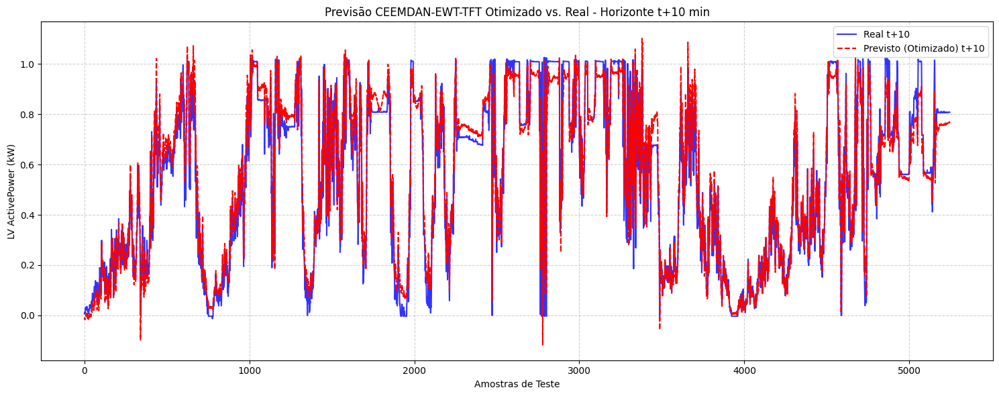

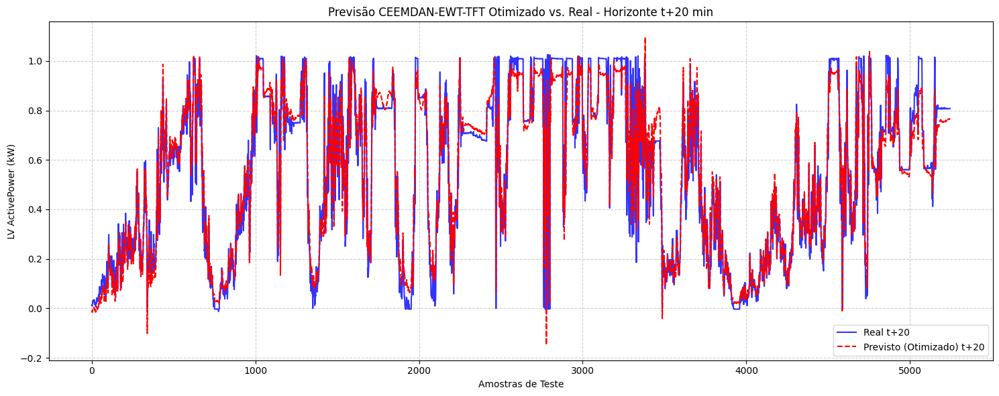

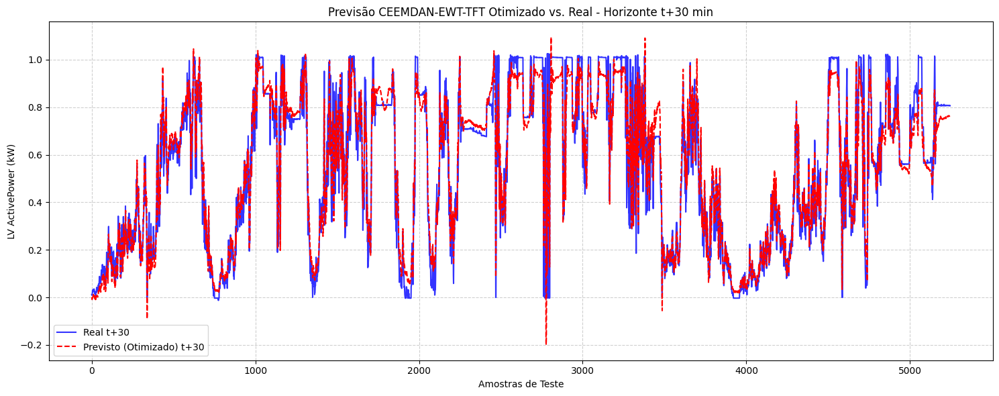

(<Functional name=functional, built=True>,
 {'hidden_units': 32,
  'dropout_rate': 0.31361749266612915,
  'num_heads': 4,
  'learning_rate': 0.0005291352376938129,
  'batch_size': 32},
   Horizonte  MAPE (%)  RMSE (MW)  MAE (MW)        R²
 0  t+10 min  4.206241   0.057841  0.043307  0.966919
 1  t+20 min  4.495531   0.063977  0.046286  0.959510
 2  t+30 min  5.036418   0.071518  0.051855  0.949381)

In [24]:
proposed_method_tft_aggregator_with_optuna(new_data,i,look_back,data_partition,cap)